# **ABCDEats Inc. - Exploratory Data Analysis**

# 1. Imports, Options and Ingestion

In [1]:
# Imports list
import math
import itertools

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker

from scipy.stats import ttest_ind, pearsonr, chi2_contingency
from statsmodels.stats.multitest import multipletests

In [2]:
# Style is important
sns.set(style="white")

# Ensuring pandas always prints all columns and rows
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_seq_items', None)
pd.set_option('display.max_colwidth', 1000)

%config InlineBackend.figure_format = 'retina'

In [3]:
# Reading the csv data

data = pd.read_csv('DM2425_ABCDEats_DATASET.csv')

# 2. Wrangling the Data 

## 2.1. Info()

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31888 entries, 0 to 31887
Data columns (total 56 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   customer_id               31888 non-null  object 
 1   customer_region           31888 non-null  object 
 2   customer_age              31161 non-null  float64
 3   vendor_count              31888 non-null  int64  
 4   product_count             31888 non-null  int64  
 5   is_chain                  31888 non-null  int64  
 6   first_order               31782 non-null  float64
 7   last_order                31888 non-null  int64  
 8   last_promo                31888 non-null  object 
 9   payment_method            31888 non-null  object 
 10  CUI_American              31888 non-null  float64
 11  CUI_Asian                 31888 non-null  float64
 12  CUI_Beverages             31888 non-null  float64
 13  CUI_Cafe                  31888 non-null  float64
 14  CUI_Ch

This dataset features has 31888 observations accross 56 variables, of which, 24 refer to hours of day, and 7 to days of week. Given the descriptions provided, we would expect all of these variables to take on integer values which is not the case. Moreover, missing values are present, specifically in 'HR_0', 'customer_age' and 'first_order'.

Additionally, 'customer_age' and 'first_order' should be integers, but are being shown in info() as floats, and the variable 'is_chain', which should be a boolean is, in fact, and integer.

In [5]:
data.tail()

,customer_id,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
31883,f4e366c281,8670,30.0,1,1,1,NaN,0,FREEBIE,DIGI,0.00,0.00,18.04,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
31884,f6b6709018,8670,NaN,1,1,0,NaN,0,DELIVERY,DIGI,18.04,0.00,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
31885,f74ad8ce3f,8670,24.0,1,1,1,NaN,0,-,DIGI,0.00,0.00,0.00,0.0,0.0,0.0,17.79,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,1,0.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
31886,f7b19c0241,8670,34.0,1,1,0,NaN,0,DISCOUNT,DIGI,0.00,12.03,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
31887,fd40d3b0e0,4660,30.0,1,1,0,NaN,0,-,CASH,0.00,0.00,0.00,0.0,0.0,0.0,0.00,0.0,0.0,7.91,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


Calling .tail() shows us that no aggregations are present at the bottom of the dataset, which is good. Moreover, the data itself is just as we expected from inspecting .info().

## 2.2 Renaming Variables

We rename some variables to an easier and shorter convention.

In [6]:
_rename_dict = {
        'customer_region' : 'cust_region'
        , 'payment_method' : 'pay_method'
        , 'customer_age' : 'cust_age'
        , 'vendor_count' : 'n_vendor'
        , 'product_count' : 'n_product'
        , 'n_order' : 'n_order'
        , 'is_chain' : 'n_chain'
        , 'CUI_American' : 'American'
        , 'CUI_Asian' : 'Asian'
        , 'CUI_Beverages' : 'Beverages'
        , 'CUI_Cafe' : 'Cafe'
        , 'CUI_Chicken Dishes' : 'Chicken Dishes'
        , 'CUI_Chinese' : 'Chinese'
        , 'CUI_Desserts' : 'Desserts'
        , 'CUI_Healthy' : 'Healthy'
        , 'CUI_Indian' : 'Indian'
        , 'CUI_Italian' : 'Italian'
        , 'CUI_Japanese' : 'Japanese'
        , 'CUI_Noodle Dishes' : 'Noodle Dishes'
        , 'CUI_OTHER' : 'OTHER'
        , 'CUI_Street Food / Snacks' : 'Street Food / Snacks'
        , 'CUI_Thai' : 'Thai'
}

# Rename the columns for easier reference
data.rename(columns=_rename_dict, inplace=True)

## 2.3 Investigating 'customer_id'

We plot the values of customer id, by manipulating the hex/int conversion.

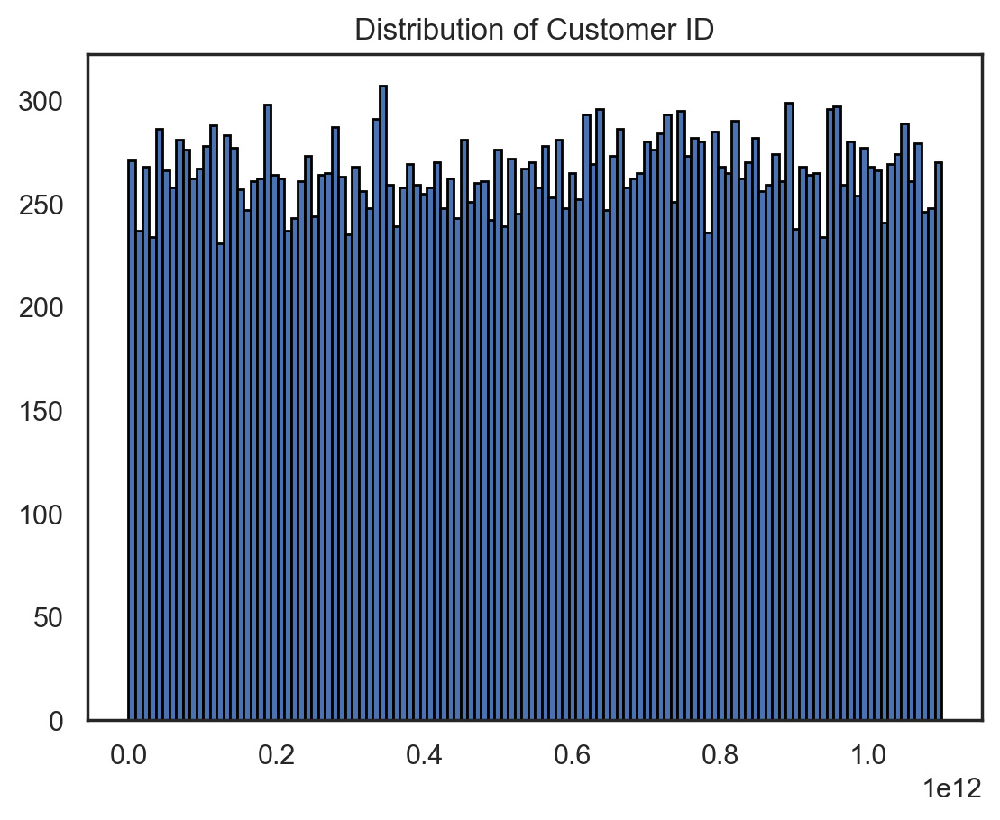

In [7]:
# Convert customer_id from hexadecimal to integer 
id_array = data['customer_id'].apply(lambda x: int(x, 16))

# And plot its histogram
plt.hist(id_array, bins=120, edgecolor='black')
plt.title('Distribution of Customer ID')
plt.show()

The conversion of the values of customer_id into integers, and the plot of their histogram shows us what is very likely to be a uniform distribution - this tells us that these values are indeed either random, or randomly sampled, or both. We will not perform any further investigation into this hypothesis, and will use the integer form of customer_id as index.

### Checking for Duplicate ID's

Before turning customer id into the index of the dataframe, we check if there are any repeated values, i.e., multiple entries for a customer.

In [8]:
# Keep false, shows does not drop the duplicated values which allows visual inspection
data[data['customer_id'].duplicated(keep=False)].head()

,customer_id,cust_region,cust_age,n_vendor,n_product,n_chain,first_order,last_order,last_promo,pay_method,American,Asian,Beverages,Cafe,Chicken Dishes,Chinese,Desserts,Healthy,Indian,Italian,Japanese,Noodle Dishes,OTHER,Street Food / Snacks,Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
3355,b55012ee1c,8550,23.0,4,11,1,2.0,89,FREEBIE,CARD,0.00,93.43,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,3,2,3,1,1,0,0,0.0,0,0,10,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3379,b55012ee1c,8550,23.0,4,11,1,2.0,89,FREEBIE,CARD,0.00,93.43,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,3,2,3,1,1,0,0,0.0,0,0,10,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7867,24251eb7da,8550,28.0,4,8,3,7.0,85,-,CARD,30.44,18.54,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,32.27,0.0,1,0,3,0,0,0,1,0.0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0
7887,24251eb7da,8550,28.0,4,8,3,7.0,85,-,CARD,30.44,18.54,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,32.27,0.0,1,0,3,0,0,0,1,0.0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0
16227,671bf0c738,8550,25.0,4,7,3,23.0,66,FREEBIE,CARD,56.18,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,30.53,0.0,0,1,1,1,0,1,0,0.0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0


Detected duplicate customer entries are removed.

In [9]:
# Make the integer value of the customer hex values, the index. 
data['customer_id'] = id_array

# Set 'customer_id' as the index
data = data[~data['customer_id'].duplicated()].set_index('customer_id')

A small functional choice, because we gain the ability to slice with integer indices, but we can always convert them back to their respective hexdecimal values for future work.

## 2.4 Data Consistency

### 2.4.1 Missing Values

We now highlight missing values, and analyze the consistency of data with data types and business logic.

In [10]:
data.isna().sum()

cust_region                0
cust_age                 727
n_vendor                   0
n_product                  0
n_chain                    0
first_order              106
last_order                 0
last_promo                 0
pay_method                 0
American                   0
Asian                      0
Beverages                  0
Cafe                       0
Chicken Dishes             0
Chinese                    0
Desserts                   0
Healthy                    0
Indian                     0
Italian                    0
Japanese                   0
Noodle Dishes              0
OTHER                      0
Street Food / Snacks       0
Thai                       0
DOW_0                      0
DOW_1                      0
DOW_2                      0
DOW_3                      0
DOW_4                      0
DOW_5                      0
DOW_6                      0
HR_0                    1164
HR_1                       0
HR_2                       0
HR_3          

#### First order

At first glance it might seem odd that there are missing values for 'first_order' that do not have a corresponding last_order, but in actuality this points to a very obvious fact, that these customers had made their first order before we had begun our data collection efforts.

Defined as:
- "Number of days from the start of the dataset when the customer first placed an order."

The soundest value to input is the minimum value possible i.e. 0.

In [11]:
data.loc[data['first_order'].isna(), 'first_order'] = 0

#### HR_0

"DOW_0 to DOW_6" encode -> Number of orders placed on each day of the week. (0 = Sunday, 6 = Saturday) <br>
"HR_0 to HR_23" encode -> Number of orders placed during each hour of the day. (0 = midnight, 23 = 11 PM)

Therefore, it is simply a matter of summing the DOW values, subtracting all of the HR values, and impute the result of the operation to the value of HR_0.

In [12]:
sum_week = data[[f"DOW_{n}" for n in range(7)]].sum(axis=1)
sum_day = data[[f"HR_{n}" for n in range(24)]].sum(axis=1)

data.loc[data['HR_0'].isna(), 'HR_0'] = (sum_week - sum_day)

#### Age

We start by plotting the histogram for Age, making note of a heavy skew of the data towards the lower values of its range.

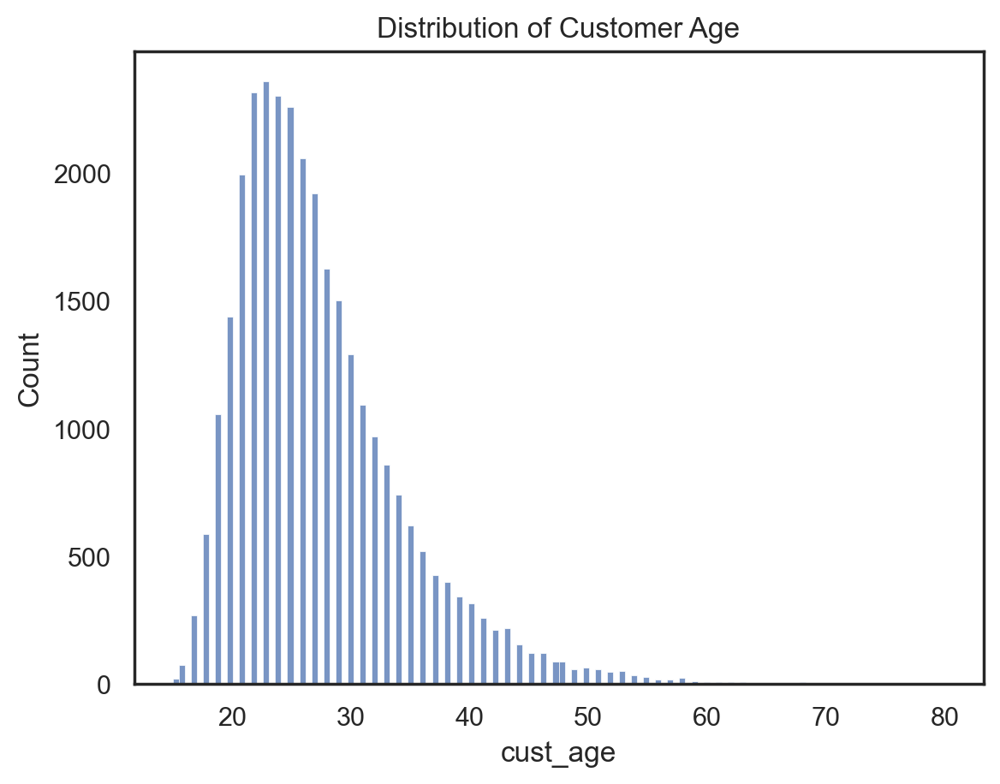

In [13]:
sns.histplot(data['cust_age'])
plt.title('Distribution of Customer Age')
plt.show()

Now we look at pairwise plots of age with other features.

In [14]:
# Specify the variable for which you want to plot against others
target_variable = 'cust_age'

# Create scatter plots
def scatter_plots(df, target_variable):
    
    # Get a list of all columns except the target variable
    other_variables = df.columns[df.columns != target_variable]

    n_cols = 3
    n_rows = math.ceil(len(df.columns) / n_cols)
    
    # Create scatter plots
    plt.figure(figsize=(18, 6 * n_rows))  # Adjust height based on number of rows
    for i, variable in enumerate(other_variables):
        plt.subplot(n_rows, n_cols, i + 1)  # Adjust the subplot layout
        sns.scatterplot(data=df, x=target_variable, y=variable)
        plt.title(f'Scatter plot of {target_variable} vs {variable}')
        plt.xlabel(target_variable)
        plt.ylabel(variable)
        
    plt.suptitle('Paired distributions of cust_age')
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()

# Call the function to create the plots
scatter_plots(data, target_variable)

The inspection of the plots above shows us that there seems to be some stochastic relation between some of these variables, and customer age. However, it is not something that we want to explore, or exploit just yet, so we will refrain from treating these missing values during this exploratory data analysis.

In [15]:
correlations = {}

_df = data.loc[~data['cust_age'].isna(),].copy(deep=True)

for _x in data.columns:
    try: 
        coef, p_value  = pearsonr(_df[_x], _df['cust_age'])
        correlations[_x] = {'coef' : coef, 'p_value' : p_value}
    except Exception as e: 
        pass
        
correlations

{'cust_age': {'coef': 0.9999999999999997, 'p_value': 0.0},
 'n_vendor': {'coef': 0.0009822266331064322, 'p_value': 0.8623808361097504},
 'n_product': {'coef': 0.005413171072432399, 'p_value': 0.33941176229394243},
 'n_chain': {'coef': 0.0017561180766213704, 'p_value': 0.7566206545139603},
 'first_order': {'coef': 0.003992600039073135, 'p_value': 0.48104652143397636},
 'last_order': {'coef': 0.012718784064169892, 'p_value': 0.024786565966225124},
 'American': {'coef': 0.008127103523260102, 'p_value': 0.15148608757849769},
 'Asian': {'coef': 0.0135997862451474, 'p_value': 0.01638552551400548},
 'Beverages': {'coef': -0.0029443069979632874, 'p_value': 0.6033319357679039},
 'Cafe': {'coef': 0.006497780061619533, 'p_value': 0.25148660080166146},
 'Chicken Dishes': {'coef': 0.0015633524959378076,
  'p_value': 0.7826233466646602},
 'Chinese': {'coef': -0.005793186662220382, 'p_value': 0.30659387156878554},
 'Desserts': {'coef': -0.008269161456465092, 'p_value': 0.14446224884239547},
 'Healthy

Going one step further we can see that there is no evidence of linear association between other metric variables and customer_age, because most p-values are too large, and of those that aren't the effect is both likely spurious, as well as the actual values of the correlations insignificant. 

Taking all this into consideration, we might consider some kind of imputation later, that makes use of this knowledge that we have gathered, about these distributions. But for now we drop these values.

In [16]:
data = data.dropna(subset='cust_age')

### 2.4.2 Unique Values

Moving on to unique values, we use this point in the notebook to assess the quality, and consistency of our variables data types, with the their expected values, given the metadata and general knowledge about the features they capture..

In [17]:
pd.DataFrame({
    'feature_type': [data[column].dtype for column in data.columns],
    'unique_values': data.apply(lambda col: sorted(pd.Series.unique(col).tolist()))
})

,feature_type,unique_values
cust_region,object,"[-, 2360, 2440, 2490, 4140, 4660, 8370, 8550, 8670]"
cust_age,float64,"[15.0, 16.0, 17.0, 18.0, 19.0, 20.0, 21.0, 22.0, 23.0, 24.0, 25.0, 26.0, 27.0, 28.0, 29.0, 30.0, 31.0, 32.0, 33.0, 34.0, 35.0, 36.0, 37.0, 38.0, 39.0, 40.0, 41.0, 42.0, 43.0, 44.0, 45.0, 46.0, 47.0, 48.0, 49.0, 50.0, 51.0, 52.0, 53.0, 54.0, 55.0, 56.0, 57.0, 58.0, 59.0, 60.0, 61.0, 62.0, 63.0, 64.0, 65.0, 66.0, 67.0, 68.0, 69.0, 70.0, 71.0, 72.0, 73.0, 74.0, 75.0, 76.0, 77.0, 78.0, 79.0, 80.0]"
n_vendor,int64,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 34, 35, 40, 41]"
n_product,int64,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 69, 70, 72, 73, 75, 76, 77, 79, 80, 81, 82, 83, 84, 87, 88, 89, 91, 94, 95, 97, 109, 110, 117, 269]"
n_chain,int64,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 42, 43, 44, 45, 46, 47, 48, 49, 54, 56, 61, 63, 65, 67, 73, 75, 80, 81, 83]"
first_order,float64,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0, 15.0, 16.0, 17.0, 18.0, 19.0, 20.0, 21.0, 22.0, 23.0, 24.0, 25.0, 26.0, 27.0, 28.0, 29.0, 30.0, 31.0, 32.0, 33.0, 34.0, 35.0, 36.0, 37.0, 38.0, 39.0, 40.0, 41.0, 42.0, 43.0, 44.0, 45.0, 46.0, 47.0, 48.0, 49.0, 50.0, 51.0, 52.0, 53.0, 54.0, 55.0, 56.0, 57.0, 58.0, 59.0, 60.0, 61.0, 62.0, 63.0, 64.0, 65.0, 66.0, 67.0, 68.0, 69.0, 70.0, 71.0, 72.0, 73.0, 74.0, 75.0, 76.0, 77.0, 78.0, 79.0, 80.0, 81.0, 82.0, 83.0, 84.0, 85.0, 86.0, 87.0, 88.0, 89.0, 90.0]"
last_order,int64,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90]"
last_promo,object,"[-, DELIVERY, DISCOUNT, FREEBIE]"
pay_method,object,"[CARD, CASH, DIGI]"
American,float64,"[0.0, 0.41, 0.46, 0.47, 0.48, 0.53, 0.54, 0.56, 0.57, 0.58, 0.6, 0.63, 0.65, 0.66, 0.67, 0.68, 0.69, 0.72, 0.74, 0.75, 0.76, 0.77, 0.79, 0.8, 0.81, 0.82, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.91, 0.92, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.0, 1.01, 1.02, 1.04, 1.06, 1.07, 1.08, 1.09, 1.1, 1.11, 1.12, 1.13, 1.14, 1.16, 1.17, 1.18, 1.19, 1.2, 1.21, 1.22, 1.23, 1.24, 1.25, 1.27, 1.28, 1.29, 1.3, 1.31, 1.32, 1.33, 1.34, 1.35, 1.36, 1.39, 1.4, 1.41, 1.42, 1.43, 1.44, 1.45, 1.46, 1.47, 1.48, 1.5, 1.51, 1.52, 1.53, 1.54, 1.55, 1.56, 1.57, 1.58, 1.6, 1.61, 1.62, 1.63, 1.64, 1.65, 1.66, 1.67, 1.68, 1.69, 1.7, 1.72, 1.73, 1.74, 1.75, 1.76, 1.77, 1.78, 1.79, 1.8, 1.82, 1.83, 1.84, 1.85, 1.86, 1.87, 1.88, 1.89, 1.9, 1.91, 1.92, 1.94, 1.95, 1.96, 1.97, 1.98, 1.99, 2.0, 2.01, 2.02, 2.04, 2.06, 2.07, 2.08, 2.09, 2.1, 2.11, 2.12, 2.13, 2.14, 2.15, 2.16, 2.17, 2.18, 2.19, 2.2, 2.21, 2.22, 2.23, 2.24, 2.25, 2.26, 2.27, 2.28, 2.29, 2.3, 2.31, 2.32, 2.33, 2.34, 2.35, 2.36, 2.37, 2.38, 2.39, 2.4, 2.41,..."


The analysis of the output above leads us to the following conclusions:

- customer_region - value '-' possibly meaning 'unknown_region'.
- last_promo - value '-' possibly meaning 'NOPROMO'
- is_chain - has 60 different values, it may be storing the count of orders made to chain restaurants.

Other than that, all variables, now including HR_0 seem to take on values we would expect.

### 2.4.3 Inconsistencies

It can immediatly be seen that there are no negative values in any of the series above (as we have taken care in sorting them), however, many other possible types of inconsistencies are possible, yet we are confident that there are likely mostly two kinds of inconsistencies left: 

- duplicate values;
- relational impossibilities.

Duplicated values are observations that share every columnwise value; while relational impossibilities are data patterns that are inconsistent with the possible business outcomes.

#### a) Identifying and Treating Duplicated Values

In [18]:
len(data[data.duplicated(keep=False)])

94

In [19]:
len(data[data.duplicated()])

47

In [20]:
data[data.duplicated(keep=False)].head()

,cust_region,cust_age,n_vendor,n_product,n_chain,first_order,last_order,last_promo,pay_method,American,Asian,Beverages,Cafe,Chicken Dishes,Chinese,Desserts,Healthy,Indian,Italian,Japanese,Noodle Dishes,OTHER,Street Food / Snacks,Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
279920249645,2360,24.0,1,2,0,0.0,11,DELIVERY,DIGI,0.00,0.0,0.0,0.0,0.0,10.36,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0,0,0,1,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0
288674416441,2360,24.0,1,2,0,0.0,11,DELIVERY,DIGI,0.00,0.0,0.0,0.0,0.0,10.36,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0,0,0,1,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0
75789856703,4660,32.0,3,4,3,1.0,43,-,CARD,10.15,0.0,0.0,0.0,0.0,0.00,0.0,0.0,6.29,0.0,14.73,0.0,0.0,0.0,0.0,4,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,2,0,0,0,0,0,0,0
948238420507,4660,32.0,3,4,3,1.0,43,-,CARD,10.15,0.0,0.0,0.0,0.0,0.00,0.0,0.0,6.29,0.0,14.73,0.0,0.0,0.0,0.0,4,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,2,0,0,0,0,0,0,0
565062243370,4660,25.0,4,5,5,3.0,69,-,CARD,11.59,0.0,0.0,0.0,0.0,0.00,0.0,0.0,3.21,0.0,8.85,0.0,0.0,0.0,0.0,0,0,1,1,1,1,1,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,2,0,0,1,0,0,0


We find 94 such rows, regarding 47 entries; and simply drop the repeats.

In [21]:
data = data.drop_duplicates() 

#### b) Identifying Inconsistent Values

Using DeMorgan's Law and the fact that we are interested only in situations where the conditions below are all True we 
may represent the set of all inconsistent value as such:

In [22]:
# has at least one vendor
has_vendor = data['n_vendor'] != 0 

# has at least one product
has_product = data['n_product'] != 0 

# purchase must have been made on a valid dow
some_day = (data[[f"DOW_{n}" for n in range(7)]] != 0).any(axis = 1) 

# purchase must have been made at a valid hour
some_hour = (data[[f"HR_{n}" for n in range(24)]] != 0).any(axis = 1)  

# some type of cuisine must have been ordered
some_food = (data[data.columns[9:24]] != 0).any(axis = 1) 

# We find 156 such values
data[~(has_vendor & has_product & some_day & some_hour & some_food)].shape[0] 

156

In [23]:
data[~(has_vendor & has_product & some_day & some_hour & some_food)].head()

,cust_region,cust_age,n_vendor,n_product,n_chain,first_order,last_order,last_promo,pay_method,American,Asian,Beverages,Cafe,Chicken Dishes,Chinese,Desserts,Healthy,Indian,Italian,Japanese,Noodle Dishes,OTHER,Street Food / Snacks,Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
313583212919,8670,22.0,0,0,1,1.0,1,DELIVERY,DIGI,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
864549373045,8670,26.0,0,0,0,1.0,1,DELIVERY,CASH,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1058834316737,8670,21.0,0,0,1,1.0,1,DELIVERY,DIGI,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
853877159675,8670,38.0,0,0,0,2.0,2,DELIVERY,CASH,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
118047929230,8670,24.0,0,0,0,3.0,3,-,CASH,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [24]:
data = data[(has_vendor & has_product & some_day & some_hour & some_food)]  # And we drop these values

In [25]:
# Check if the sum of the order counts for DOW, match the sum of the order counts for HR.

sum_week = data[[f"DOW_{n}" for n in range(7)]].sum(axis=1)
sum_day = data[[f"HR_{n}" for n in range(24)]].sum(axis=1)

data[(sum_day != sum_week)].shape[0]  # Bam

0

In [26]:
# Check if there are any customers, for whom 'last_order' was placed before 'first_order'.

data[data['last_order'] < data['first_order']].shape[0]  # Double Bam

0

### 2.4.4. Treating Weird Values

We now analyise the nature of the values '-' in last promo and in cust_region, to see if what type of missing information they hold.

In [27]:
# Some preparation

selected_features = data.columns.tolist()
selected_features.remove('pay_method')
selected_features.remove('last_promo')
selected_features.remove('cust_region')

#### Cust Region

Even though fancier methods exists, we apply a few simple tools learned from Statistics.  

In [28]:
# We start by visually inspecting the output of describe applied to the groupby
# cust_region
data.groupby('cust_region').describe().T

cust_region                          -         2360         2440        2490  \
cust_age             count  440.000000  8595.000000  1449.000000  437.000000   
                     mean    27.095455    27.473531    27.628709   27.210526   
                     std      6.679106     7.220091     7.247606    6.726749   
                     min     17.000000    15.000000    15.000000   16.000000   
                     25%     22.000000    22.000000    23.000000   22.000000   
                     50%     26.000000    26.000000    26.000000   26.000000   
                     75%     30.000000    31.000000    31.000000   30.000000   
                     max     55.000000    79.000000    72.000000   56.000000   
n_vendor             count  440.000000  8595.000000  1449.000000  437.000000   
                     mean     2.827273     3.705992     3.699793    3.302059   
                     std      2.479470     3.469338     3.211083    2.805682   
                     min      1.000000     1.000000     1.000000    1.000000   
                     25%      1.000000     2.000000     2.000000    1.000000   
                     50%      2.000000     3.000000     3.000000    2.000000   
                     75%      4.000000     5.000000     5.000000    4.000000   
                     max     23.000000    41.000000    29.000000   23.000000   
n_product            count  440.000000  8595.000000  1449.000000  437.000000   
                     mean     4.665909     6.687144     6.236025    5.613272   
                     std      4.640588     8.912614     6.870813    5.884524   
                     min      1.000000     1.000000     1.000000    1.000000   
                     25%      2.000000     2.000000     2.000000    2.000000   
                     50%      3.000000     4.000000     4.000000    3.000000   
                     75%      6.000000     8.000000     8.000000    7.000000   
                     max     35.000000   269.000000    80.000000   36.000000   
n_chain              count  440.000000  8595.000000  1449.000000  437.000000   
                     mean     1.865909     4.448517     4.120083    4.000000   
                     std      2.172036     5.505091     4.376379    4.233982   
                     min      0.000000     0.000000     0.000000    0.000000   
                     25%      1.000000     2.000000     1.000000    1.000000   
                     50%      1.000000     3.000000     3.000000    2.000000   
                     75%      2.000000     5.000000     5.000000    5.000000   
                     max     17.000000    83.000000    45.000000   28.000000   
first_order          count  440.000000  8595.000000  1449.000000  437.000000   
                     mean    30.831818    24.927400    24.400966   26.352403   
                     std     25.454303    22.804092    22.073490   22.642299   
                     min      0.000000     0.000000     0.000000    0.000000   
                     25%      8.000000     6.000000     6.000000    7.000000   
                     50%     25.500000    18.000000    18.000000   20.000000   
                     75%     50.000000    38.000000    36.000000   41.000000   
                     max     89.000000    89.000000    90.000000   88.000000   
last_order           count  440.000000  8595.000000  1449.000000  437.000000   
                     mean    60.293182    63.025015    63.855072   63.519451   
                     std     25.037793    23.071026    22.682951   22.259679   
                     min      0.000000     0.000000     0.000000    2.000000   
                     25%     43.750000    48.000000    49.000000   48.000000   
                     50%     68.000000    69.000000    70.000000   69.000000   
                     75%     81.000000    83.000000    83.000000   83.000000   
                     max     89.000000    90.000000    90.000000   90.000000   
American             count  440.000000  8595.000000  1449.000000  437.000000   


In [29]:
# Get unique regions
unique_regions = data['cust_region'].unique()

# Initialize a list to store results
results = []

# Iterate over all combinations of regions
for region_a, region_b in itertools.combinations(unique_regions, 2):
    # Filter data by category for each region
    group_a = data[data['cust_region'] == region_a]
    group_b = data[data['cust_region'] == region_b]
    
    # Run t-tests for each feature and store the p-values
    p_values = {}
    for feature in selected_features:  # list of continuous features
        t_stat, p_val = ttest_ind(group_a[feature], group_b[feature], equal_var=False)
        p_values[feature] = p_val
    
    # Apply Bonferroni correction
    p_values_corrected = multipletests(list(p_values.values()), method='bonferroni')
    
    # Extract adjusted p-values
    adjusted_p_values = dict(zip(p_values.keys(), p_values_corrected[1]))

    # Calculate Bonferroni threshold
    alpha = 0.05  # Original significance level
    n_tests = len(p_values)  # Number of tests
    bonferroni_threshold = alpha / n_tests

    # Create a list of features where we reject the null hypothesis
    rejected_features = [feature for feature, adjusted_p in adjusted_p_values.items() if adjusted_p < bonferroni_threshold]

    # Store results in the list as a single entry per region pair
    results.append({
        'region_a': region_a,
        'region_b': region_b,
        'rejected_features': rejected_features  # List of features rejected
    })

# Convert results to a DataFrame
results_df = pd.DataFrame(results)

# Display the results DataFrame
results_df

,region_a,region_b,rejected_features
0,2360,8670,"[n_vendor, n_product, n_chain, first_order, American, Asian, Beverages, Cafe, Chicken Dishes, Chinese, Desserts, Healthy, Indian, Italian, Japanese, Noodle Dishes, OTHER, Street Food / Snacks, Thai, DOW_0, DOW_1, DOW_2, DOW_3, DOW_4, DOW_5, DOW_6, HR_0, HR_1, HR_2, HR_3, HR_4, HR_5, HR_6, HR_7, HR_8, HR_9, HR_10, HR_11, HR_12, HR_13, HR_14, HR_15, HR_16, HR_17, HR_18, HR_19, HR_20, HR_21, HR_22]"
1,2360,4660,"[n_vendor, n_product, n_chain, first_order, last_order, American, Asian, Beverages, Cafe, Chicken Dishes, Chinese, Desserts, Healthy, Indian, Italian, Japanese, Noodle Dishes, OTHER, Thai, DOW_0, DOW_1, DOW_2, DOW_5, DOW_6, HR_0, HR_1, HR_2, HR_3, HR_4, HR_6, HR_9, HR_10, HR_11, HR_12, HR_13, HR_15, HR_16, HR_17, HR_18, HR_19, HR_20, HR_21, HR_22, HR_23]"
2,2360,2440,"[Indian, Japanese]"
3,2360,-,"[n_vendor, n_product, n_chain, first_order, American, Asian, Beverages, Cafe, Chicken Dishes, Chinese, Desserts, Indian, Italian, Noodle Dishes, OTHER, Street Food / Snacks, Thai, DOW_1, DOW_2, DOW_3, DOW_4, DOW_5, DOW_6, HR_2, HR_3, HR_4, HR_5, HR_6, HR_7, HR_11, HR_12, HR_13, HR_14, HR_15, HR_16, HR_17, HR_18, HR_19, HR_20, HR_21, HR_22]"
4,2360,4140,"[n_vendor, n_product, n_chain, first_order, American, Beverages, Chicken Dishes, Chinese, Desserts, Italian, Noodle Dishes, OTHER, Street Food / Snacks, DOW_0, DOW_1, DOW_2, DOW_3, DOW_4, DOW_5, DOW_6, HR_3, HR_6, HR_8, HR_11, HR_12, HR_13, HR_15, HR_16, HR_18, HR_19, HR_20, HR_21]"
5,2360,2490,"[Indian, DOW_2]"
6,2360,8370,"[n_vendor, n_product, n_chain, first_order, Asian, Cafe, Chicken Dishes, Chinese, Desserts, Indian, Italian, Noodle Dishes, OTHER, Street Food / Snacks, Thai, DOW_0, DOW_1, DOW_2, DOW_3, DOW_4, DOW_5, DOW_6, HR_2, HR_3, HR_4, HR_5, HR_6, HR_7, HR_11, HR_12, HR_13, HR_14, HR_15, HR_16, HR_17, HR_18, HR_19, HR_20, HR_21, HR_22]"
7,2360,8550,"[Cafe, Chicken Dishes, Chinese, Desserts, Healthy, Indian, Italian, Noodle Dishes, OTHER, Thai, HR_16, HR_18, HR_20, HR_21, HR_22]"
8,8670,4660,"[n_product, n_chain, first_order, last_order, American, Asian, Beverages, Cafe, Chicken Dishes, Chinese, Desserts, Indian, Italian, OTHER, Street Food / Snacks, Thai, DOW_1, DOW_2, DOW_3, DOW_4, DOW_5, DOW_6, HR_0, HR_1, HR_2, HR_3, HR_4, HR_5, HR_6, HR_7, HR_8, HR_14, HR_15, HR_16, HR_17, HR_18, HR_19, HR_20, HR_21, HR_23]"
9,8670,2440,"[n_vendor, n_product, n_chain, first_order, American, Asian, Beverages, Cafe, Chicken Dishes, Chinese, Desserts, Healthy, Indian, Italian, Japanese, Noodle Dishes, OTHER, Street Food / Snacks, Thai, DOW_0, DOW_1, DOW_2, DOW_3, DOW_4, DOW_5, DOW_6, HR_0, HR_1, HR_2, HR_3, HR_4, HR_5, HR_6, HR_7, HR_8, HR_9, HR_10, HR_11, HR_12, HR_13, HR_14, HR_15, HR_16, HR_17, HR_18, HR_19, HR_20, HR_21, HR_22]"


While we would not present these results the juri of a murder trial - as has regrettably happened before - these multiple t-tests with bonferroni correction are useful for clustering purposes, as we are just looking for sufficient confidence in our groupings to perform exploratory analysis; moreover, if perhaps, the subsequent analysis holds we might even end up retaining them. 

Moving on, our analysis points us to the following inferences: 
- '2440' and '2490' map to the same region, as do '-' and '8670', as we had initially conjecture, as they do not differ in a statistically significant fashion in the multiple t-tests
- with only 13 observations, customer region '8550' is very difficult to group with any other, because we lack a statistically representative sample of that population;
- regions starting with the same integer differ only by a small subset of features, and as we are given the information that these pertain to three cities, we are left to conclude, that these customer regions, respect a city wide macro-trend, while they show ethno-demographic differences at a more micro-level.

We then decide to do as follows: 
- fill the values of '-' with 8670, and join region '2440' with '2490', as both cases fail to demonstrate statistical evidence of belonging to different populations;
- create a variable city, with value corresponding to the first digit of each 'cust region';
- give no focus to region '8550' in further exploratory data analysis.

In [30]:
# We make the changes official

data.loc[data['cust_region'] == '-', 'cust_region'] = '8670'
data.loc[data['cust_region'].isin(['2440', '2490']), 'cust_region'] = '2400'

# And add the variable
data['cust_city'] = data['cust_region'].apply(lambda x: x[0])

In [31]:
# Very good 

data['cust_city'].value_counts()

cust_city
2    10481
8    10331
4    10133
Name: count, dtype: int64

#### Last Promo

In [32]:
# Get unique promos
unique_promos = data['last_promo'].unique()

# Initialize a list to store results
results = []

# Iterate over all combinations of promos
for promo_a, promo_b in itertools.combinations(unique_promos, 2):
    # Filter data by category for each promo
    group_a = data[data['last_promo'] == promo_a]
    group_b = data[data['last_promo'] == promo_b]
    
    # Run t-tests for each feature and store the p-values
    p_values = {}
    for feature in selected_features:  # list of continuous features
        t_stat, p_val = ttest_ind(group_a[feature], group_b[feature], equal_var=False)
        p_values[feature] = p_val
    
    # Apply Bonferroni correction
    p_values_corrected = multipletests(list(p_values.values()), method='bonferroni')
    
    # Extract adjusted p-values
    adjusted_p_values = dict(zip(p_values.keys(), p_values_corrected[1]))

    # Calculate Bonferroni threshold
    alpha = 0.05  # Original significance level
    n_tests = len(p_values)  # Number of tests
    bonferroni_threshold = alpha / n_tests

    # Create a list of features where we reject the null hypothesis
    rejected_features = [feature for feature, adjusted_p in adjusted_p_values.items() if adjusted_p < bonferroni_threshold]

    # Store results in the list as a single entry per region pair
    results.append({
        'promo_a': promo_a,
        'promo_b': promo_b,
        'rejected_features': rejected_features  # List of features rejected
    })

# Convert results to a DataFrame
results_df = pd.DataFrame(results)

# Display the results DataFrame
results_df

,promo_a,promo_b,rejected_features
0,DELIVERY,DISCOUNT,"[n_vendor, n_product, n_chain, first_order, last_order, American, Italian, DOW_0, DOW_1, DOW_2, DOW_3, DOW_4, DOW_5, DOW_6, HR_10, HR_12, HR_13, HR_16, HR_17, HR_18, HR_19, HR_20]"
1,DELIVERY,-,"[n_vendor, n_product, n_chain, first_order, last_order, American, Asian, Cafe, Chinese, Indian, Italian, Japanese, OTHER, Street Food / Snacks, Thai, DOW_0, DOW_1, DOW_2, DOW_3, DOW_4, DOW_5, DOW_6, HR_0, HR_2, HR_3, HR_4, HR_5, HR_8, HR_9, HR_10, HR_11, HR_12, HR_13, HR_14, HR_15, HR_16, HR_17, HR_18, HR_19, HR_20, HR_21, HR_22, HR_23]"
2,DELIVERY,FREEBIE,"[n_vendor, n_product, n_chain, first_order, last_order, American, Asian, Italian, DOW_0, DOW_1, DOW_2, DOW_3, DOW_4, DOW_5, DOW_6, HR_2, HR_3, HR_4, HR_5, HR_9, HR_10, HR_11, HR_12, HR_13, HR_14, HR_17, HR_18, HR_19, HR_20]"
3,DISCOUNT,-,"[n_vendor, n_product, n_chain, first_order, last_order, American, Asian, Beverages, Italian, Japanese, OTHER, Street Food / Snacks, DOW_0, DOW_1, DOW_2, DOW_3, DOW_4, DOW_5, DOW_6, HR_0, HR_3, HR_5, HR_6, HR_8, HR_9, HR_10, HR_11, HR_14, HR_15, HR_16, HR_17, HR_18]"
4,DISCOUNT,FREEBIE,"[last_order, Asian, Beverages, Italian, Street Food / Snacks, DOW_0, HR_3]"
5,-,FREEBIE,"[n_vendor, n_product, n_chain, first_order, last_order, American, Italian, Japanese, OTHER, Thai, DOW_0, DOW_1, DOW_2, DOW_3, DOW_4, DOW_5, DOW_6, HR_11, HR_15, HR_16, HR_17, HR_18]"


In [33]:
data.groupby('last_promo').describe().T

last_promo                             -     DELIVERY     DISCOUNT  \
cust_age             count  16255.000000  6088.000000  4354.000000   
                     mean      27.573116    27.278417    27.576252   
                     std        7.245441     7.038035     7.249566   
                     min       15.000000    15.000000    15.000000   
                     25%       23.000000    22.000000    23.000000   
                     50%       26.000000    26.000000    26.000000   
                     75%       31.000000    31.000000    31.000000   
                     max       80.000000    80.000000    80.000000   
n_vendor             count  16255.000000  6088.000000  4354.000000   
                     mean       3.468164     2.349540     2.878962   
                     std        2.937280     2.218261     2.714334   
                     min        1.000000     1.000000     1.000000   
                     25%        2.000000     1.000000     1.000000   
                     50%        3.000000     2.000000     2.000000   
                     75%        4.000000     3.000000     3.000000   
                     max       40.000000    41.000000    35.000000   
n_product            count  16255.000000  6088.000000  4354.000000   
                     mean       6.580990     3.992608     4.925586   
                     std        7.710282     5.211238     6.249280   
                     min        1.000000     1.000000     1.000000   
                     25%        2.000000     1.000000     2.000000   
                     50%        4.000000     2.000000     3.000000   
                     75%        8.000000     4.000000     6.000000   
                     max      269.000000   110.000000    82.000000   
n_chain              count  16255.000000  6088.000000  4354.000000   
                     mean       3.201969     2.080486     2.565227   
                     std        4.391046     3.150686     3.481894   
                     min        0.000000     0.000000     0.000000   
                     25%        1.000000     1.000000     1.000000   
                     50%        2.000000     1.000000     2.000000   
                     75%        4.000000     2.000000     3.000000   
                     max       83.000000    73.000000    43.000000   
first_order          count  16255.000000  6088.000000  4354.000000   
                     mean      25.404860    34.875493    30.205788   
                     std       22.503993    26.262621    24.908782   
                     min        0.000000     0.000000     0.000000   
                     25%        6.000000    11.000000     8.000000   
                     50%       19.000000    30.000000    24.000000   
                     75%       39.000000    56.000000    48.000000   
                     max       89.000000    90.000000    89.000000   
last_order           count  16255.000000  6088.000000  4354.000000   
                     mean      66.644602    57.562582    61.249885   
                     std       21.370512    25.629707    24.439577   
                     min        0.000000     0.000000     0.000000   
                     25%       55.000000    38.000000    44.000000   
                     50%       74.000000    64.000000    69.000000   
                     75%       84.000000    80.000000    82.000000   
                     max       90.000000    90.000000    90.000000   
American             count  16255.000000  6088.000000  4354.000000   
                     mean       5.659336     3.479269     4.341293   
                     std       13.015089     9.107657    10.226027   
                     min        0.000000     0.000000     0.000000   
                     25%        0.000000     0.000000     0.000000   
                     50%        0.000000     0.000000     0.000000   
                     75%        6.120000     2.600000     4.867500   
                     max      280.210000   231.750000   152.670000   
Asian     

The value of '-' in 'last_promo' presents itself as a real dilema, for one, our t-tests show enough evidence to reject the hypothesis that it belongs to the distributions of any of the other promotions, i.e., that it is one of them.

Our other initial inclination was to consider this category as simply reporting on "no promotion having been used by the customer", but the number of orders in question led us to discard this hypothesis, as it was hard do fathom that over sixteen thousand customers, would have not never made use of any promotions during their lifetime.

We then inspected feature aggregate statistics grouped by promotion type, and learned that the promotion in question was not only the most used promotion, but customers that had last reported its use were the group with the highest number of average product purchases, orders made and total amount spent. 

This was followed up with a quick query of types of discounts in the food delivery industry, and as reported by Uber Eats in an article on types of discounts businesses ought to make use of, we found that both Buy-One-Get-One Free or BOGO, as well as Bundle, were notorious for stimulating this precise type of behaviour from customers.

However, interesting the above, we have no way of claiming that it is either of these possibilities, nonetheless, rather than simply calling it 'OTHER' - which is the category one often uses do describe categories of less meaning, or that accrue several less important categories, we can name this category according to the obvious fact that it is the best promotion available to customers, and even if, violating the naming convention for categories, we feel the name 'BEST', suits this category.

In [34]:
data.loc[data['last_promo'] == '-', 'last_promo'] = 'BEST'

## 2.5 Asserting Data Types

And assert the desired datatypes for each of our variables.

In [35]:
# Tidying up datatypes

for col in data.iloc[:, 0:9]:
    if col in ['last_promo', 'pay_method']:
        data[col] = data[col].astype(object)
    else:
        data[col] = data[col].astype('Int64')

for col in data.iloc[:, 9:24]:
    data[col] = data[col].astype(float)

for col in data.iloc[:, 24:]:
    data[col] = data[col].astype('Int64')
    

In [36]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 30945 entries, 118371798366 to 1087714341088
Data columns (total 56 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   cust_region           30945 non-null  Int64  
 1   cust_age              30945 non-null  Int64  
 2   n_vendor              30945 non-null  Int64  
 3   n_product             30945 non-null  Int64  
 4   n_chain               30945 non-null  Int64  
 5   first_order           30945 non-null  Int64  
 6   last_order            30945 non-null  Int64  
 7   last_promo            30945 non-null  object 
 8   pay_method            30945 non-null  object 
 9   American              30945 non-null  float64
 10  Asian                 30945 non-null  float64
 11  Beverages             30945 non-null  float64
 12  Cafe                  30945 non-null  float64
 13  Chicken Dishes        30945 non-null  float64
 14  Chinese               30945 non-null  float64
 15  Desse

In [37]:
data.head()

,cust_region,cust_age,n_vendor,n_product,n_chain,first_order,last_order,last_promo,pay_method,American,Asian,Beverages,Cafe,Chicken Dishes,Chinese,Desserts,Healthy,Indian,Italian,Japanese,Noodle Dishes,OTHER,Street Food / Snacks,Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,cust_city
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
118371798366,2360,18,2,5,1,0,1,DELIVERY,DIGI,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,28.88,0.0,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,2
400089128395,8670,17,2,2,2,0,1,DISCOUNT,DIGI,12.82,6.39,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,8
1060080106083,4660,38,1,2,2,0,1,DISCOUNT,CASH,9.20,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,4
338018592517,4660,20,2,5,0,0,2,BEST,DIGI,14.57,40.87,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4
459279132454,8670,40,2,2,0,0,2,FREEBIE,DIGI,0.00,24.92,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,8


This concludes the wrangling portion of our data analysis.

# 3. Initial Exploration

We create lists of features for easy reference.

In [38]:
# Categorical variables
non_metric_features = ['cust_region', 'last_promo', 'pay_method', 'cust_city']

# Hour of day variables
hour_features = data.columns[31:55].to_list()

# Day of week variables
day_features = data.columns[24:31].to_list()

# Cuisine features
cuisine_features = data.columns[9:24].to_list()

# Metric variables, that are not above
metric_features = data.columns.drop(non_metric_features).drop(hour_features).drop(day_features).drop(cuisine_features).to_list()

Even though it is not the point of this part of the project to create variables with the specific goal of improving clustering, it does nonetheless create several aggregating variables that help us analyse the customer phenomena.

In [39]:
# Total amount spent by customer on all types of cuisine
data['total_amt'] = data[cuisine_features].sum(axis=1) 

# Number of orders made by the customer
data['n_order'] = data[day_features].sum(axis=1) 

# Amount spent on average per product
data['avg_amt_per_product'] = data['total_amt'] / data['n_product']

# Amount spent on average per order
data['avg_amt_per_order'] = data['total_amt'] / data['n_order'] 

# Amount spent on average per vendor
data['avg_amt_per_vendor'] = data['total_amt'] / data['n_vendor']

# Total days as customer
data['days_cust'] = data['last_order'] - data['first_order']

# Average days between orders
data['avg_days_to_order'] = data['days_cust'] / data['n_order']

# Days the customer is due, according to their average days between orders
data['days_due'] = 90 - data['last_order'] + data['avg_days_to_order']  

# Percentage of orders placed to restaurants that are part of a chain
data['per_chain_order'] = data['n_chain'] / data['n_order']

# And we add these tese features to the metric features list.
metric_features.extend(
    [
        'n_order'
        , 'per_chain_order'
        ,'total_amt'
        , 'avg_amt_per_order'
        , 'avg_amt_per_product'
        , 'avg_amt_per_vendor'
        , 'days_cust'
        , 'avg_days_to_order'
        , 'days_due'
    ]
)

## 3.1. Aggregations

We define some custom functions to improve our aggregations, and evaluate the outputs

In [40]:
# Helper functions for aggregation

def mode(x): return x.mode().iloc[0] if not x.mode().empty else None
def _25(x): return x.quantile(0.25)
def _75(x): return x.quantile(0.75)
def _90(x): return x.quantile(0.90)
def _95(x): return x.quantile(0.95)
def _98(x): return x.quantile(0.98)        


# Metric aggregations 
metric_functions = [
    'sum'
    , 'mean' 
    , 'std' 
    , 'var' 
    , 'skew' 
    , 'kurt' 
    , 'min' 
    , _25 
    , 'median'
    , _75
    , _90
    , _95
    , _98
    , 'max'
    , mode
]

# Temporal aggregations
time_functions = [
    'sum'
    ,'mean'
    ,'std'
    ,'var'
]

# Categorical aggregations
categorical_functions = [
    'count' 
    , 'unique' 
    , mode 
    , 'freq'
]

def get_aggregations(_data, _type, selected):
    agg_dict = {column : _type for column in data[selected].columns}

    return _data[selected].agg(agg_dict).round(2).T

### Metric features

We aggregate the metric features and dive deep into their nuances.

In [41]:
get_aggregations(data, metric_functions, ['cust_age'])

,sum,mean,std,var,skew,kurt,min,_25,median,_75,_90,_95,_98,max,mode
cust_age,851270.0,27.51,7.17,51.34,1.56,4.09,15.0,23.0,26.0,31.0,37.0,41.0,47.0,80.0,23.0


Right away we can see that we have a very young customer base with a mode of 23, median of 26, and mean of aprox. 28 years, its distribution is as a result very skewed to the right and somewhat signficantly leptokurtic, as can be confirmed by looking at its quantiles, and in fact, 98% of customers are below the age of 47, while the oldest is 80.

In [42]:
get_aggregations(data, metric_functions, ['n_order', 'n_product', 'n_vendor'])

,sum,mean,std,var,skew,kurt,min,_25,median,_75,_90,_95,_98,max,mode
n_order,135716.0,4.39,5.09,25.88,4.55,37.34,1.0,2.0,3.0,5.0,9.0,13.0,20.0,94.0,2.0
n_product,176083.0,5.69,6.96,48.48,5.76,94.77,1.0,2.0,3.0,7.0,12.0,18.0,26.0,269.0,2.0
n_vendor,96426.0,3.12,2.78,7.70,3.04,15.83,1.0,1.0,2.0,4.0,6.0,8.0,11.0,41.0,1.0


Most of this customer base showed itself loyal to a relatively small number of vendors, with half not placing orders from more than two vendors, this behaviour extends itself somewhat to the products purchased from said vendors, with median value of products bought at 3. In this case however, we see that the mean is higher than the median, but, the 95th percentile does not go beyond 18, indicating that we have extreme outliers, which the skewness and kurtosis appear to confirm.

Customers placed on average 4 orders during the quarter, but concerningly, half of the customer base, made only 3, amounting to one order per month. This distribution is also extremely right skewed, and leptokurtic, meaning that a very small number of customers are responsible for a large proportion of orders. 

In [43]:
get_aggregations(data, metric_functions, ['n_chain', 'per_chain_order'])

,sum,mean,std,var,skew,kurt,min,_25,median,_75,_90,_95,_98,max,mode
n_chain,87484.00,2.83,3.98,15.88,5.01,48.94,0.0,1.00,2.00,3.0,6.0,10.0,14.0,83.0,1.0
per_chain_order,19410.19,0.63,0.39,0.15,-0.52,-1.24,0.0,0.33,0.71,1.0,1.0,1.0,1.0,1.0,1.0


If we consider n_chain to be the count of purchases made in chain restaurants i.e. a fraction of n_order, we see that most customers make relatively about two thirds of their purchases from chained restaurants; this is more or less confirmed, by the explicit calculation of per_chain_order, which measures the fraction of orders placed by customers, that purport to chain restaurants.

In [44]:
get_aggregations(data, metric_functions, ['total_amt', 'avg_amt_per_order','avg_amt_per_product', 'avg_amt_per_vendor'])

,sum,mean,std,var,skew,kurt,min,_25,median,_75,_90,_95,_98,max,mode
total_amt,1189347.52,38.43,46.36,2148.95,4.84,54.68,0.37,13.02,24.20,45.30,84.41,119.73,176.75,1418.33,18.57
avg_amt_per_order,319132.95,10.31,7.87,61.96,2.44,10.99,0.37,5.07,8.22,12.94,19.25,24.76,32.08,104.32,5.96
avg_amt_per_product,234436.64,7.58,4.06,16.44,0.75,0.16,0.37,4.12,6.94,10.14,12.68,15.16,18.29,24.39,6.00
avg_amt_per_vendor,418401.96,13.52,12.09,146.12,5.69,108.85,0.37,6.11,10.46,17.61,25.56,33.55,45.28,468.33,5.96


Total amount spent shows the business depends on high spenders, with its mean (38.43) being much higher than the median value, and extremely high values at the higher percentiles, along with monstruous variance and kurtosis (note the max amount of 1418.33). Of all the aggregate amounts, average per product is the most well behaved with the maximum value being roughly three times the median. Curiously, the average amount per vendor differs from that of average amount per order, indicating that there is some relation between higher spending consumers and specific vendors.

In [45]:
get_aggregations(data, metric_functions, ['first_order', 'last_order','days_cust'])

,sum,mean,std,var,skew,kurt,min,_25,median,_75,_90,_95,_98,max,mode
first_order,875950.0,28.31,24.09,580.10,0.76,-0.48,0.0,7.0,22.0,44.0,67.0,76.0,84.0,90.0,0.0
last_order,1972021.0,63.73,23.20,538.02,-0.93,-0.12,0.0,49.0,70.0,83.0,87.0,89.0,89.0,90.0,89.0
days_cust,1096071.0,35.42,29.40,864.26,0.20,-1.37,0.0,3.0,34.0,62.0,77.0,83.0,86.0,90.0,0.0


Moving on to first order, it shows that 50 percent of the customer base placed its first order during the first three weeks, while the next 25 percent made orders in the three weeks proceeding. Thus, we conclude the remaining 25 percent of the current customer base was acquired in the last month and a half of operations (approximately 6 weeks), constituting a dramatic slowdown.

This can be cause for concern if we look at the information about the previous propensities for small numbers of customers to place large orders, as this makes the company hostage to a small number of cash cows, to which it is then forced to make concessions, in exchange for loyalty - i.e. in a traditional PESTEL analysis sense, we can say that in such a scenario the company risks having its costumers gain leverage over the business, and reducing overall profit margins.

Looking at last order, we can assert that 75% of customers made their last purchase within the last 40 days, with 50% in the last 20; this is good news, as at the very least, it shows that the decreasing trend in customer acquisition is not accompanied by an increasing one in customers making their last purchases.


In [46]:
get_aggregations(data, metric_functions, ['avg_days_to_order','days_due'])

,sum,mean,std,var,skew,kurt,min,_25,median,_75,_90,_95,_98,max,mode
avg_days_to_order,262184.42,8.47,7.89,62.25,1.12,1.35,0.0,1.33,7.11,12.67,19.0,24.0,29.5,44.5,0.0
days_due,1075213.42,34.75,21.48,461.52,0.62,-0.49,0.0,17.33,30.50,49.29,67.5,76.5,84.0,90.0,21.0


To help understand better this relation between first and last order, we inspect average days to order, which measures on average how many days passed between each of the customers order; we see that the median and mean are more or less in agreement, at 7 days, but there is great dispersion around this behaviour with high variance.

Finally, and oddly curious, is the modality of days_cust at 0 which is in total disagreeance with the balance we made note of between first and last order, as under normal circumstances we would expect that if those two quantities are in the balance, days_cust ought to follow a uniform distribution, with mean roughly at the day 45; the fact that it doesn't might imply that a significant portion of customers made one time purchases, for specific reasons.

### Day features

Aggregating over days of week, highlights a few key points: 1. that there is a clear trend towards orders being placed on the days leading up to the weekend, 2. due to an increase in variance, we can also deduce that not all weekends are the same. 

In [47]:
get_aggregations(data, time_functions, day_features) 

,sum,mean,std,var
DOW_0,17266.0,0.56,1.02,1.03
DOW_1,17671.0,0.57,1.05,1.10
DOW_2,18369.0,0.59,1.05,1.10
DOW_3,19257.0,0.62,1.07,1.15
DOW_4,21046.0,0.68,1.08,1.18
DOW_5,20253.0,0.65,1.07,1.15
DOW_6,21854.0,0.71,1.17,1.37


### Hour features

Similarly aggregating over the hours, highlights a predictable concentration around lunch and dinner, with a gentle trough at the mid-afternoon mark. And a rather conspicuous point in the morning.

In [48]:
get_aggregations(data, time_functions, hour_features) 

,sum,mean,std,var
HR_0,1512.0,0.05,0.31,0.10
HR_1,1667.0,0.05,0.32,0.10
HR_2,1961.0,0.06,0.35,0.12
HR_3,3684.0,0.12,0.50,0.25
HR_4,3143.0,0.10,0.44,0.19
HR_5,2544.0,0.08,0.36,0.13
HR_6,2165.0,0.07,0.33,0.11
HR_7,2387.0,0.08,0.38,0.14
HR_8,4097.0,0.13,0.64,0.41
HR_9,7267.0,0.23,0.72,0.52


### Cuisine Features

In [164]:
data[cuisine_features].describe().T 

,count,mean,std,min,25%,50%,75%,max
American,30945.0,4.903148,11.670353,0.0,0.0,0.0,5.72,280.21
Asian,30945.0,9.987160,23.587214,0.0,0.0,0.0,11.87,896.71
Beverages,30945.0,2.307313,8.501437,0.0,0.0,0.0,0.00,229.22
Cafe,30945.0,0.796570,6.420199,0.0,0.0,0.0,0.00,326.10
Chicken Dishes,30945.0,0.770766,3.662677,0.0,0.0,0.0,0.00,219.66
Chinese,30945.0,1.438397,8.250136,0.0,0.0,0.0,0.00,739.73
Desserts,30945.0,0.881988,5.266091,0.0,0.0,0.0,0.00,230.07
Healthy,30945.0,0.956433,5.849520,0.0,0.0,0.0,0.00,255.81
Indian,30945.0,1.639088,7.484511,0.0,0.0,0.0,0.00,309.07
Italian,30945.0,3.255055,11.330662,0.0,0.0,0.0,0.00,468.33


### Non-Metric features

Unfortunately we don't gain much insight from this table below. 

In [49]:
data[non_metric_features].astype('category').describe(include='category').T 

,count,unique,top,freq
cust_region,30945,7,8670,9834
last_promo,30945,4,BEST,16255
pay_method,30945,3,CARD,19593
cust_city,30945,3,2,10481


## 3.2. Histograms

No data scientist on Earth would consider not plotting these, so we do, for many features, most of the distributions are EXTREMELY skewed, so we exclude the value 0 for the purposes of plotting.

### 3.2.1. Metric Features

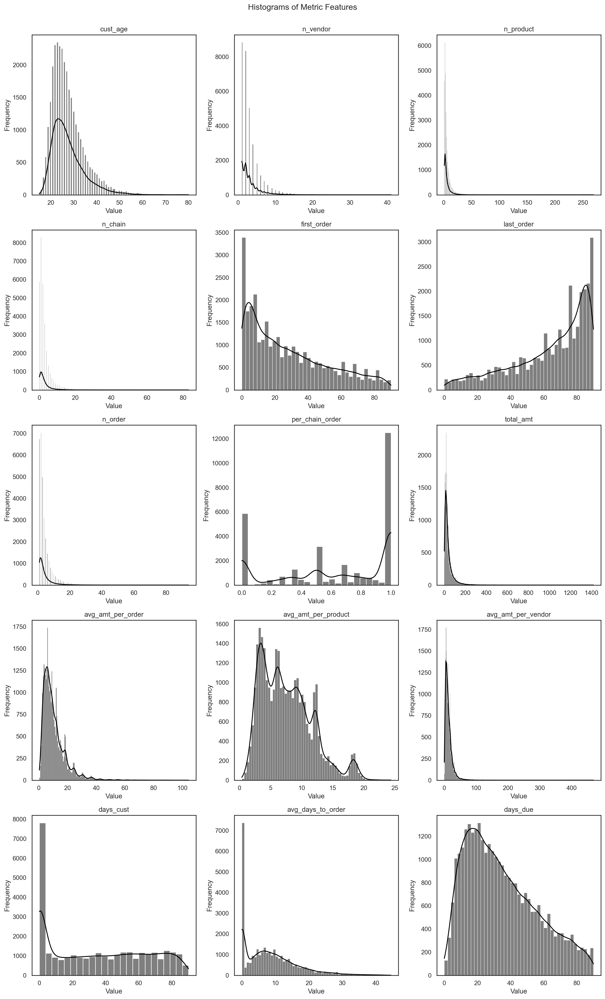

In [50]:
target = metric_features
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))

axes = axes.flatten()

# Loop through each numeric feature to plot histograms
for ax, feature in zip(axes, target):
    sns.histplot(data[feature], color='black', kde=True, ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Metric Features')
plt.tight_layout(rect=[0, 0, 1, 0.98])

# Show the plot
plt.show()

Our initial suspicions about the skewness of the data, are now in full display, as many of our features show clear right tail, sometimes with very sparse values.

More interestingly we note that:
- a. per_chain_order, that shows a sort of self-similar behaviour centered around approximately .5;
- b. almost one third of customers, placed a single order, because they were customers only for one day, which is visible in days_cust, and avg_days_to_order.
- c. the variables about average order and product show very consistent spikes, in such a way that it leads us to believe that these might not purport to the same overall populations. But to begin speculating, a population of customers that chooses products and vendors based on very well defined prices, infers either a subgroup with a very high sensitivity to product/price mix or fraud. 

##### **Correcting for one-time customers**

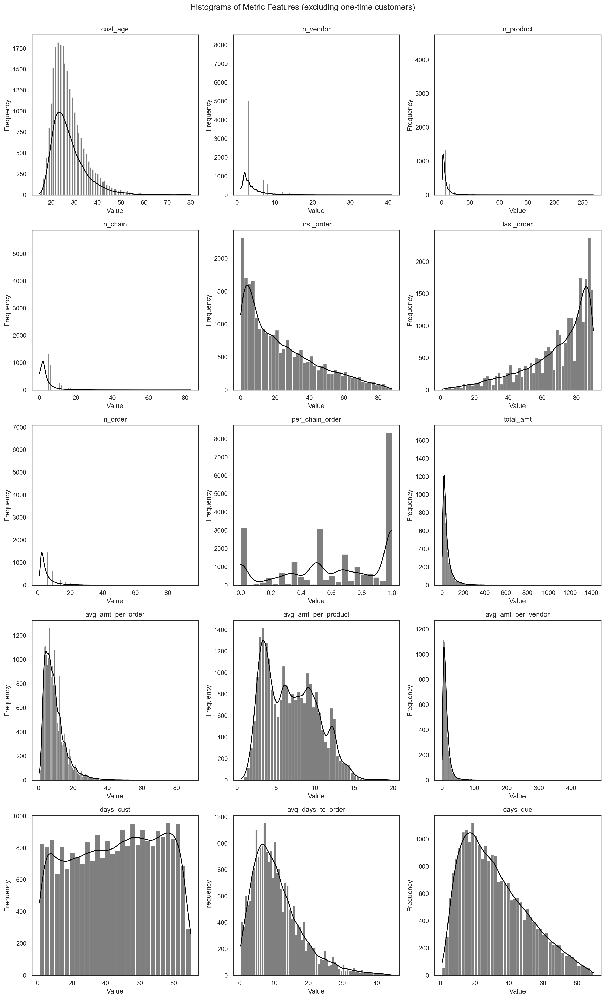

In [51]:
target = metric_features
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))

axes = axes.flatten()

# Loop through each numeric feature to plot histograms
for ax, feature in zip(axes, target):
    sns.histplot(data[data['days_cust'] > 0][feature], color='black', kde=True, ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Metric Features (excluding one-time customers)')
plt.tight_layout(rect=[0, 0, 1, 0.98])

# Show the plot
plt.show()

When we correct for one time purchases, we see that certain distributions like avg_amt_per order and per product become more locally well behaved i.e. smoother. This leans into the idea that these customers are taking advantage of pricing, or product when they make their first purchase through the service, i.e. their need for the service might be driven by perception of advantage. We will test this later by checking price sensitivity, by comparing these customers with promotions.

### 3.2.2. Day features

Below we dissect demand as a function of DOW, and go deeper into the issue with one-time customers.

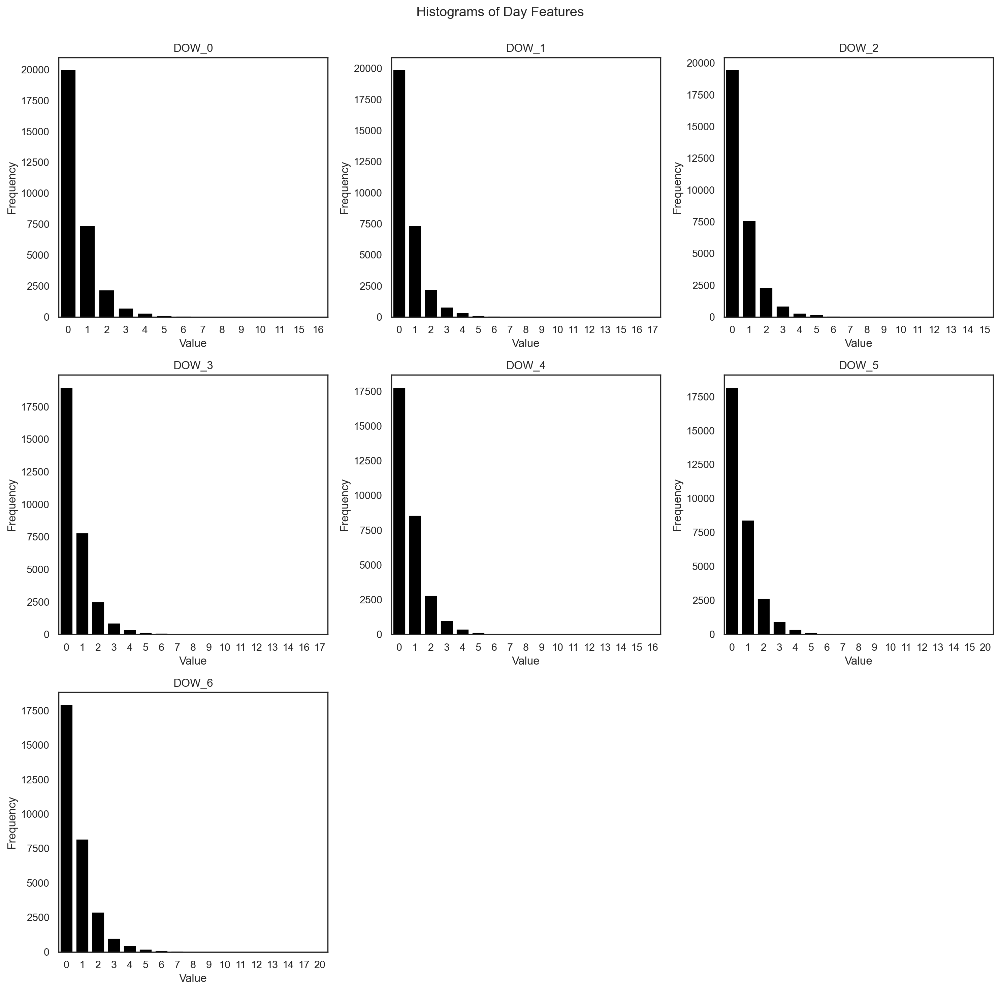

In [52]:
target = day_features
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))
axes = axes.flatten()

for ax, feature in zip(axes, target):
    sns.countplot(data=data, x=feature, color='black', ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Day Features')
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()

##### **Correcting for one time customers**

The removal of one time costumers also helps in this visualization. Although it is not yet completely clear what days customers prefer from here.

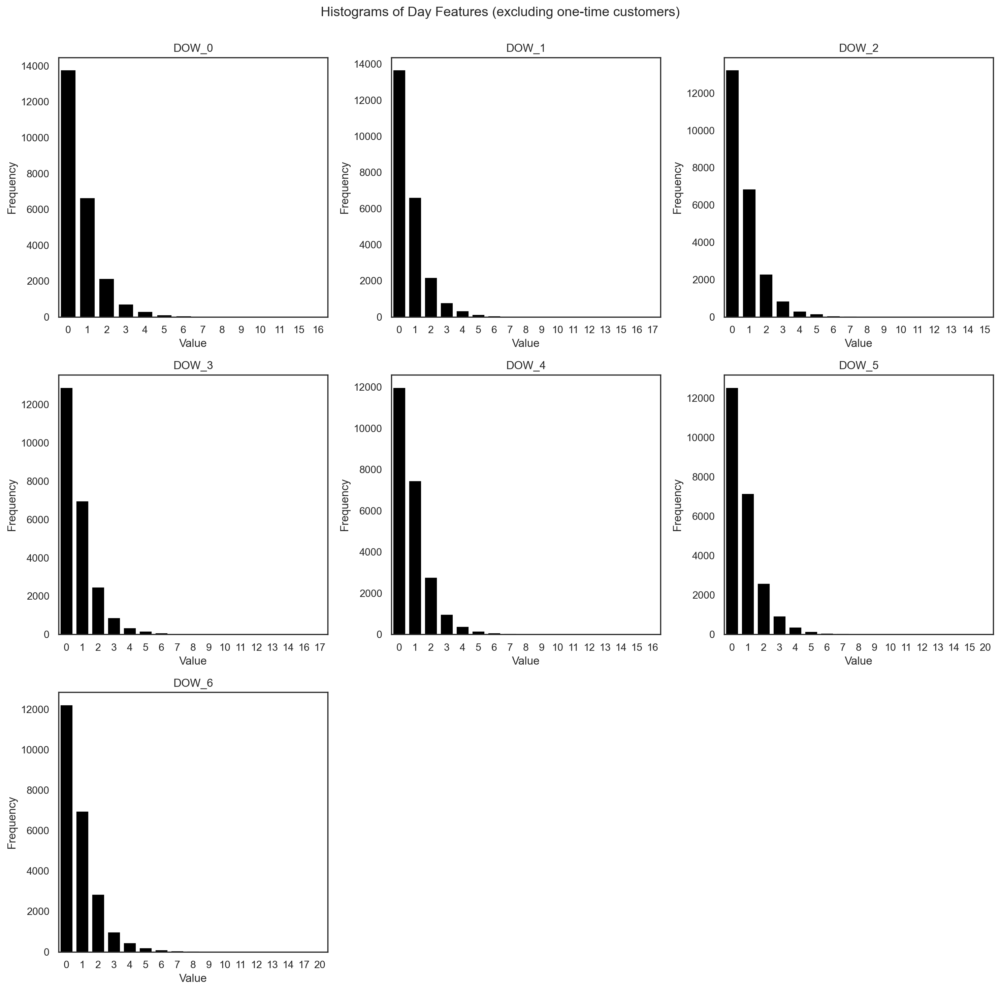

In [53]:
target = day_features
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))
axes = axes.flatten()

for ax, feature in zip(axes, target):
    sns.countplot(data=data[data['days_cust'] > 0], x=feature, color='black', ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Day Features (excluding one-time customers)')
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()

#### At least one day

In [54]:
# Store a pandas Series with orders for each day of week, i.e. excludes rows that had 0 orders for that day
at_least_one_day = {}

for day in day_features:
    at_least_one_day[day] = data.loc[data[day] > 0, day]

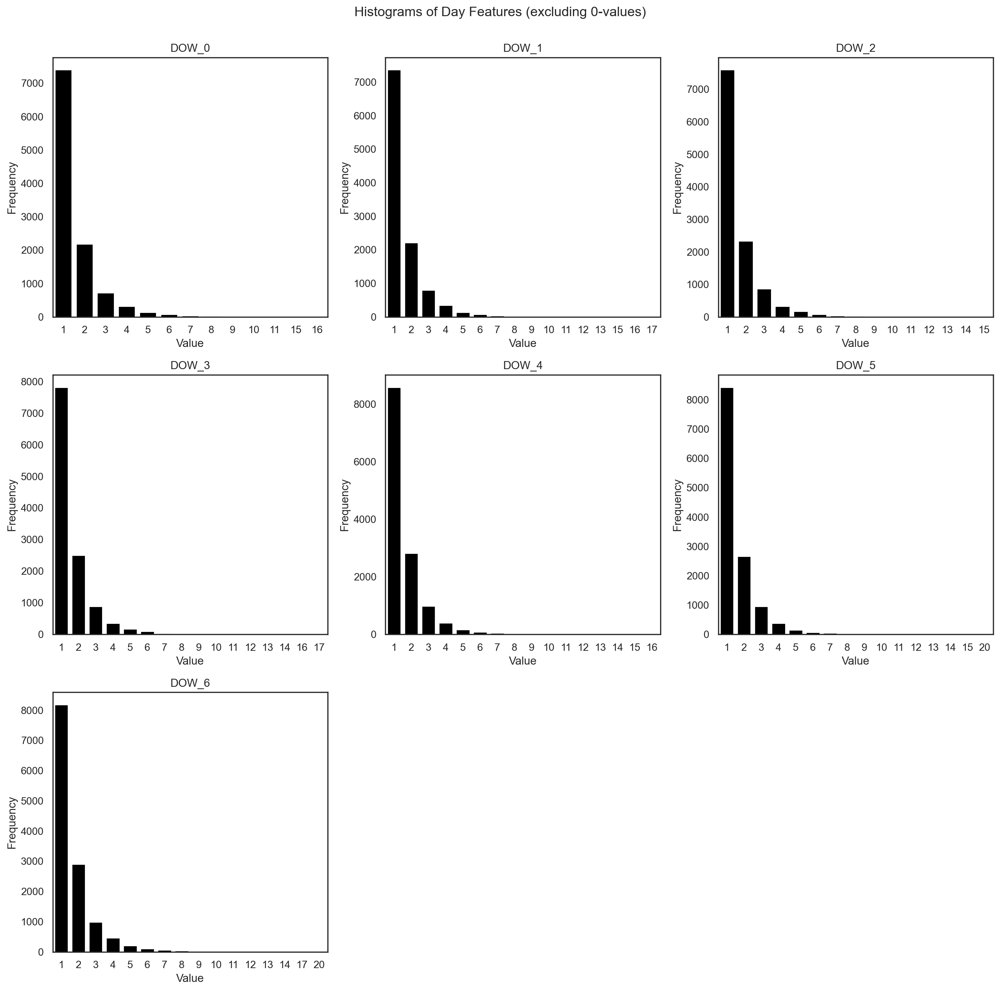

In [55]:
target = at_least_one_day.keys()
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))

axes = axes.flatten()

# Loop through each numeric feature to plot countplots
for ax, feature in zip(axes, target):
    sns.countplot(data=at_least_one_day, x=feature, color='black', ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Day Features (excluding 0-values)')
plt.tight_layout(rect=[0, 0, 1, 0.98])

# Show the plot
plt.show()

##### **Correcting for one-time customers**

Just as before, correcting for one time customers improves interpretability, as it reduces the number of trivial '0's' in the plots. Albeit both groups of histograms point us to the idea that we can define our superfan customers as those that make purchases in 3 or more days of the week. Lets quickly analyze this variable.

In [56]:
# Store a pandas Series with orders for customers who placed orders on more than one day for each day of week, i.e. excludes rows that had 0 orders for that day
at_least_one_day = {}

for day in day_features:
    at_least_one_day[day] = data[data['days_cust'] > 0].loc[data[day] > 0, day]

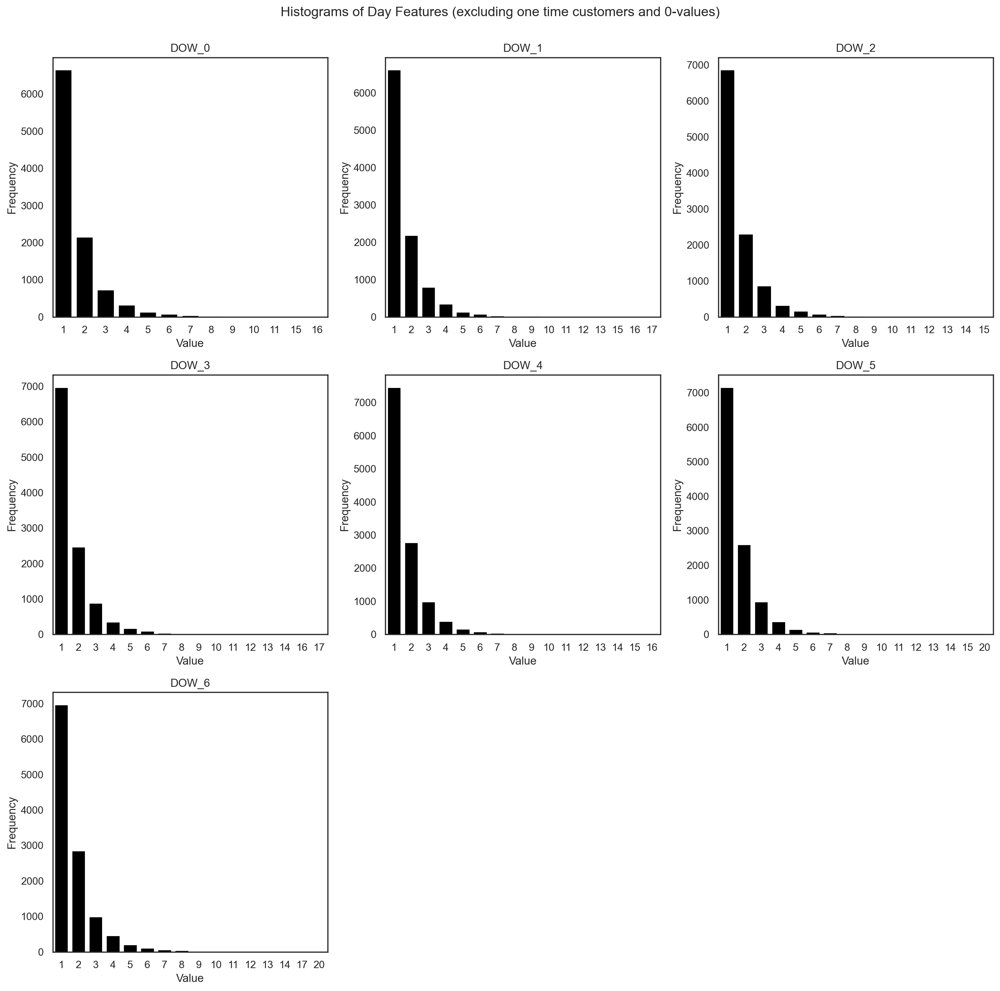

In [57]:
target = at_least_one_day.keys()
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))

axes = axes.flatten()

# Loop through each numeric feature to plot countplots
for ax, feature in zip(axes, target):
    sns.countplot(data=at_least_one_day, x=feature, color='black', ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Day Features (excluding one time customers and 0-values)')
plt.tight_layout(rect=[0, 0, 1, 0.98])

# Show the plot
plt.show()

Once we describe the data in terms of at least one day, and for customers that are not just one-time, we see that customers that make more orders over the period are slightly associated with higher values of the week.

#### Number of purchases in different days


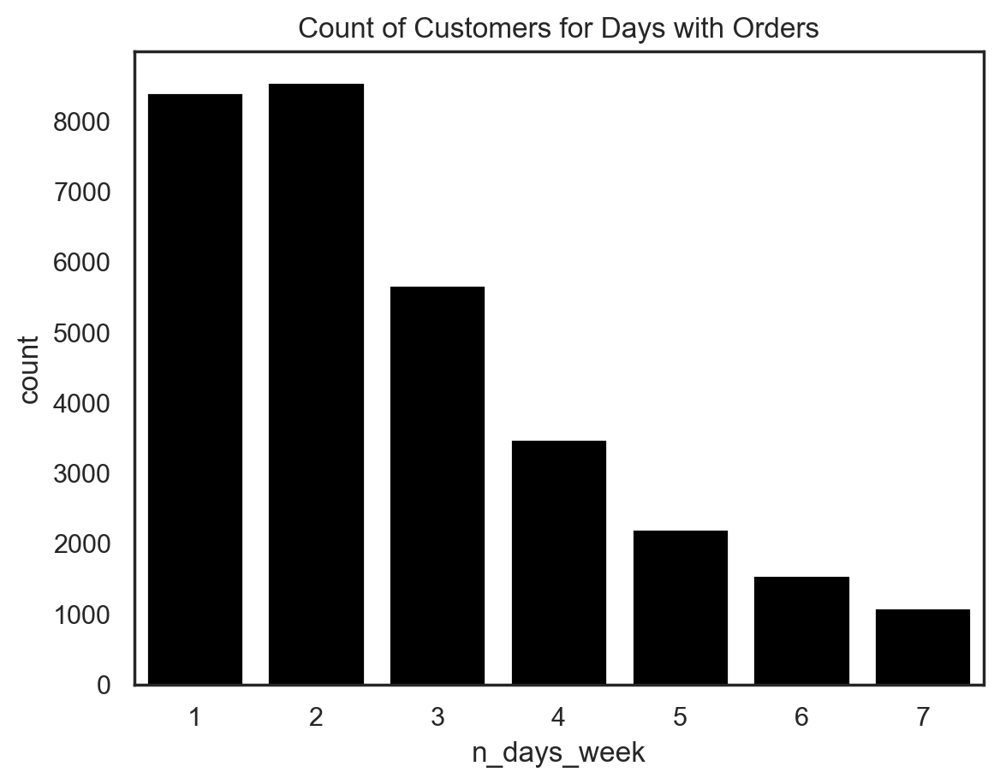

In [58]:
# Create a mask to check if each day column is populated
mask = data[[f'DOW_{i}' for i in range(7)]] > 0

# Sum over the mask to get the count of days with purchases for each row
data.loc[:, 'n_days_week'] = mask.sum(axis=1)

# Updating the list of metric features
metric_features.append('n_days_week')

sns.countplot(data=data, x='n_days_week', color='black')

plt.title('Count of Customers for Days with Orders')

plt.show()

##### **Correcting for one-time customers**

And here at last when we aggregate the values we see the impact of one-time consumers. Regardless, we see that most customers that are not one-time customers have made orders in between 2 and 3 different days of the week.

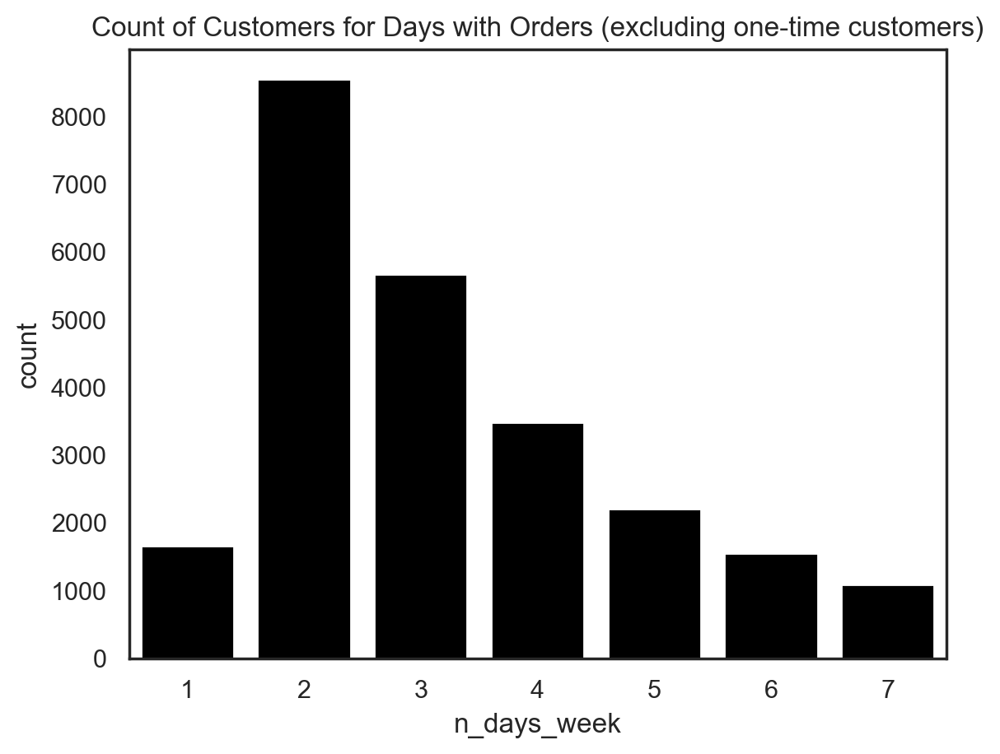

In [59]:
# Plotting after the correction
sns.countplot(data=data[data['n_order'] > 1], x='n_days_week', color='black')

plt.title('Count of Customers for Days with Orders (excluding one-time customers)')

plt.show()

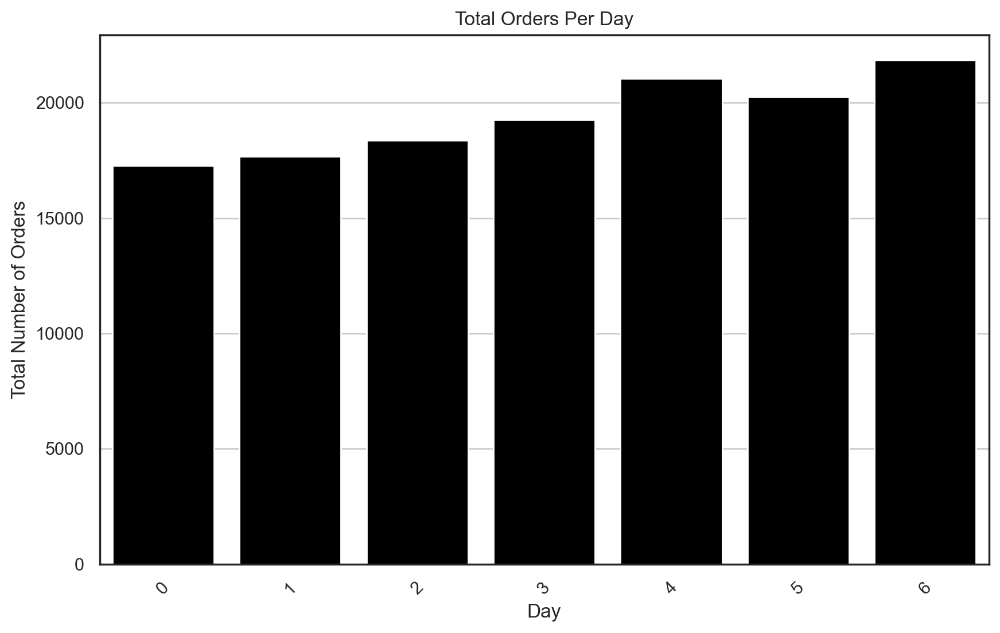

In [168]:
df = data[day_features].copy(deep=True)

# Transform the DataFrame
df_melted = df.melt(var_name='Day', value_name='Orders').dropna()

# Sum the total orders for each hour
hourly_orders = df_melted.groupby('Day')['Orders'].sum().reset_index()

# Extract the hour from the column names (assuming they are in the format 'hr X')
hourly_orders['Day'] = hourly_orders['Day'].apply(lambda x: int(x[4:]))

# Sort by the hour
hourly_orders = hourly_orders.sort_values('Day')

# Alternatively, using Seaborn for a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(data=hourly_orders, x='Day', y='Orders', color='black')
plt.xlabel('Day')
plt.ylabel('Total Number of Orders')
plt.title('Total Orders Per Day')
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.show()

### 3.2.3. Hour features

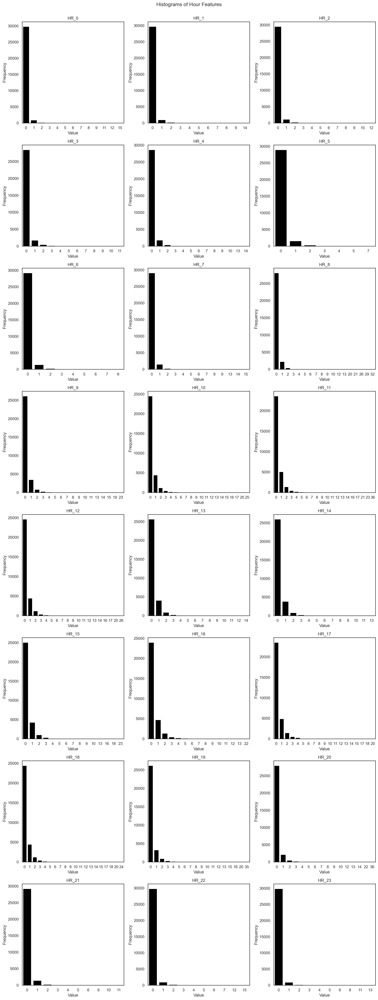

In [60]:
target = hour_features
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))
axes = axes.flatten()

for ax, feature in zip(axes, target):
    sns.countplot(data=data, x=feature, color='black', ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Hour Features')
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


##### **Correcting for one-time customers**

Just as before, correcting for one time customers improves interpretability, as it reduces the number of trivial '0's' in the plots.

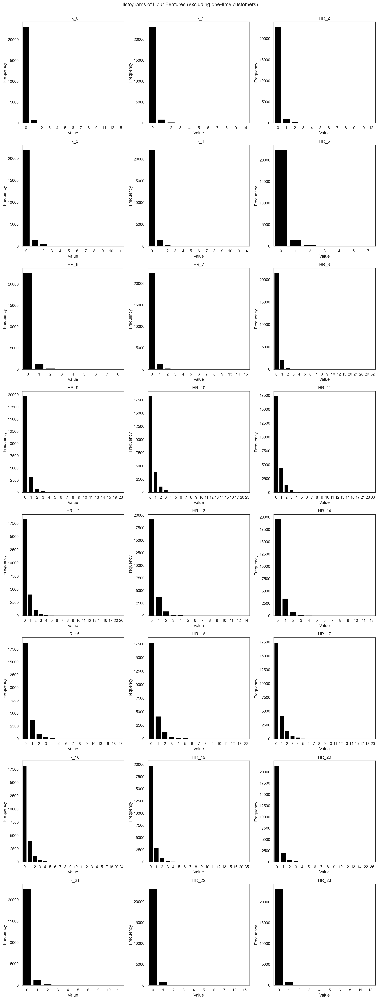

In [61]:
target = hour_features
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))
axes = axes.flatten()

for ax, feature in zip(axes, target):
    sns.countplot(data=data[data['n_order'] > 1], x=feature, color='black', ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Hour Features (excluding one-time customers)')
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


Most people did not make a purchase at most hours, however, the fact that the values ranging from 1 to 3 are more highly populated for certain hours, does imply again that there is a clear preference for orders to line up with meal hours. 

We need to however take into consideration that food needs to be prepared and delivered, and that customers might account for this, when they place an order, thus the order placement in our records likely reflects this perceived lag; as orders begin as early as 10, which on its own could be understood as breakfast, but if we consider that an order process initiated at 10:45 and finalized and placed at 10:55 - which would fall onto the 10H bracket - that then takes 45 minutes to reach the customers door. 

This means that the customer is having lunch between 11:40 and 12:00, which is a more habitual, if albeit slightly early hour for lunch.

#### At least one hour

In [62]:
# Store a pandas Series with orders for each hour of day, i.e. excludes rows that had 0 orders for that hour
at_least_one_hour = {}

for hour in hour_features:
    at_least_one_hour[hour] = data.loc[data[hour] > 0, hour]

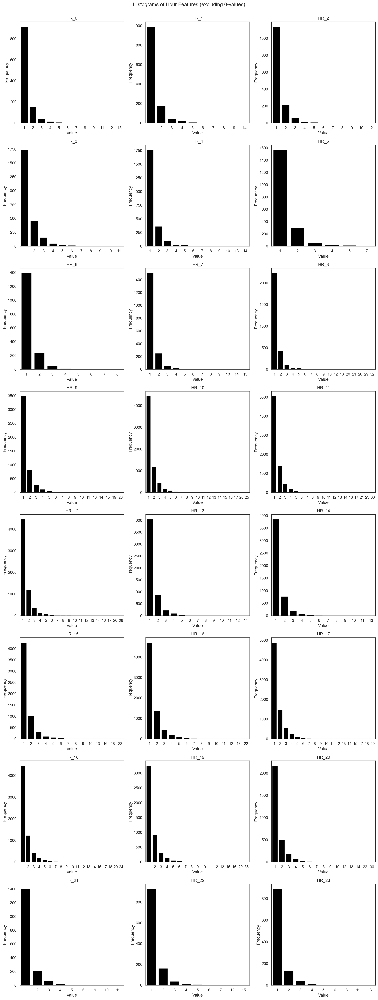

In [63]:
target = at_least_one_hour.keys()
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))
axes = axes.flatten()

for ax, feature in zip(axes, target):
    sns.countplot(data=at_least_one_hour, x=feature, color='black', ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Hour Features (excluding 0-values)')
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


Most customers that have made more than one order at a particular time, have done so, at meal hours. This implies that our more regular customers are to be found in the subset of those that observe habit, and plan ahead for their meal time. Curiously, HR_5 is the one that is associated with a smaller relative frequency gap between one and two orders, which implies that knowing that a customer placed an order at 5 in the morning, gives us greater confidence that they will have done so, more than once.

This makes intuitive sense, if we account for a. party goers, b. night shift workers.

##### **Correcting for one-time customers**

Just as before, correcting for one time customers improves interpretability, as it reduces the number of trivial '0's' in the plots.

In [64]:
# Store a pandas Series with orders for each hour of day, i.e. excludes rows that had 0 orders for that hour
at_least_one_hour = {}

for hour in hour_features:
    at_least_one_hour[hour] = data[data['days_cust'] > 0].loc[data[hour] > 0, hour]

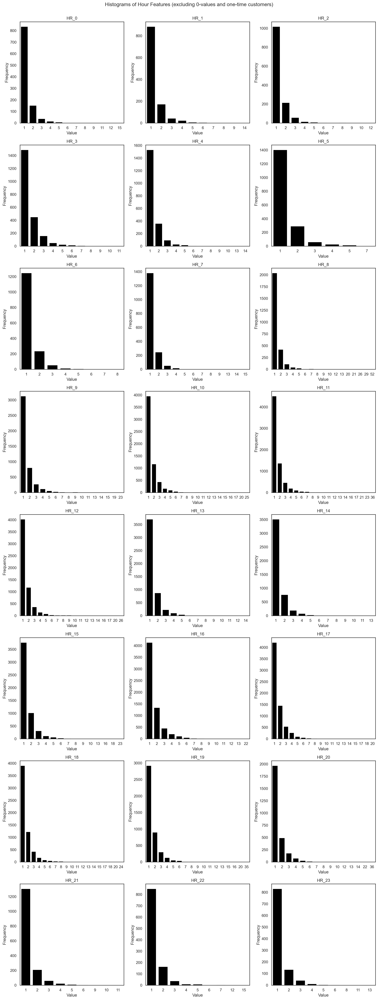

In [65]:
target = at_least_one_hour.keys()
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))
axes = axes.flatten()

for ax, feature in zip(axes, target):
    sns.countplot(data=at_least_one_hour, x=feature, color='black', ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Hour Features (excluding 0-values and one-time customers)')
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


#### Number of purchases at different hours

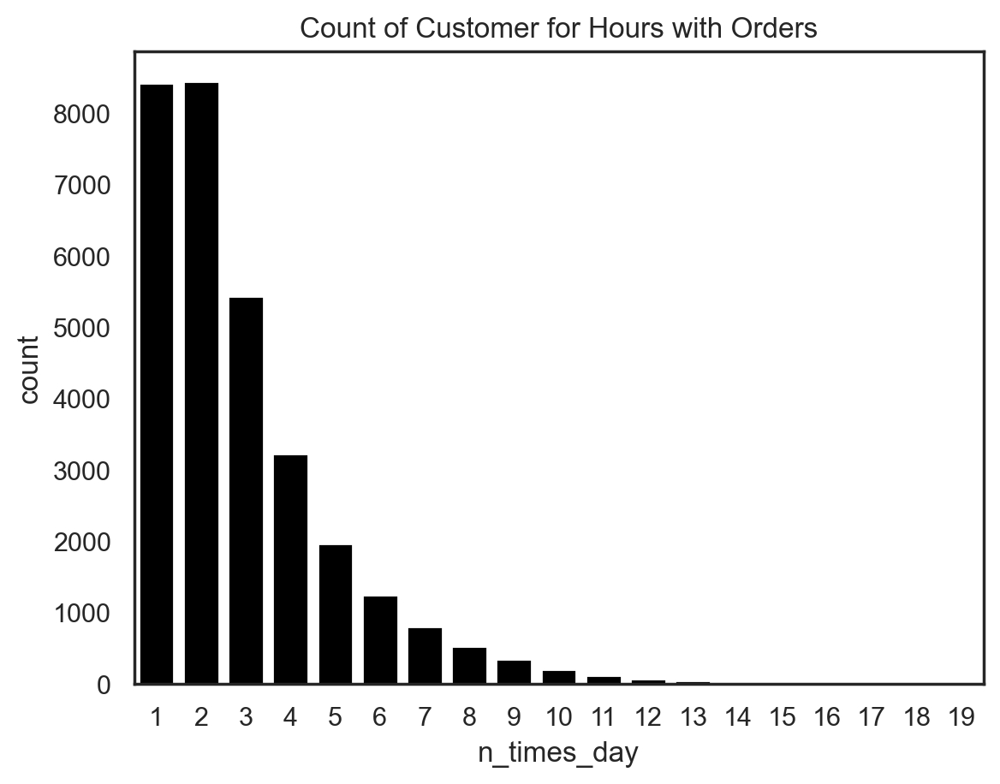

In [66]:
# Create a mask to check if each hour column is populated
mask = data[hour_features] > 0

# Sum over the mask to get the count of hours with purchases for each row
data.loc[:, 'n_times_day'] = mask.sum(axis=1)

# Updating the list of metric features
metric_features.append('n_times_day')

sns.countplot(data=data, x='n_times_day', color='black')

plt.title('Count of Customer for Hours with Orders')

plt.show()

This plot is very tricky to interpret as we have identified that there are many customers that have made only one purchase, as such we would expect those customers to muddle the true values.

##### Correcting for one-time customers

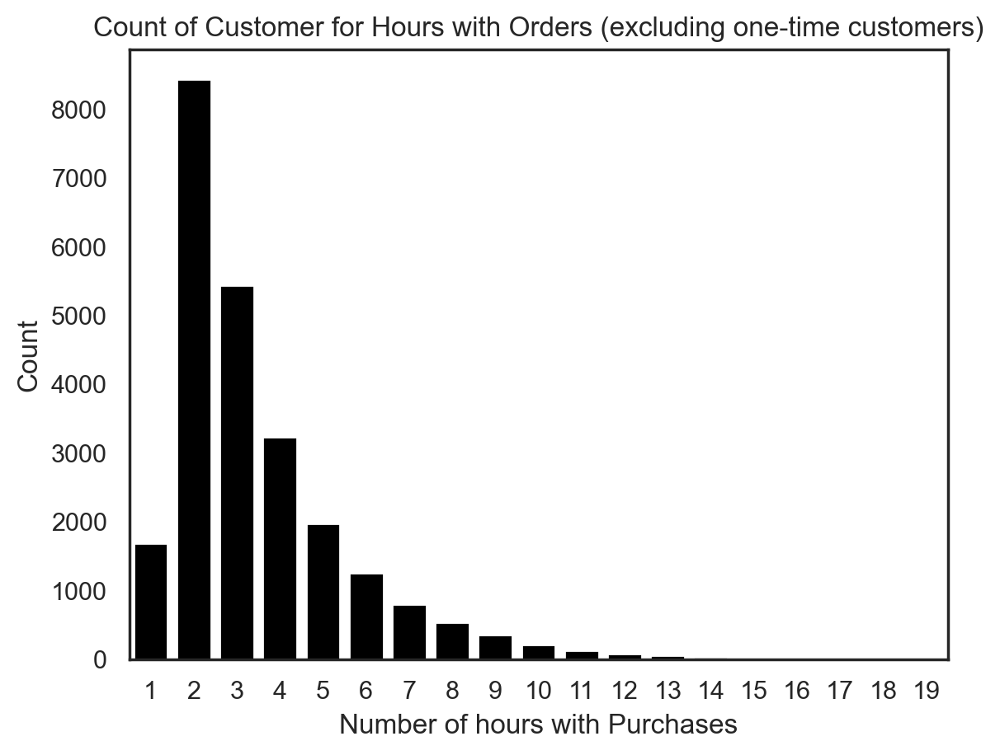

In [67]:
# Create the histogram for customers with more than one order
sns.countplot(data=data[data['n_order'] > 1], x='n_times_day', color='black')

plt.xlabel('Number of hours with Purchases')
plt.ylabel('Count')
plt.title('Count of Customer for Hours with Orders (excluding one-time customers)')

# Show the plot 
plt.show()

When we net customers that made only one purchase, the distribution of this variable becomes much more apparent. <br> <br>
Customers tend to concentrate the orders that they make around 2 to 4 distinct hours. Ironically, this further reinforces the idea that we need to consider purging our main dataset of these values, at least for the purpose of understanding the average customer, if not all together. 

Strictly speaking, with the evidence thus collected we have evidence to believe these values likely represent either a. people that wanted to try out the service; b. people that were trying to take advantage of a one time deal, on instalation of the service, on a product, etc., but that otherwise do not wish to continue using the service; c. fraudsters creating multiple accounts for the purposes of b. Of course, there is the risk that we are removing customers that legitemately belong to the customer base, but without any further way of filtering both situations, we feel it makes sense to put these aside. 

Moreover, there are considerations regarding if these values are even worth considering as part of our clustering, as to be fair, it is trivial to build them as a group and just append them to our clusters, and in fact, we might just find that without them our algorithms that depend on distances might have an easier time with other groups.

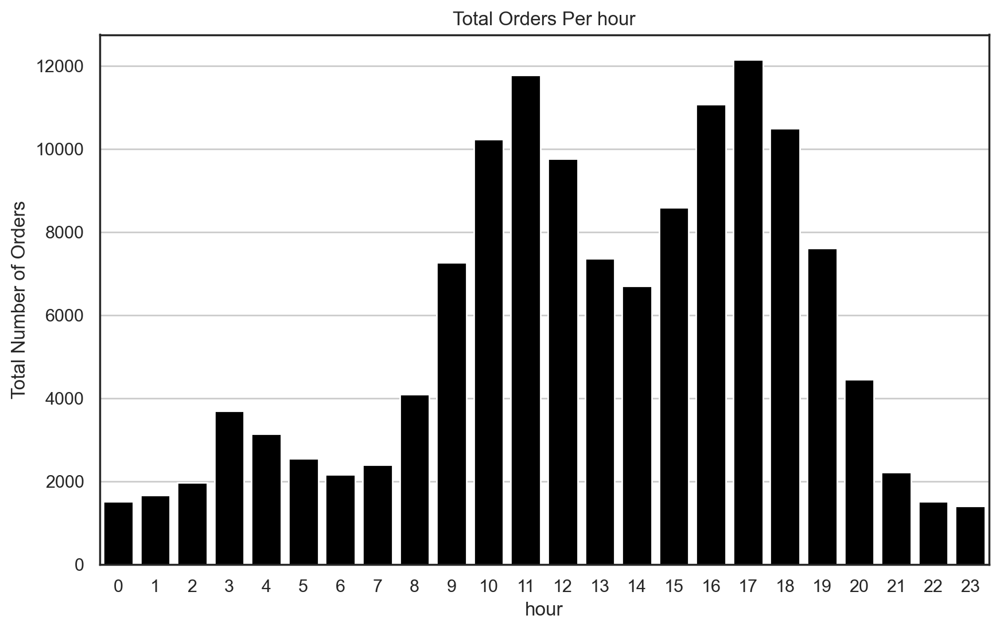

In [167]:
df = data[hour_features].copy(deep=True)

# Transform the DataFrame
df_melted = df.melt(var_name='hour', value_name='Orders').dropna()

# Sum the total orders for each hour
hourly_orders = df_melted.groupby('hour')['Orders'].sum().reset_index()

# Extract the hour from the column names (assuming they are in the format 'hr X')
hourly_orders['hour'] = hourly_orders['hour'].apply(lambda x: int(x[3:]))

# Sort by the hour
hourly_orders = hourly_orders.sort_values('hour')

# Alternatively, using Seaborn for a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(data=hourly_orders, x='hour', y='Orders', color='black')
plt.xlabel('hour')
plt.ylabel('Total Number of Orders')
plt.title('Total Orders Per hour')
plt.grid(axis='y')
plt.show()

### 3.2.4. Wrangling the beast

At this point we are thouroughly conviced that one-time customers are contributing very negatively to our analysis, to keep them in our set, we will instead create a boolean check, for one-time customers and filter our sets that way. 

In [68]:
# We create the flag as a variable for further use, 
data['regular'] = (data['days_cust'] != 0)


# But also a slicer for utility
regulars = data['regular'] == 1

### 3.2.5. Cuisine features

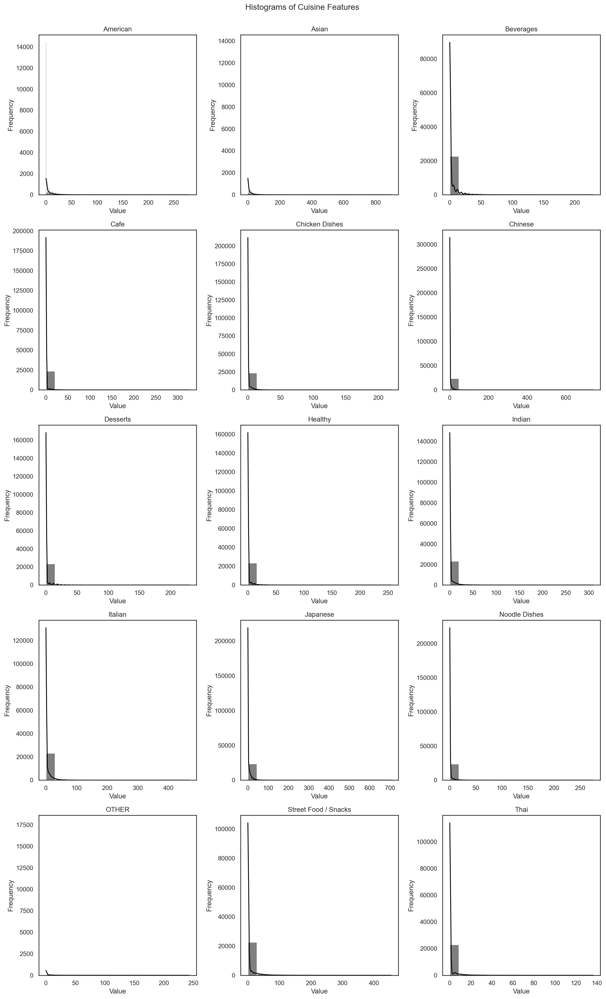

In [69]:
target = cuisine_features
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))

axes = axes.flatten()

# Loop through each numeric feature to plot histograms
for ax, feature in zip(axes, target):
    sns.histplot(data.loc[regulars, feature], color='black', kde=True, ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Cuisine Features')
plt.tight_layout(rect=[0, 0, 1, 0.98])

# Show the plot
plt.show()

We have no hope of interpreting this.

#### At least one cuisine

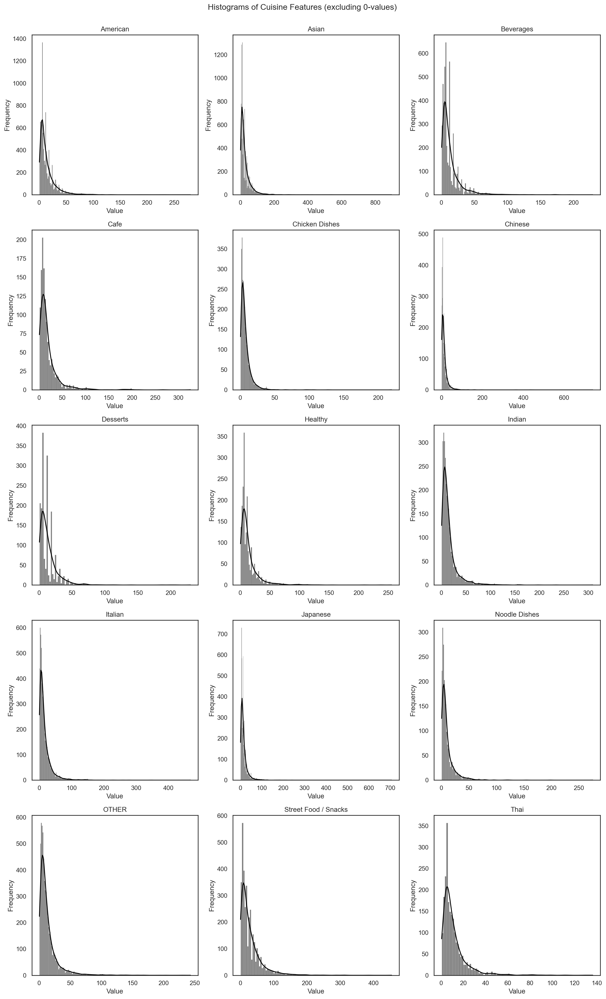

In [70]:
target = target = cuisine_features
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))

axes = axes.flatten()

# Loop through each numeric feature to plot histograms
for ax, feature in zip(axes, target):
    sns.histplot(data.loc[regulars & data[feature] > 0, feature], color='black', kde=True, ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Cuisine Features (excluding 0-values)')
plt.tight_layout(rect=[0, 0, 1, 0.98])

# Show the plot
plt.show()

This does in fact improve interpretability, but it is still a difficult endeavour. We can see some patterns particular amounts spent, which might be evidence of a small number of products being purchased, and then the total amount spent in each kitchen being merely a reflection of this multiplication operation. 

So in limine if this logical abduction makes any sense, then what we see is that the histograms for which the distributions show what appear to be several modes, actually purports to customers strongly prefering a particular set of products within that specific type of cuisine. This then further implies that customers that opt for this type of cuisine, have a preference for this product at all levels of total aggregate spending.

#### Number of different cuisine purchases

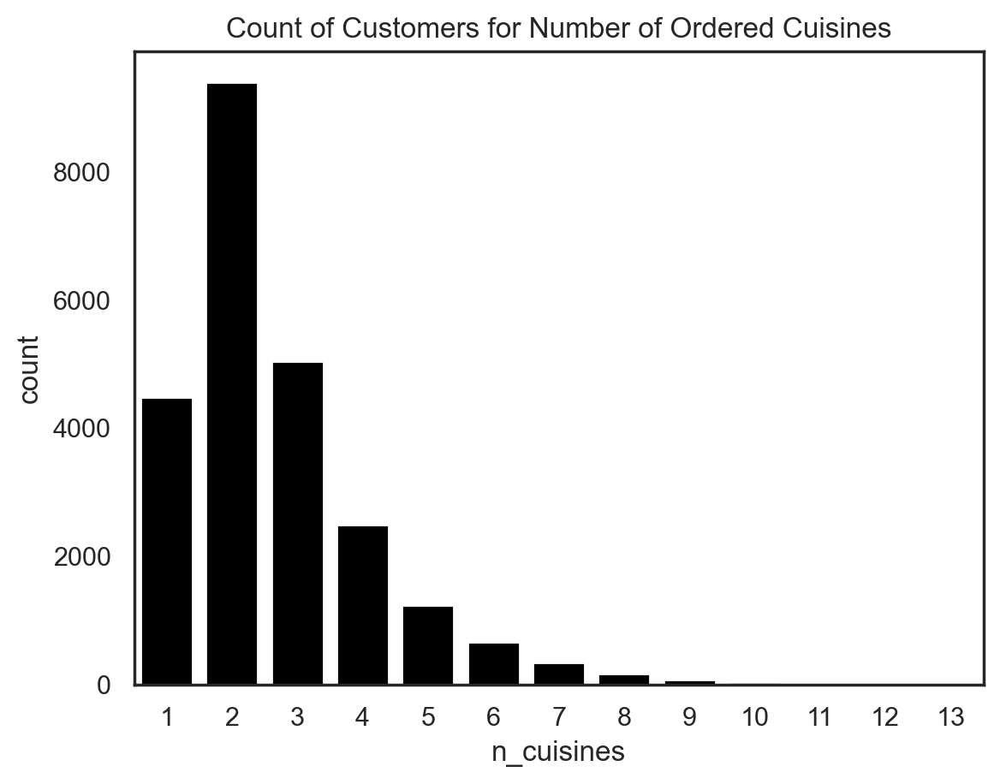

In [71]:
# Create a mask where values are greater than zero (indicating an order)
mask = data[cuisine_features] > 0

# Use mask to get the ordered cuisines for each row
data.loc[:, 'ordered_cuisines'] = mask.apply(lambda row: [cuisine for cuisine, ordered in row.items() if ordered], axis=1)

# Updating the non_metric_features_list
non_metric_features.append('ordered_cuisines')

# Use mask to get the number of cuisines for each row
data.loc[:, 'n_cuisines'] = mask.sum(axis=1)

# Updating the metric_features_list
metric_features.append('n_cuisines')

# Display countplot for how many cuisines were ordered per customer
sns.countplot(data=data.loc[regulars, :], x='n_cuisines', color='black')

plt.title('Count of Customers for Number of Ordered Cuisines')

plt.show()

#### Order Cuisines by customer

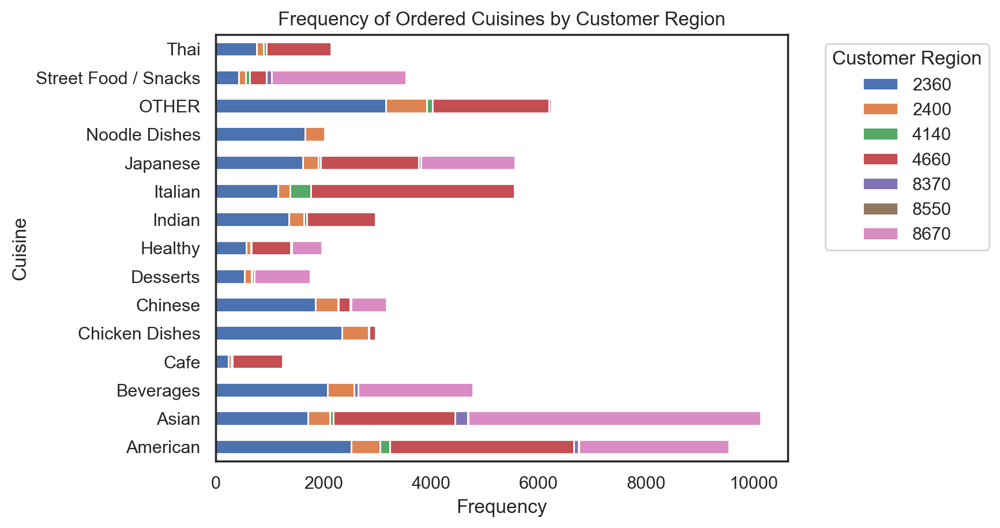

In [72]:
# Explode 'ordered_cuisines' and filter for regular customers
data_exploded = data.loc[regulars, :].explode('ordered_cuisines')

# Drop rows where 'ordered_cuisines' is NaN
data_exploded = data_exploded.dropna(subset=['ordered_cuisines'])

# Create a cross-tabulation of cuisine counts by customer region
cuisine_region_counts = pd.crosstab(data_exploded['ordered_cuisines'], data_exploded['cust_region'])

# Plot a stacked horizontal bar chart
cuisine_region_counts.plot(kind='barh', stacked=True)  # Customize colors as needed

# Customize the plot
plt.xlabel("Frequency")
plt.ylabel("Cuisine")
plt.title("Frequency of Ordered Cuisines by Customer Region")
plt.legend(title="Customer Region", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


#### Total amount per cuisine

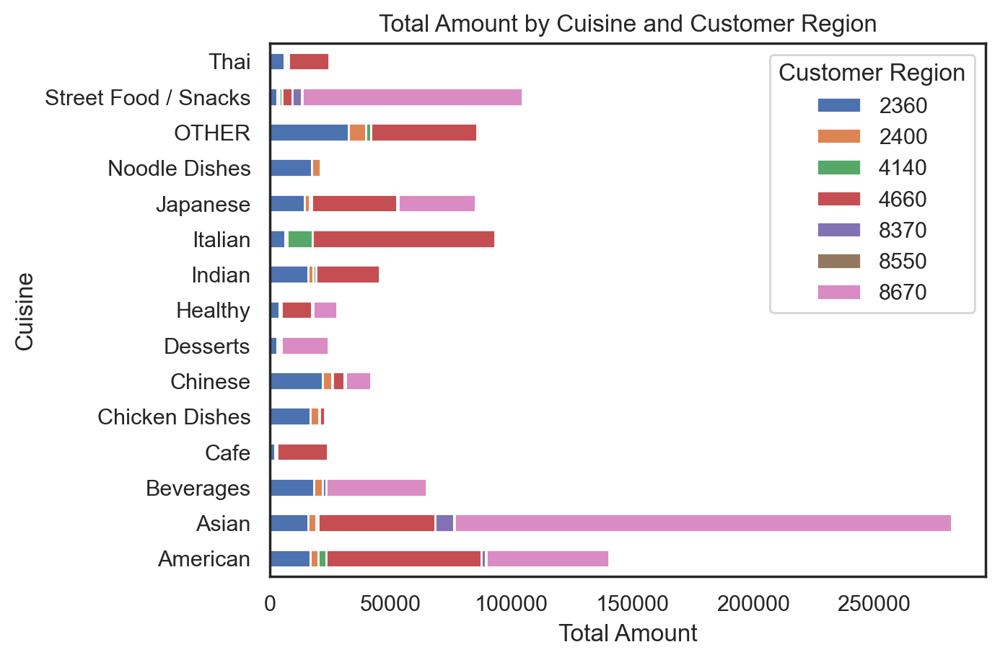

In [73]:
# Melt the DataFrame to transform cuisine features into a single 'cuisine' column
melted_data = data.loc[regulars, :].melt(id_vars=['cust_region'], value_vars=cuisine_features, 
                                         var_name='cuisine', value_name='order_count')

# Filter out rows where there are no orders (order_count is 0)
melted_data = melted_data[melted_data['order_count'] > 0]

# Group by 'cuisine' and 'cust_region' to get the sum of orders for each combination
cuisine_region_counts = melted_data.groupby(['cuisine', 'cust_region'], observed=False)['order_count'].sum().reset_index()

# Pivot the data to prepare it for stacking in the plot
cuisine_region_counts_pivot = cuisine_region_counts.pivot(index='cuisine', columns='cust_region', values='order_count').fillna(0)

# Plot a stacked horizontal bar chart
cuisine_region_counts_pivot.plot(kind='barh', stacked=True)  # Adjust colors as needed

# Customize the plot
plt.xlabel("Total Amount")
plt.ylabel("Cuisine")
plt.title("Total Amount by Cuisine and Customer Region")
plt.legend(title="Customer Region")
plt.show()


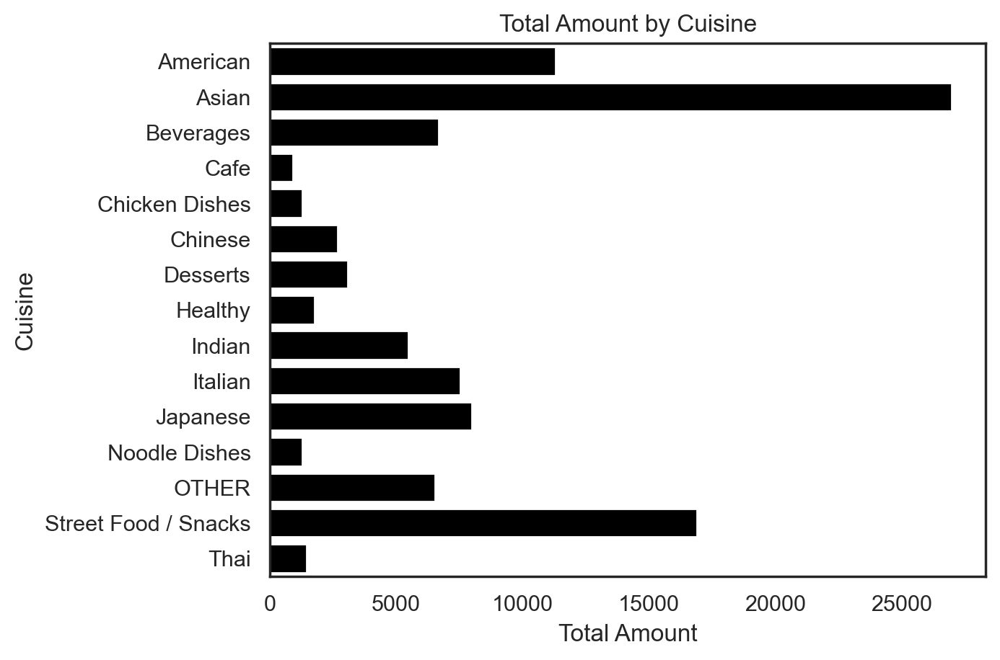

In [74]:
# Sum orders for each cuisine across all rows
cuisine_order_counts = data.loc[~regulars, :][cuisine_features].sum().reset_index()
cuisine_order_counts.columns = ['cuisine', 'sum']

# Plot the total count of orders for each cuisine
sns.barplot(data=cuisine_order_counts, y='cuisine', x='sum', color='black')
plt.xlabel("Total Amount")
plt.ylabel("Cuisine")
plt.title("Total Amount by Cuisine")
plt.show()

### 3.2.6. Non-metric features

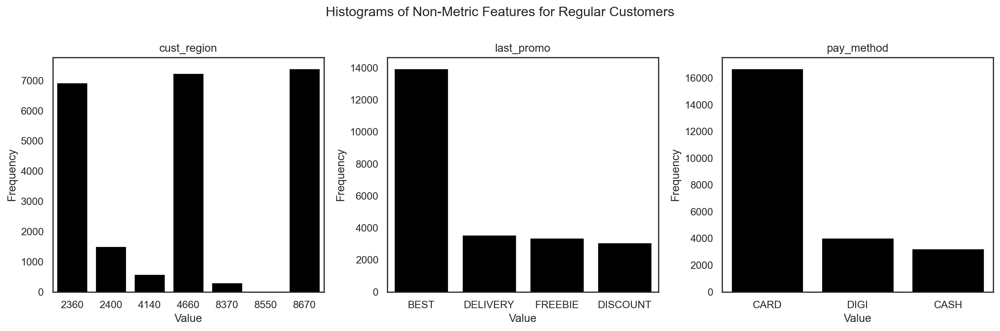

In [75]:
target = non_metric_features[:3]
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))

axes = axes.flatten()

# Loop through each feature to plot barplots
for ax, feature in zip(axes, target):
    # Calculate frequency counts
    value_counts = data.loc[regulars, feature].value_counts().reset_index()
    value_counts.columns = ['Value', 'Frequency']
    
    # Plot with sns.barplot
    sns.barplot(data=value_counts, x='Value', y='Frequency', color='black', ax=ax)
    
    # Set title and labels
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Non-Metric Features for Regular Customers')
plt.tight_layout(rect=[0, 0, 1, 0.98])

# Show the plot
plt.show()


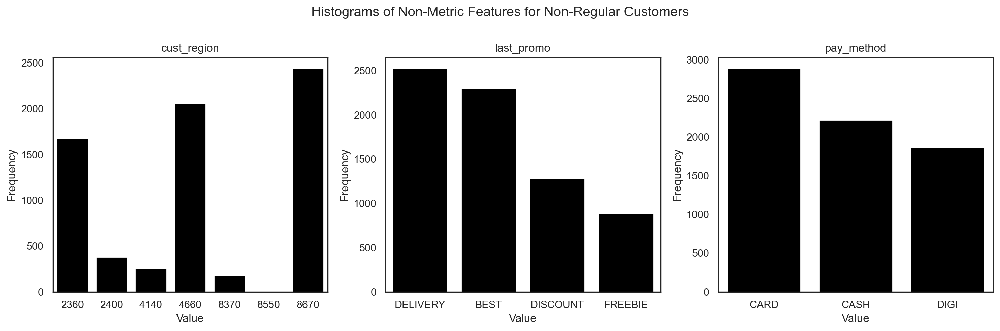

In [76]:
target = non_metric_features[:3]
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))

axes = axes.flatten()

# Loop through each feature to plot barplots
for ax, feature in zip(axes, target):
    # Calculate frequency counts
    value_counts = data.loc[~regulars, feature].value_counts().reset_index()
    value_counts.columns = ['Value', 'Frequency']
    
    # Plot with sns.barplot
    sns.barplot(data=value_counts, x='Value', y='Frequency', color='black', ax=ax)
    
    # Set title and labels
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Non-Metric Features for Non-Regular Customers')
plt.tight_layout(rect=[0, 0, 1, 0.98])

# Show the plot
plt.show()


Pay methods by one time customers were highly irregular. It is also true that for these customers a much greater emphasis on promotions was present, and since their last promotion is their only promotion, we can be certain that this was the promotion used for the purchase. Lastly, regions 2400, 4140 and 8370 see a smaller number of one time customers.

## 3.3. Flagging outliers with the log transformation

Note below how the boxplots of our variables are in absolute disarray. To this end, it is not so much that we wish to eliminate our outliers, as this is not the time for that, but certainly create flags based on certain types out liers.

The log transformation offers a very robust way to find such intervals.


Note: the "regulars" condition carries over to this analysis, and will be repeated ad nauseum

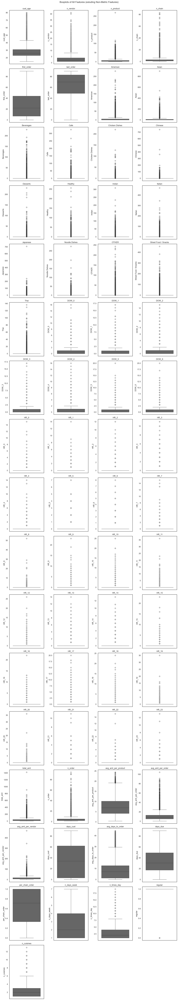

In [77]:
target = data.drop(columns=non_metric_features).columns
num_features = len(target)
num_columns = 4
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))

axes = axes.flatten()

# Loop through each numeric feature to plot histograms
for ax, feature in zip(axes, target):
    sns.boxplot(y=data[feature], color='#666666', ax=ax)  
    ax.set_title(f'{feature}')

# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Boxplots of All Features (exluding Non-Metric Features)')
plt.tight_layout(rect=[0, 0, 1, 0.98])

# Show the plot
plt.show()

### 3.3.1. Tranformations

Many of our variables have a true zero value. As a workaround, we call the log1p function which does introduce some bias to our distributions.

In [78]:
# Dropping specified columns and getting remaining columns as a list
targets = data.drop(columns=[
    'cust_age'
    , 'first_order'
    , 'last_order'
    , 'days_cust'
    , 'days_due'
    , 'avg_days_to_order'
    , 'per_chain_order'
    , 'cust_region'
    , 'last_promo'
    , 'pay_method'
    , 'ordered_cuisines'
    , 'n_cuisines'
    , 'regular'
] + hour_features + day_features).columns.tolist()

# Initialize an empty DataFrame to store log-transformed columns
log_transformed = pd.DataFrame()

# We create a list of log_features to assist us in our exploration
log_features = log_transformed.columns.tolist()

# Apply log1p to each column in targets and add it to log_transformed with the prefix 'log_'
for col in targets:
    log_transformed[f"log_{col}"] = np.log1p(data[col])

# Concatenate the original DataFrame with the new log-transformed DataFrame
data = pd.concat([data, log_transformed], axis=1)

In [79]:
data.head()

,cust_region,cust_age,n_vendor,n_product,n_chain,first_order,last_order,last_promo,pay_method,American,Asian,Beverages,Cafe,Chicken Dishes,Chinese,Desserts,Healthy,Indian,Italian,Japanese,Noodle Dishes,OTHER,Street Food / Snacks,Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,cust_city,total_amt,n_order,avg_amt_per_product,avg_amt_per_order,avg_amt_per_vendor,days_cust,avg_days_to_order,days_due,per_chain_order,n_days_week,n_times_day,regular,ordered_cuisines,n_cuisines,log_n_vendor,log_n_product,log_n_chain,log_American,log_Asian,log_Beverages,log_Cafe,log_Chicken Dishes,log_Chinese,log_Desserts,log_Healthy,log_Indian,log_Italian,log_Japanese,log_Noodle Dishes,log_OTHER,log_Street Food / Snacks,log_Thai,log_cust_city,log_total_amt,log_n_order,log_avg_amt_per_product,log_avg_amt_per_order,log_avg_amt_per_vendor,log_n_days_week,log_n_times_day
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
118371798366,2360,18,2,5,1,0,1,DELIVERY,DIGI,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,28.88,0.0,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,2,28.88,2,5.776,14.44,14.44,1,0.5,89.5,0.5,2,1,True,[Indian],1,1.098612,1.791759,0.693147,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,3.397189,0.0,0.0,0.0,0.0,0.0,0.0,1.098612,3.397189,1.098612,1.913387,2.736962,2.736962,1.098612,0.693147
400089128395,8670,17,2,2,2,0,1,DISCOUNT,DIGI,12.82,6.39,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,8,19.21,2,9.605,9.605,9.605,1,0.5,89.5,1.0,2,2,True,"[American, Asian]",2,1.098612,1.098612,1.098612,2.626117,2.000128,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,2.197225,3.006178,1.098612,2.361326,2.361326,2.361326,1.098612,1.098612
1060080106083,4660,38,1,2,2,0,1,DISCOUNT,CASH,9.20,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,4,9.20,2,4.6,4.6,9.2,1,0.5,89.5,1.0,2,2,True,[American],1,0.693147,1.098612,1.098612,2.322388,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,1.609438,2.322388,1.098612,1.722767,1.722767,2.322388,1.098612,1.098612
338018592517,4660,20,2,5,0,0,2,BEST,DIGI,14.57,40.87,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,55.44,2,11.088,27.72,27.72,2,1.0,89.0,0.0,2,2,True,"[American, Asian]",2,1.098612,1.791759,0.0,2.745346,3.734570,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,1.609438,4.033178,1.098612,2.492213,3.357594,3.357594,1.098612,1.098612
459279132454,8670,40,2,2,0,0,2,FREEBIE,DIGI,0.00,24.92,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,8,24.92,2,12.46,12.46,12.46,2,1.0,89.0,0.0,2,2,True,[Asian],1,1.098612,1.098612,0.0,0.000000,3.255015,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,2.197225,3.255015,1.098612,2.599722,2.599722,2.599722,1.098612,1.098612


#### Plotting the log-normal transformed

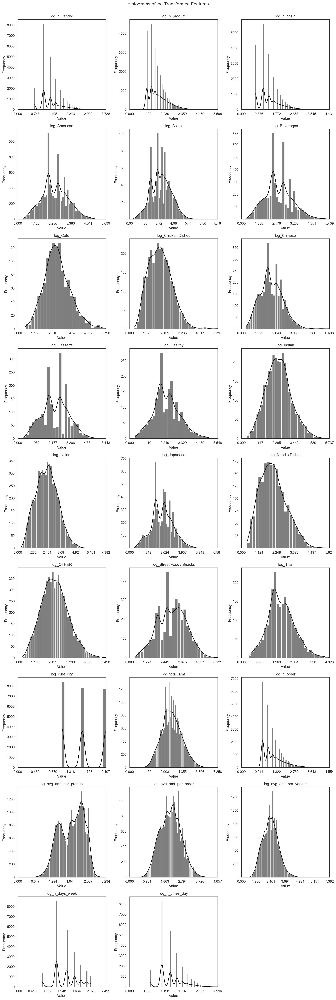

In [80]:
target = data.filter(regex="^log_").columns

num_features = len(data.filter(regex="^log_").columns)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))

axes = axes.flatten()

# Loop through each feature to plot histograms
for ax, feature in zip(axes, target):
    # Calculate min and max for the current feature
    lower_limit = 0 
    upper_limit = data[feature].max()
    
    # Plot histogram
    sns.histplot(data.loc[regulars & data[feature] > 0, feature], color='black', kde=True, ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')
    
    # Set x-axis limits and dynamically set ticks based on the range
    ax.set_xlim(lower_limit, upper_limit)
    
    # Calculate a reasonable tick interval
    tick_interval = (upper_limit - lower_limit) / 5  # Aim for 5 ticks
    ax.set_xticks(np.arange(lower_limit, upper_limit + tick_interval, tick_interval))

# Hide any extra subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of log-Transformed Features')
plt.tight_layout(rect=[0, 0, 1, 0.98])

# Show the plot
plt.show()

In truth, the discrete variables, look a bit odd, but naturally the log compresses them the least, which is why these distributions accumulate tighter packed intervals on the right tail. The boxplots below highlight the usefullness of this method.


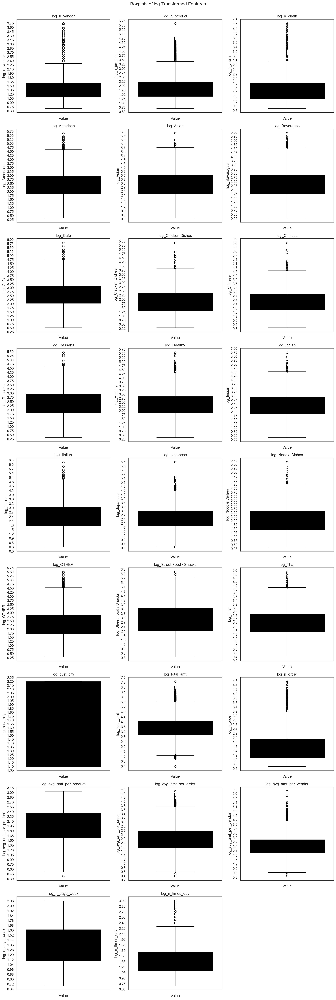

In [81]:
target = data.filter(regex="^log_").columns

num_features = len(data.filter(regex="^log_").columns)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))

axes = axes.flatten()

# Loop through each feature to plot histograms
for ax, feature in zip(axes, target):
    # Plot histogram
    sns.boxplot(y=data.loc[regulars & data[feature] > 0, feature], color='black',ax=ax)
    ax.set_title(f'{feature}')
    ax.set_xlabel('Value')

    # Add finer tick marks
    ax.yaxis.set_major_locator(mticker.MaxNLocator(25))  # Control the number of major ticks

# Hide any extra subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Boxplots of log-Transformed Features')
plt.tight_layout(rect=[0, 0, 1, 0.98])

# Show the plot
plt.show()

Since we are not really removing outliers, we can be more creative in our approach, we will attribute flags based one the following above IQR behaviours as follows:

    - foodie - n_vendor, n_product, n_order
        "Experiment with many vendors, order many products, and place many orders"
        
    - glutunous - avg_per_order, total_amt, n_chain
        "PLace large orders, spend a lot o money, mostly in chained restaurants"
        
    - loyal - avg_per_vendor, any_CUI
        "Spend a lot on each vendor, and spend a lot in a type of cuisine"

### 3.3.2. Creating Slices

In [82]:
# Initialize dictionaries for feature groups with flags and relevant columns
feature_groups = {
    'foodie': ['n_vendor', 'n_product', 'n_order', 'n_cuisines'],
    'gluttonous': ['avg_amt_per_order', 'total_amt', 'n_chain'],
    'loyal': ['avg_amt_per_vendor'] + cuisine_features
}


# Create columns to hold the flags for each feature group
data['foodie_flag'] = 0
data['gluttonous_flag'] = 0
data['loyal_flag'] = 0

# Function to calculate IQR bounds
def calculate_bounds(series):
    Q1 = series.quantile(0.25)
    Q3 = series.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return lower_bound, upper_bound

# Assign flags for each feature group
for group, features in feature_groups.items():
    for feature in features:
        log_feature = f"log_{feature}"
        
        if feature == 'n_cuisines':
            log_feature = feature
        
        lower_bound, upper_bound = calculate_bounds(data.loc[regulars & data[feature] > 0, log_feature])
        
        # Mark outliers for each group
        if group == 'foodie':
            data['foodie_flag'] |= (data[log_feature] > upper_bound).astype(int)
        elif group == 'gluttonous':
            data['gluttonous_flag'] |= (data[log_feature] > upper_bound).astype(int)
        elif group == 'loyal':
            data['loyal_flag'] |= (data[log_feature] > upper_bound).astype(int)

# Display results
for group in ['foodie_flag', 'gluttonous_flag', 'loyal_flag']:
    print(f"Number of customers flagged as {group.split('_')[0]}:", data[group].sum())


Number of customers flagged as foodie: 2790
Number of customers flagged as gluttonous: 796
Number of customers flagged as loyal: 495


In [83]:
# Create the subset based on the conditions
subset_df = data[
    (regulars) & 
    (~data['loyal_flag']) & 
    (~data['gluttonous_flag']) & 
    (~data['foodie_flag'])
].copy(deep=True)

### 3.3.3. Checking the results

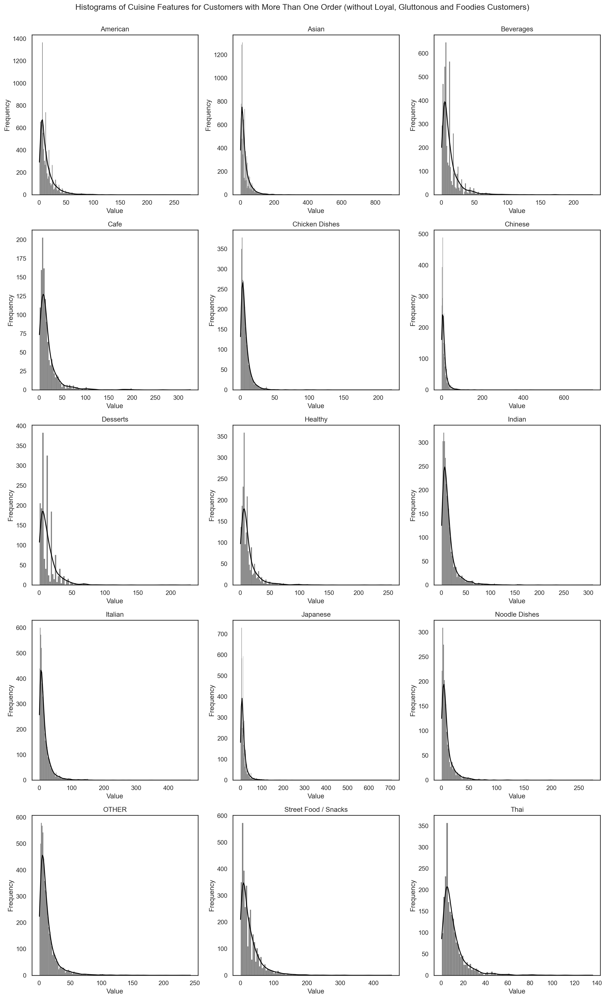

In [84]:
target = cuisine_features
num_features = len(target)
num_columns = 3
num_rows = (num_features + num_columns - 1) // num_columns

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(15, 5 * num_rows))

axes = axes.flatten()

# Loop through each numeric feature to plot histograms
for ax, feature in zip(axes, target):
    try:
        sns.histplot(data.loc[regulars & ~data['loyal_flag'] & ~data['gluttonous_flag'] & ~data['foodie_flag'] & data[feature] > 0, feature], color='black', kde=True, ax=ax)  # kde adds a density line
        ax.set_title(f'{feature}')
        ax.set_xlabel('Value')
        ax.set_ylabel('Frequency')
    except (ValueError, TypeError) as e:
        pass
        
# Hide any empty subplots
for i in range(len(target), len(axes)):
    fig.delaxes(axes[i])

plt.suptitle('Histograms of Cuisine Features for Customers with More Than One Order (without Loyal, Gluttonous and Foodies Customers)')
plt.tight_layout(rect=[0, 0, 1, 0.98])

# Show the plot
plt.show()

### 3.3.4. Investigating Proportion of Outliers by Customer Age

As we have not yet found a feature that was correlated with cust_age, we decided to check the distribution of outliers by customer age. We verify that the outliers follow an empiric distribution that is very similar to the one of customer age, meaning that the likelihood of being a customer is not a function of the age.

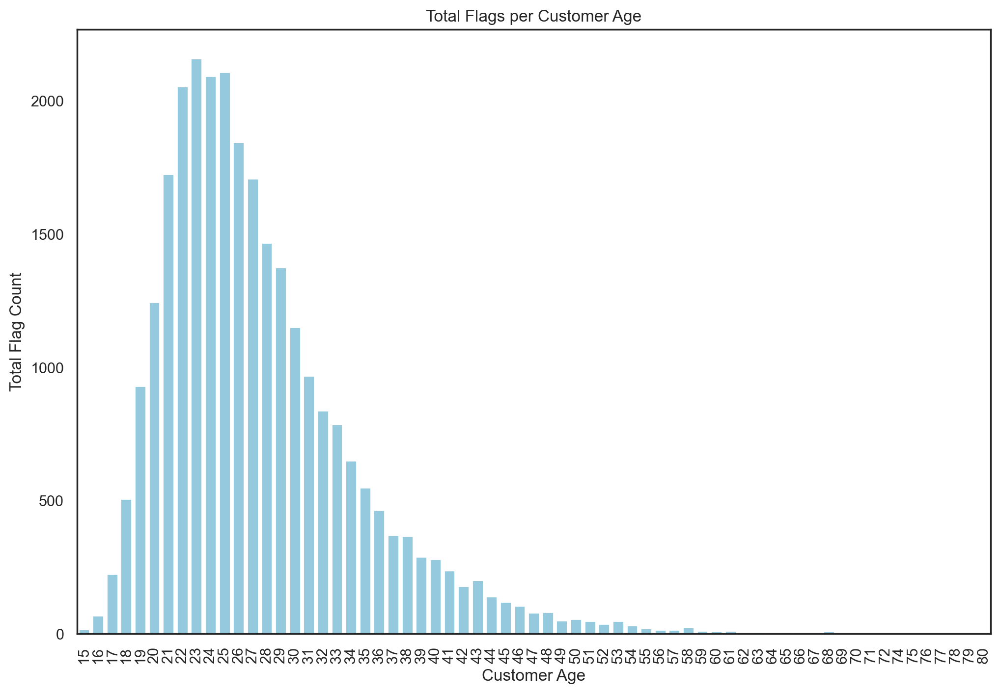

In [85]:
subset_df['flag_count'] = subset_df[['foodie_flag', 'gluttonous_flag', 'loyal_flag', 'regular']].sum(axis=1)

# Sum flag counts for each customer age
age_flag_sums = subset_df.groupby('cust_age')['flag_count'].sum()

plt.figure(figsize=(12, 8))

# Plotting with cust_age on the x-axis and sum of flag_count on the y-axis
sns.barplot(x=age_flag_sums.index, y=age_flag_sums.values, color="skyblue")
plt.xlabel("Customer Age")
plt.ylabel("Total Flag Count")
plt.title("Total Flags per Customer Age")
plt.xticks(rotation=90)  # Rotate x labels if there are many ages
plt.show()

## 3.5. Looking for Potential Customer Discriminating Variable Parameters

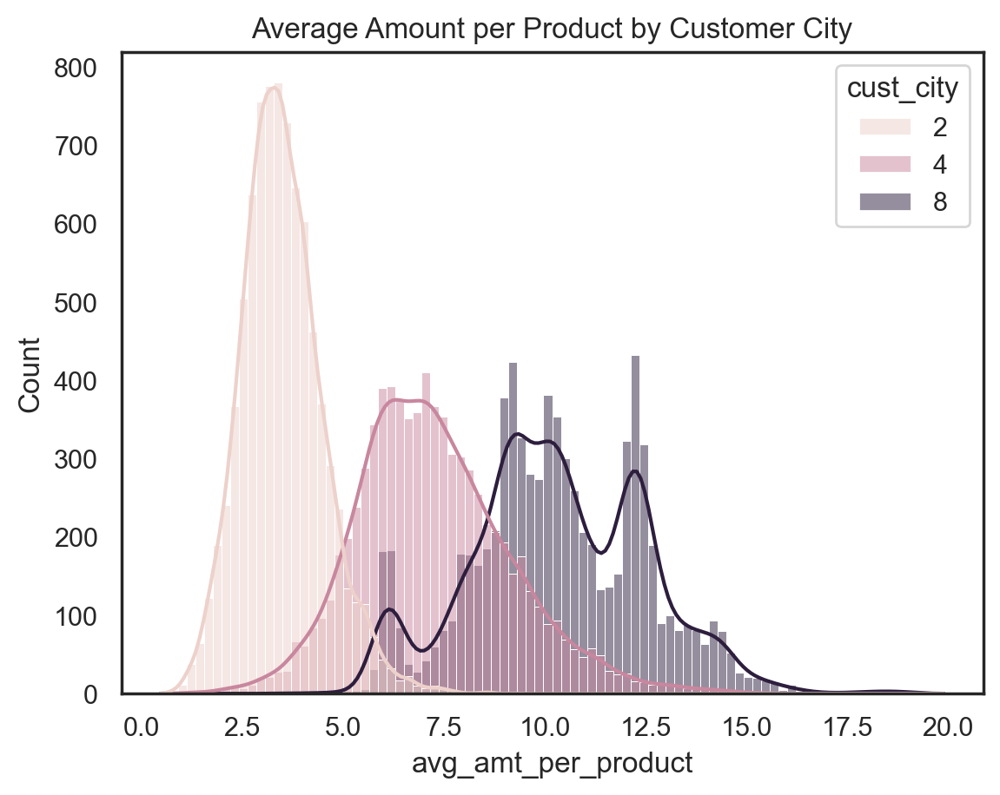

In [86]:
sns.histplot(data=subset_df, 
             x='avg_amt_per_product', 
             bins=90, 
             hue='cust_city', 
             kde=True)

plt.title('Average Amount per Product by Customer City')
plt.show()

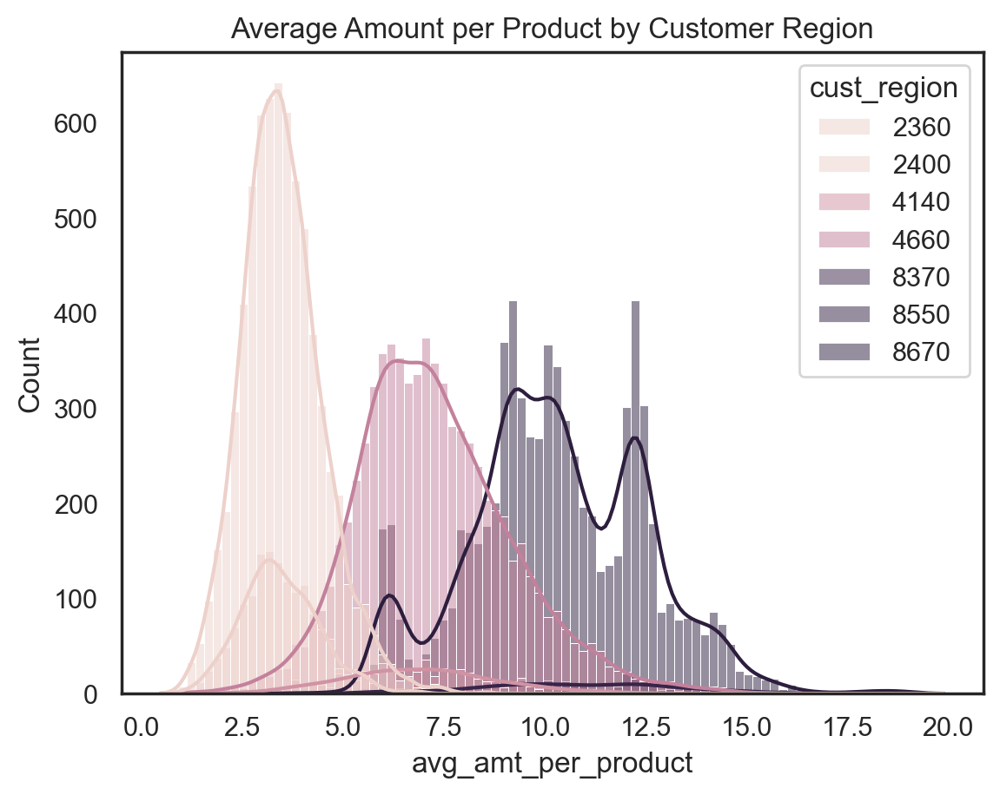

In [87]:
sns.histplot(data=subset_df, 
             x='avg_amt_per_product', 
             bins=90, 
             hue='cust_region', 
             kde=True)

plt.title('Average Amount per Product by Customer Region')
plt.show()

Customer region ends up being an extremely good discriminator of this variable.

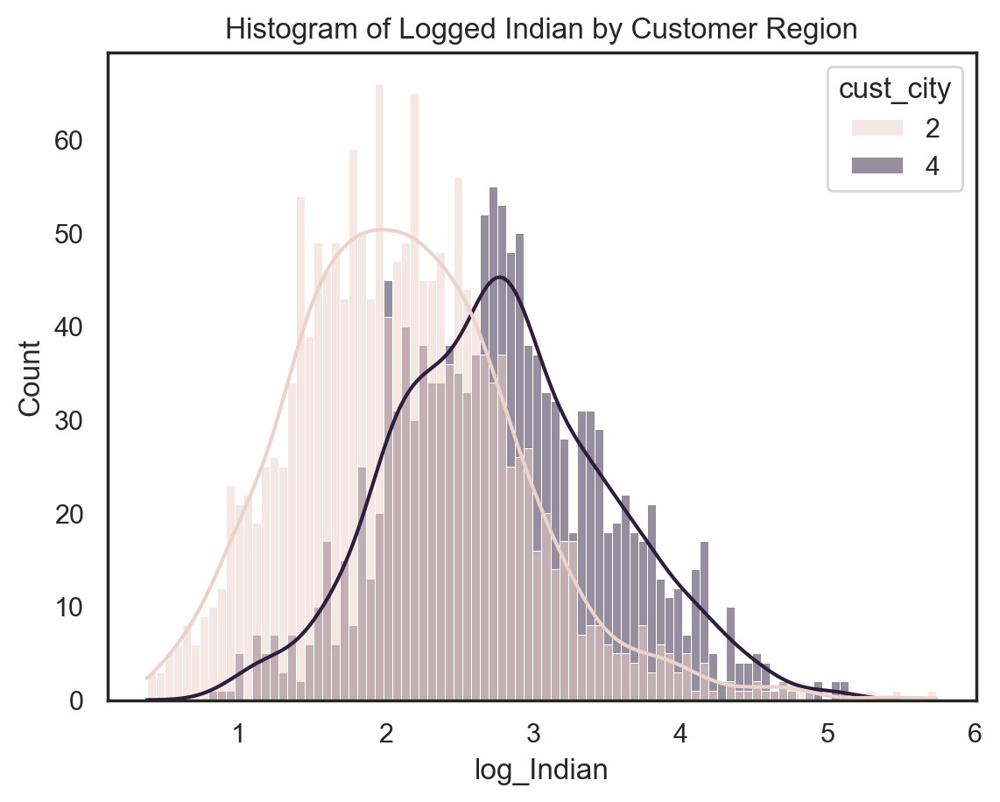

In [88]:
sns.histplot(data=subset_df[subset_df['log_Indian'] > 0], 
             x='log_Indian', 
             bins=90, 
             hue='cust_city', 
             kde=True,
             multiple='layer')

plt.title('Histogram of Logged Indian by Customer Region')
plt.show()

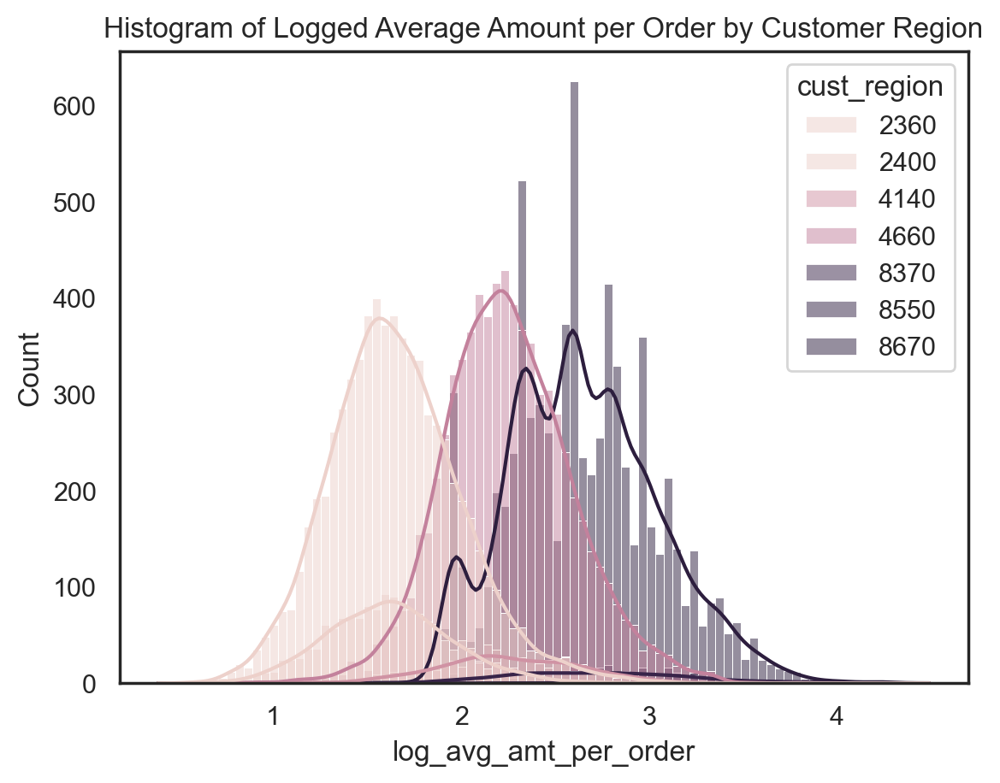

In [89]:
sns.histplot(data=subset_df, 
             x='log_avg_amt_per_order', 
             bins=90,
             hue='cust_region', 
             kde=True)

plt.title('Histogram of Logged Average Amount per Order by Customer Region')
plt.show()

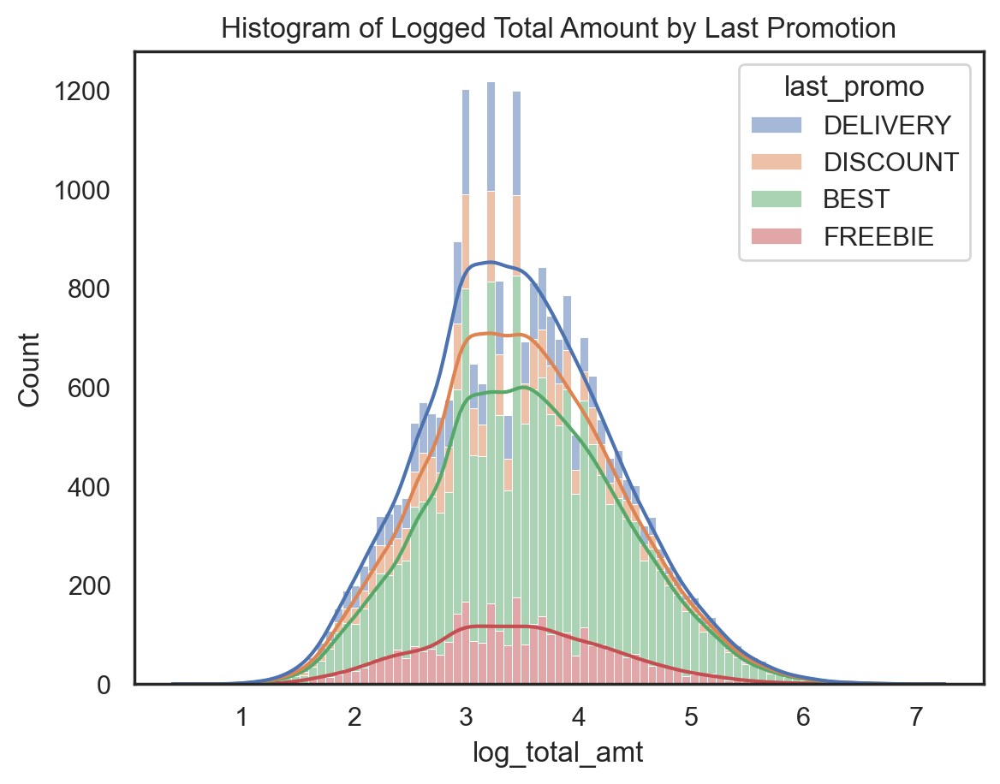

In [90]:
sns.histplot(data=subset_df, 
             x='log_total_amt', 
             bins=91,
             multiple='stack',
             hue='last_promo', 
             kde=True)

plt.title('Histogram of Logged Total Amount by Last Promotion')
plt.show()

## 3.6. Aggregations (again)

And finally it makes sense we feel to check how the average customer has changes when we exclude these differente anomalous values that we have identified.

In [91]:
get_aggregations(subset_df, metric_functions, metric_features)

,sum,mean,std,var,skew,kurt,min,_25,median,_75,_90,_95,_98,max,mode
cust_age,659785.00,27.53,7.16,51.21,1.57,4.20,15.00,23.00,26.00,31.00,37.00,41.00,47.00,80.00,23.00
n_vendor,89218.00,3.72,2.88,8.30,2.98,15.06,1.00,2.00,3.00,4.00,7.00,9.00,12.00,41.00,2.00
n_product,166027.00,6.93,7.46,55.66,5.61,88.87,1.00,3.00,5.00,8.00,14.00,20.00,29.00,269.00,3.00
n_chain,83076.00,3.47,4.31,18.61,4.70,42.89,0.00,1.00,2.00,4.00,8.00,11.00,16.00,83.00,2.00
first_order,554374.00,23.13,20.63,425.79,0.93,0.02,0.00,6.00,18.00,35.00,55.00,65.00,75.00,88.00,0.00
last_order,1650445.00,68.87,19.31,372.72,-1.14,0.59,1.00,59.00,75.00,84.00,88.00,89.00,89.00,90.00,89.00
n_order,128415.00,5.36,5.40,29.21,4.43,34.47,1.00,2.00,4.00,6.00,11.00,15.00,22.00,94.00,2.00
per_chain_order,15207.27,0.63,0.35,0.12,-0.52,-1.03,0.00,0.38,0.67,1.00,1.00,1.00,1.00,1.00,1.00
total_amt,1087457.12,45.38,50.21,2520.83,4.54,48.47,0.47,17.61,30.18,54.98,97.06,134.85,191.83,1418.33,18.08
avg_amt_per_order,220794.04,9.21,6.22,38.74,2.02,8.04,0.47,4.80,7.82,12.01,16.84,21.14,27.03,88.23,5.96


# 4. Correlation Matrices

## 4.1. Metric Features

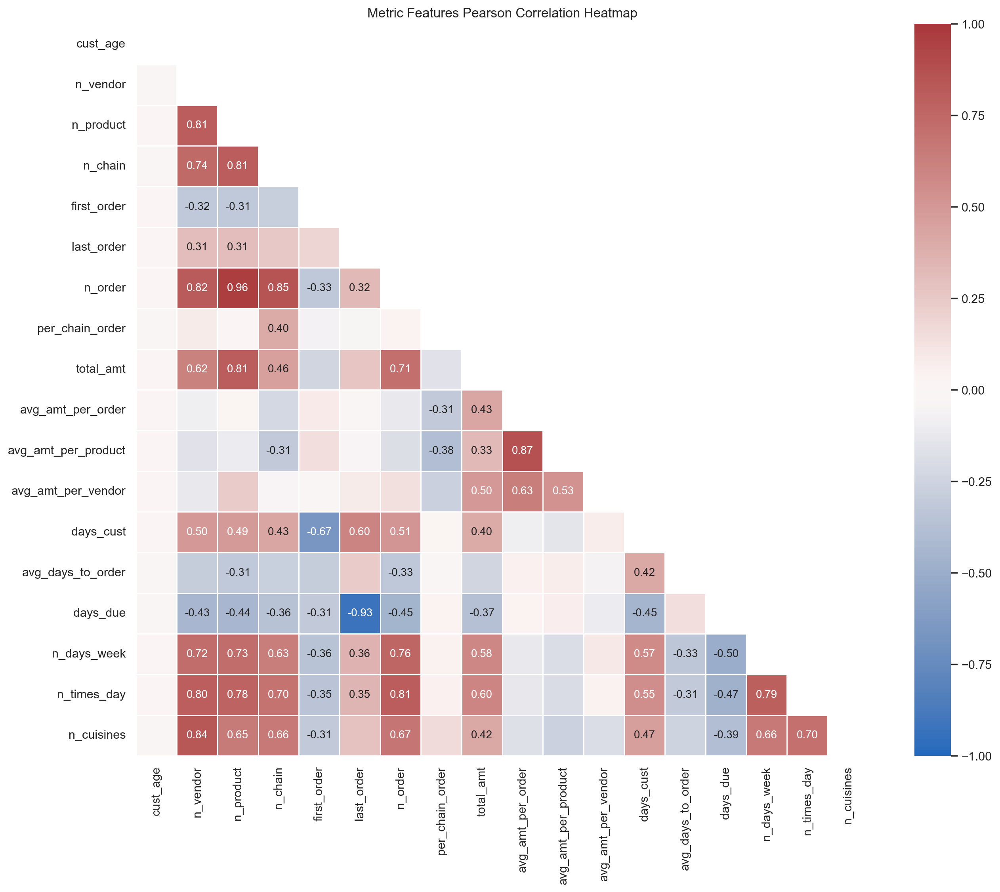

In [92]:
# compute the correlation matrix for the metric features
corr_matrix = subset_df[metric_features].corr(method='pearson')

plt.figure(figsize=(15,12))

# create a mask for the upper triangle
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

annot = np.full(corr_matrix.shape, '', dtype=object)

# Fill the annotation array with formatted values for correlations above the threshold
for i in range(corr_matrix.shape[0]):
    for j in range(corr_matrix.shape[1]):
        if abs(corr_matrix.iat[i, j]) >= 0.3:
            annot[i, j] = f"{corr_matrix.iat[i, j]:.2f}" 

# create the heatmap
sns.heatmap(data=corr_matrix, annot=annot, cmap='vlag', 
            fmt="", center=0, vmin=-1, vmax=1, square=True, 
            linewidths=.5, mask=mask, annot_kws={"size": 10})

# Show the plot
plt.title('Metric Features Pearson Correlation Heatmap')
plt.show()

## 4.2. Day Features

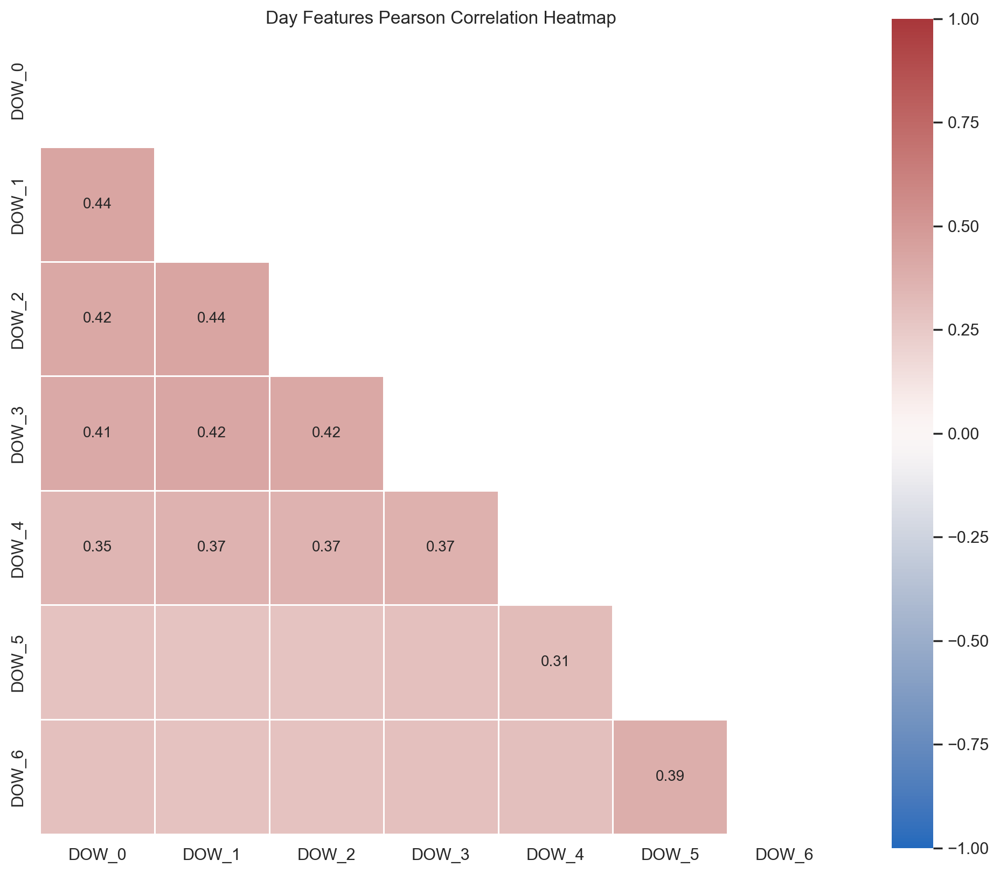

In [93]:
# compute the correlation matrix for the day features
corr_matrix = subset_df[day_features].corr(method='pearson')

plt.figure(figsize=(12,10))

# create a mask for the upper triangle
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

annot = np.full(corr_matrix.shape, '', dtype=object)

# Fill the annotation array with formatted values for correlations above the threshold
for i in range(corr_matrix.shape[0]):
    for j in range(corr_matrix.shape[1]):
        if abs(corr_matrix.iat[i, j]) >= 0.3:
            annot[i, j] = f"{corr_matrix.iat[i, j]:.2f}" 

# create the heatmap
sns.heatmap(data=corr_matrix, annot=annot, cmap='vlag',
            fmt="", center=0, vmin=-1, vmax=1, square=True, 
            linewidths=.5, mask=mask, annot_kws={"size": 10})

# Show the plot
plt.title('Day Features Pearson Correlation Heatmap')
plt.show()

## 4.3. Hour Features

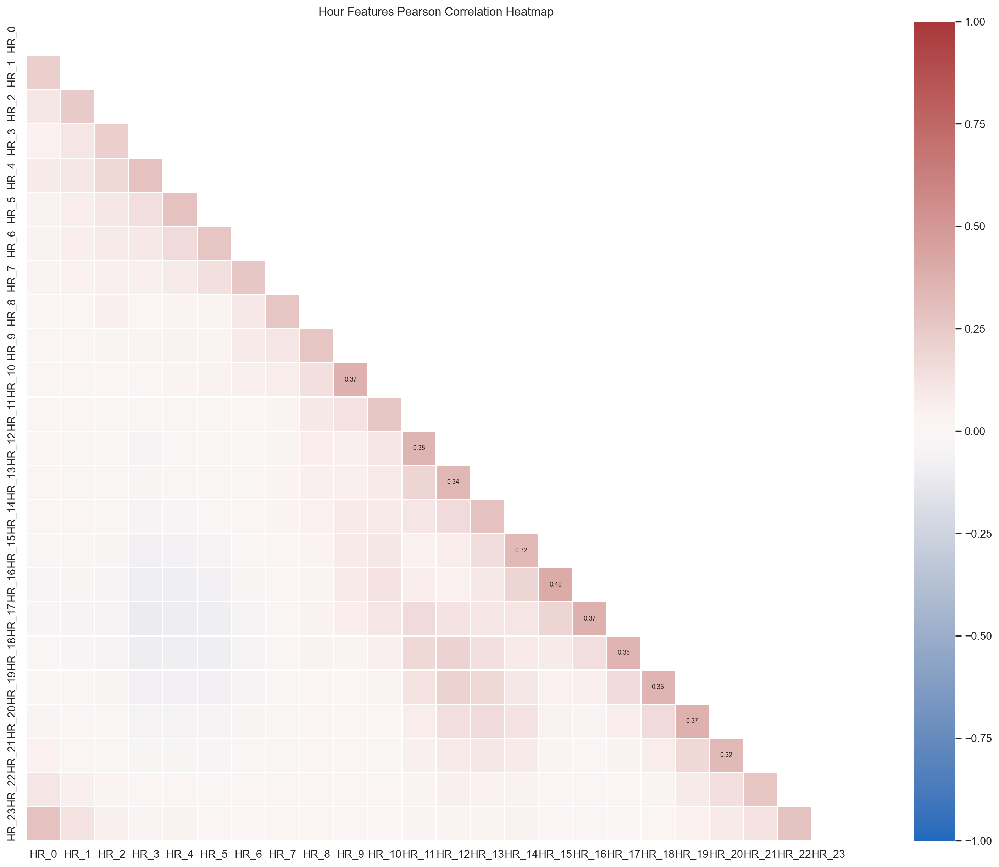

In [94]:
# compute the correlation matrix for the hour features
corr_matrix = subset_df[hour_features].corr(method='pearson')

plt.figure(figsize=(25,15))

# create a mask for the upper triangle
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

annot = np.full(corr_matrix.shape, '', dtype=object)

# Fill the annotation array with formatted values for correlations above the threshold
for i in range(corr_matrix.shape[0]):
    for j in range(corr_matrix.shape[1]):
        if abs(corr_matrix.iat[i, j]) >= 0.3:
            annot[i, j] = f"{corr_matrix.iat[i, j]:.2f}" 

# create the heatmap
sns.heatmap(data=corr_matrix, annot=annot, cmap='vlag',
            fmt="", center=0, vmin=-1, vmax=1, square=True, 
            linewidths=.5, mask=mask, annot_kws={"size": 6.5})

# Show the plot
plt.title('Hour Features Pearson Correlation Heatmap')
plt.show()

## 4.4. Cuisine Features

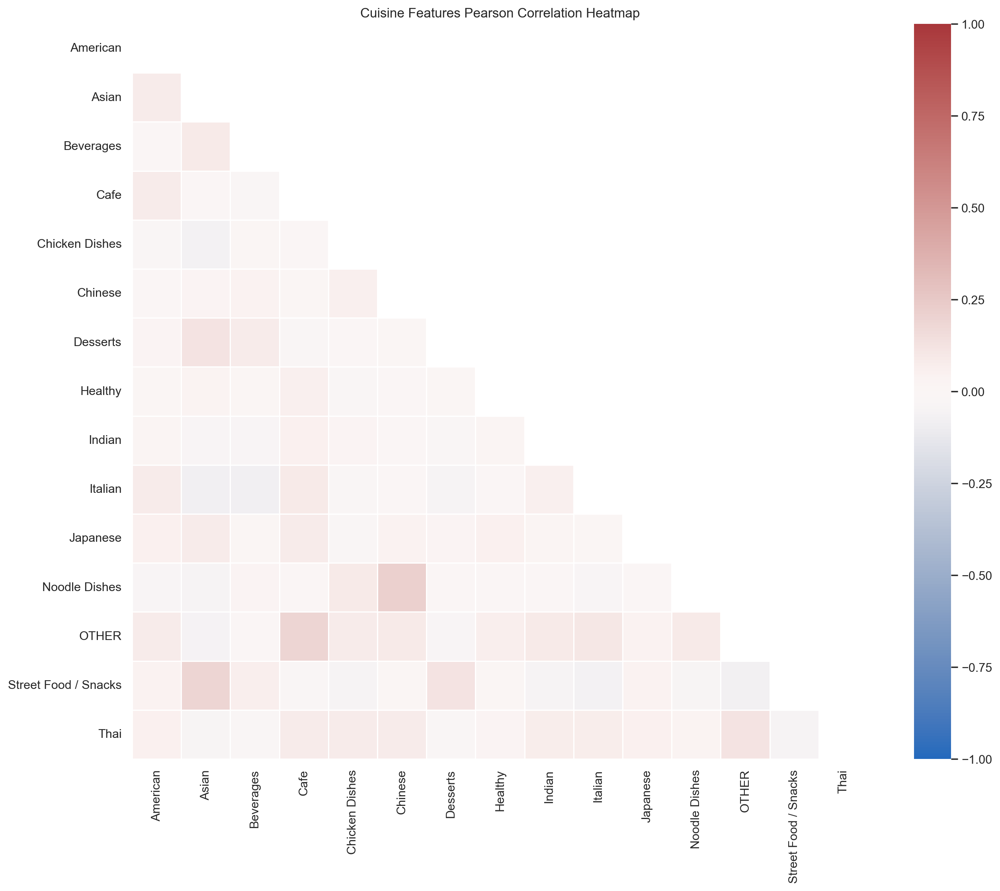

In [95]:
# compute the correlation matrix for the cuisine features
corr_matrix = subset_df[cuisine_features].corr(method='pearson')

plt.figure(figsize=(15,12))

# create a mask for the upper triangle
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

annot = np.full(corr_matrix.shape, '', dtype=object)

# Fill the annotation array with formatted values for correlations above the threshold
for i in range(corr_matrix.shape[0]):
    for j in range(corr_matrix.shape[1]):
        if abs(corr_matrix.iat[i, j]) >= 0.3:
            annot[i, j] = f"{corr_matrix.iat[i, j]:.2f}" 

# create the heatmap
sns.heatmap(data=corr_matrix, annot=annot, cmap='vlag',
            fmt="", center=0, vmin=-1, vmax=1, square=True, 
            linewidths=.5, mask=mask, annot_kws={"size": 10})

# Show the plot
plt.title('Cuisine Features Pearson Correlation Heatmap')
plt.show()

## 4.5. All Features (so far)

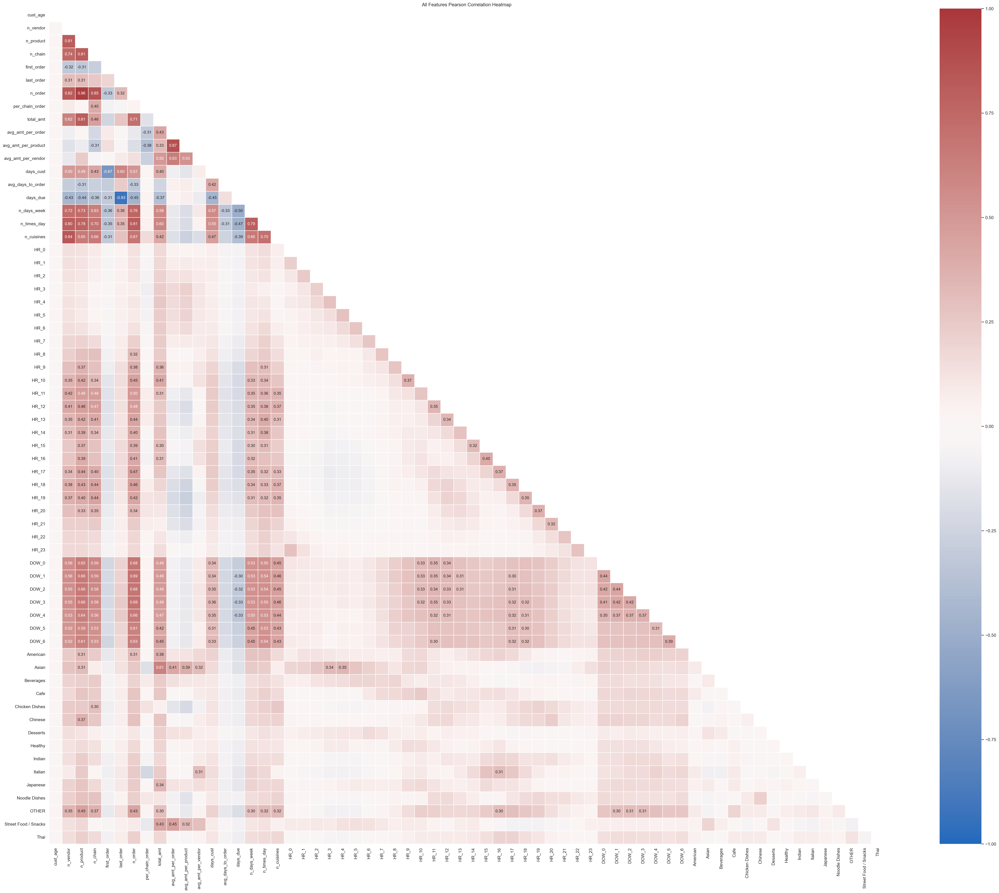

In [96]:
# compute the correlation matrix for all features
corr_matrix = subset_df[metric_features + hour_features + day_features + cuisine_features].corr(method='pearson')

plt.figure(figsize=(50,38))

# create a mask for the upper triangle
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

annot = np.full(corr_matrix.shape, '', dtype=object)

# Fill the annotation array with formatted values for correlations above the threshold
for i in range(corr_matrix.shape[0]):
    for j in range(corr_matrix.shape[1]):
        if abs(corr_matrix.iat[i, j]) >= 0.3:
            annot[i, j] = f"{corr_matrix.iat[i, j]:.2f}" 

# create the heatmap
sns.heatmap(data=corr_matrix, annot=annot, cmap='vlag',
            fmt="", center=0, vmin=-1, vmax=1, square=True, 
            linewidths=.5, mask=mask, annot_kws={"size": 10})

# Show the plot
plt.title('All Features Pearson Correlation Heatmap')
plt.show()

The number of vendors, products and orders made in chained restaurants seem to be fairly correlated among themselves, which could mean that customers that order more products, order them from more distinct vendors and often from chained restaurants.

The total amount spent and the number of orders directly correlate with the number of products, as to be expected since the more products are bought, the more money is spent, and more likely it is for the products to have been bought on different occasions.

First order is inversely correlated with the number of vendors, products, purchases in chained restaurants and orders and the total amount spent - since it is a first order it makes sense that these values would be at their lowest.

The longer a person has been a customer, the more orders tend to be placed and bigger the number of vendors and products. However, the average days between each order is also bigger, which could mean that the customers are not buying as regularly, i.e. this a strong indicator that propensity towards consumption tends to deacelerate with time.

Regarding the hours, we can see two order spikes around lunch and dinner time, with the lunch time spike starting rather early which can indicate the orders of our workers that want to make sure their lunch is delivered in time for their lunch break. In addition, the afternoon hours seem to show autocorrelation between lagged hours, this means that if we know that someone usually buys at a certain time in the afternoon, it is likely they have made purchases at the previous hour - this likelyhood increases with the number of orders.

Regarding the week days, it seems the number of orders has lower correlation with Friday and Saturday and that the days as customers is also less correlated with these two week days - this could mean our customer base tends to order more on the week days.

Regarding the cuisines, the Asian cuisine shows high correlation with the total amount spent by a customer, implying that higher spenders tend to order chinese food; the Chicken dishes seem to be ordered a lot from chain restaurants; the OTHER cuisine gets a lot of orders with a bigger amount of products and from chain restaurants and is mostly consumed during the afternoon.
High spenders mostly spend their money on Asian, Street Food/Snacks, American and Japanese dishes, while the overall product volume is greatest in OTHER, Chinese, American and Asian. The cuisine on which customers tend to spend more money per order is on Street Food/Snacks.
OTHER is highly correlated with 4 days of the week - Monday to Thursday.

To sum up, when looking at cuisines and time, 4 o'clock in the afternoon seems to be a great time to eat some pasta.

Regarding our customer base (i.e., people that have ordered more than once), we conclude we have found our 9 to 5 workers, as the days due inversely correlates with the working days of the week - this means that for those customers for which this correlation holds, we can say that they tend to order more often and below the average days to order threshold for which we would expect the average customer to place a new order.

## 4.6. Non-metric Features

In [97]:
selected = non_metric_features[:-1]

In [98]:
def TestIndependence(df, target_var, alpha=0.05):        
    results = {}

    for col in selected:
        
        if col != target_var:
            contingency_table = pd.crosstab(df[target_var], df[col])
            chi2, p, dof, expected = chi2_contingency(contingency_table)
            results[col] = {
                "Chi-square statistic": chi2
                , "p-value": p
                , "Associated": p < alpha
            }

    results_df = pd.DataFrame(results).T
    
    return results_df

In [99]:
for var in selected:
    print(var)
    display(TestIndependence(subset_df, var))

cust_region


,Chi-square statistic,p-value,Associated
last_promo,292.608204,0.0,True
pay_method,125.579373,0.0,True
cust_city,47928.0,0.0,True


last_promo


,Chi-square statistic,p-value,Associated
cust_region,292.608204,0.0,True
pay_method,128.797661,0.0,True
cust_city,275.995648,0.0,True


pay_method


,Chi-square statistic,p-value,Associated
cust_region,125.579373,0.0,True
last_promo,128.797661,0.0,True
cust_city,120.018745,0.0,True


cust_city


,Chi-square statistic,p-value,Associated
cust_region,47928.0,0.0,True
last_promo,275.995648,0.0,True
pay_method,120.018745,0.0,True


# 5. Multivariate analysis

## 5.1. Three-way ANOVA

### 5.1.1. Average Amount per Product

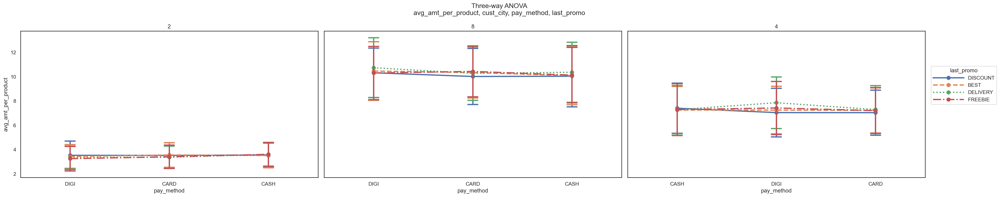

In [100]:
# Defining the variables for the plot
xfeat = 'pay_method'
huefeat='last_promo'
df_viz = subset_df.loc[~subset_df[xfeat].isna()]
cities = df_viz.cust_city.dropna().unique()

fig, axes = plt.subplots(1,len(cities), figsize=(30, 6), tight_layout=True, sharey=True)

# Iterate over the cities
for (axi, city_i) in zip(axes, cities):
    data_ = df_viz.loc[df_viz['cust_city']==city_i]
    
    sns.pointplot(data=data_, 
              y='avg_amt_per_product', 
              x=xfeat, 
              hue=huefeat, 
              errorbar='sd',
              linestyles=["-", "--", ":", "-."],
              capsize=.1,
              ax=axi
              )

    axi.legend([], frameon=False)
    axi.set_title(city_i)

axes[-1].legend(loc=(1.02,.5), title=huefeat, handlelength=6)

fig.suptitle("Three-way ANOVA\navg_amt_per_product, cust_city, pay_method, last_promo")
plt.show()

### 5.1.2. Cuisines

In [101]:
subset_df['above_50pct_chain'] = np.where(subset_df['per_chain_order'] >= 0.5, 1, 0)

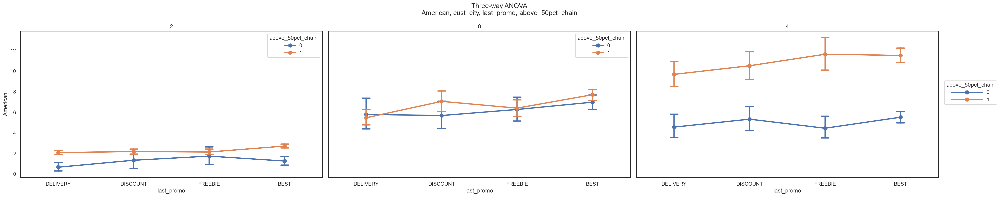

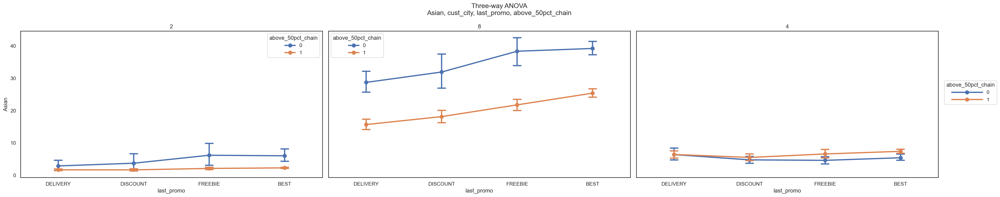

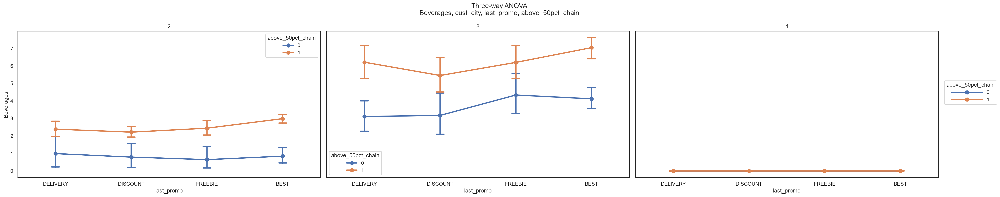

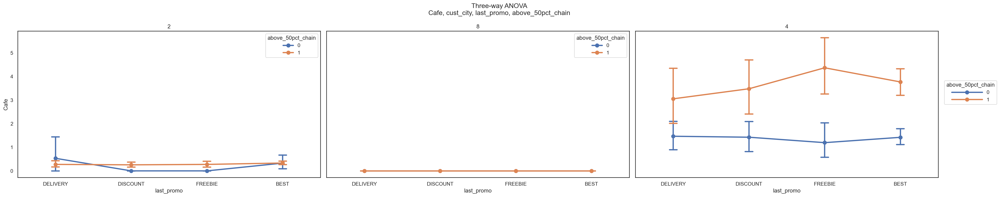

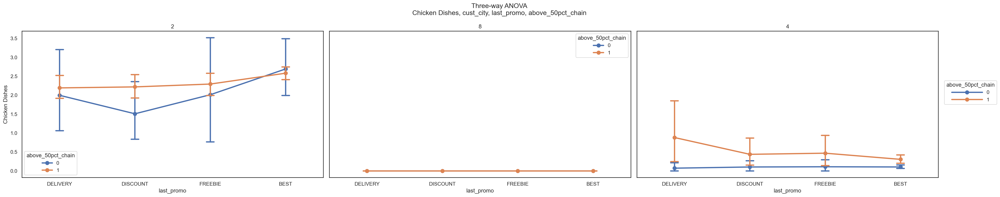

...

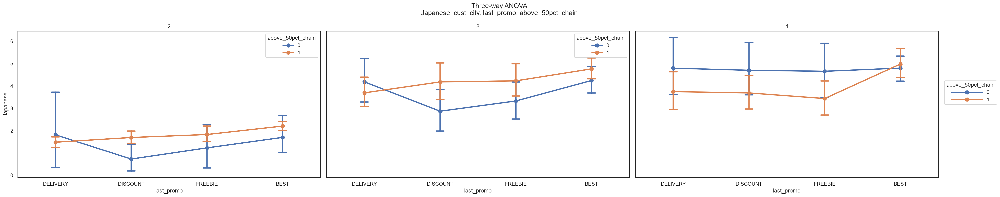

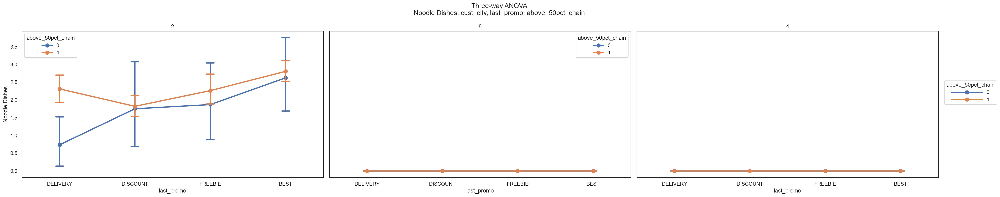

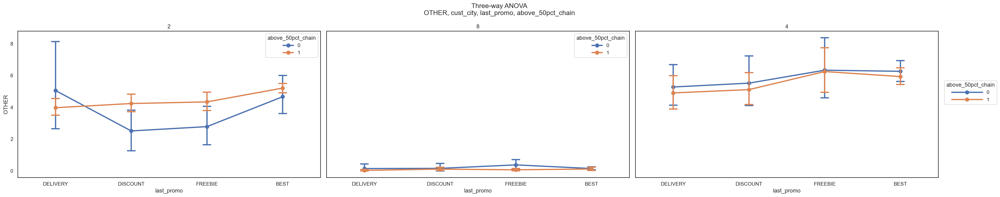

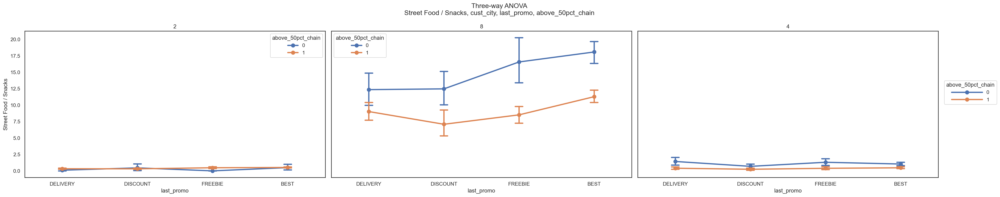

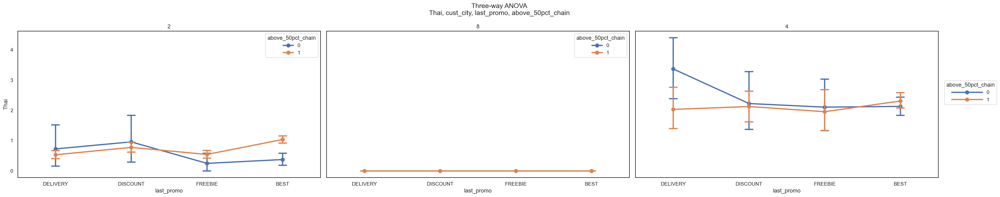

In [102]:
# We filter only those with dependents not missing
for cuisine in cuisine_features:
    xfeat = 'last_promo'
    huefeat='above_50pct_chain'
    df_viz = subset_df.loc[~subset_df[xfeat].isna()]
    cities = df_viz.cust_city.dropna().unique()

    fig, axes = plt.subplots(1,len(cities), figsize=(30, 6), tight_layout=True, sharey=True)

    # Iterate over the cities
    for (axi, city_i) in zip(axes, cities):
        data_ = df_viz.loc[df_viz['cust_city']==city_i]
        
        sns.pointplot(data=data_, 
                y=cuisine, 
                x=xfeat, 
                hue=huefeat, 
                linestyles='-',
                capsize=.1,
                ax=axi,
                order=['DELIVERY', 'DISCOUNT', 'FREEBIE', 'BEST']
                )
        axi.set_title(city_i)

    axes[-1].legend(loc=(1.02,.5), title=huefeat, handlelength=6)

    fig.suptitle(f"Three-way ANOVA\n{cuisine}, cust_city, last_promo, above_50pct_chain")
    plt.show()

## 5.3. Pairplots

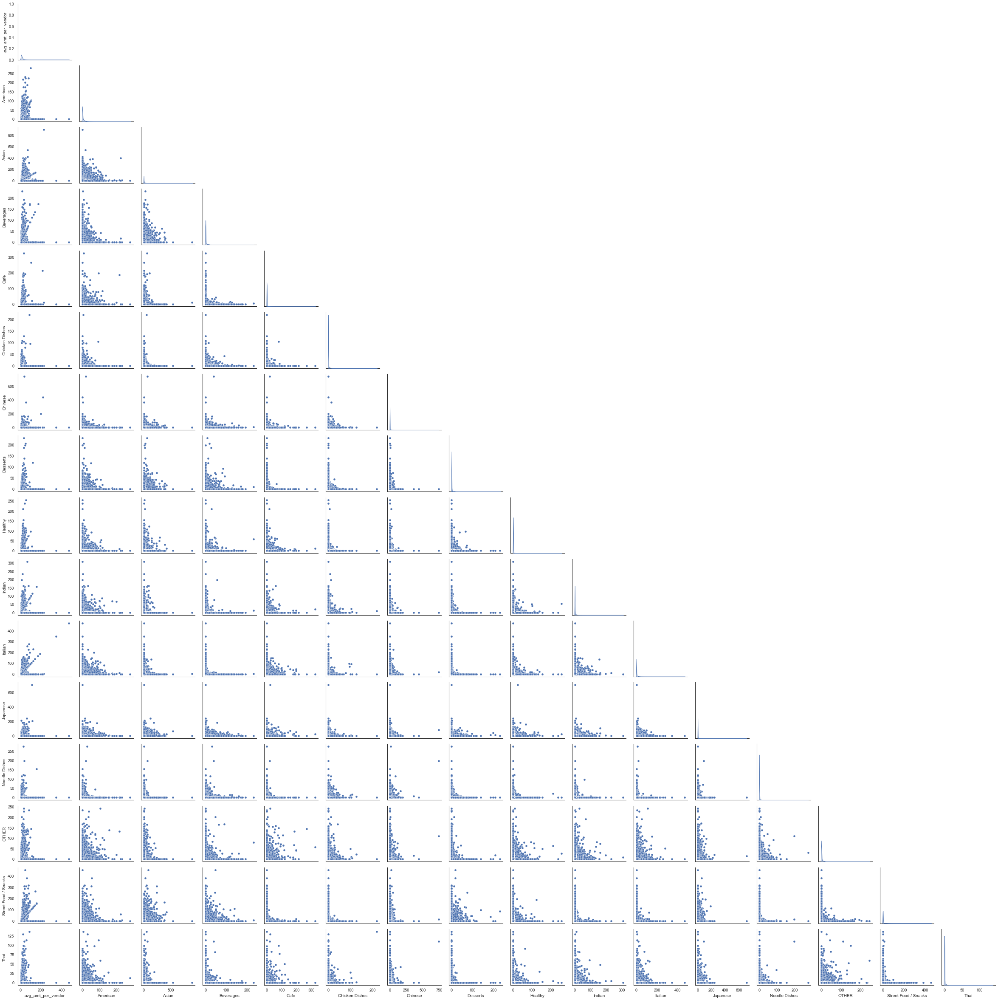

In [103]:
g = sns.PairGrid(data[features])
g.map_lower(sns.scatterplot)  # Plots on the lower part of the triangle
g.map_diag(sns.kdeplot, fill=True)  # Plots on the diagonal

for i in range(len(g.axes)):
   for j in range(len(g.axes)):
       if j > i:  # This identifies the upper triangle
           g.axes[i, j].set_visible(False)  # Hide the axes

g.fig.set_dpi(30)

plt.show()

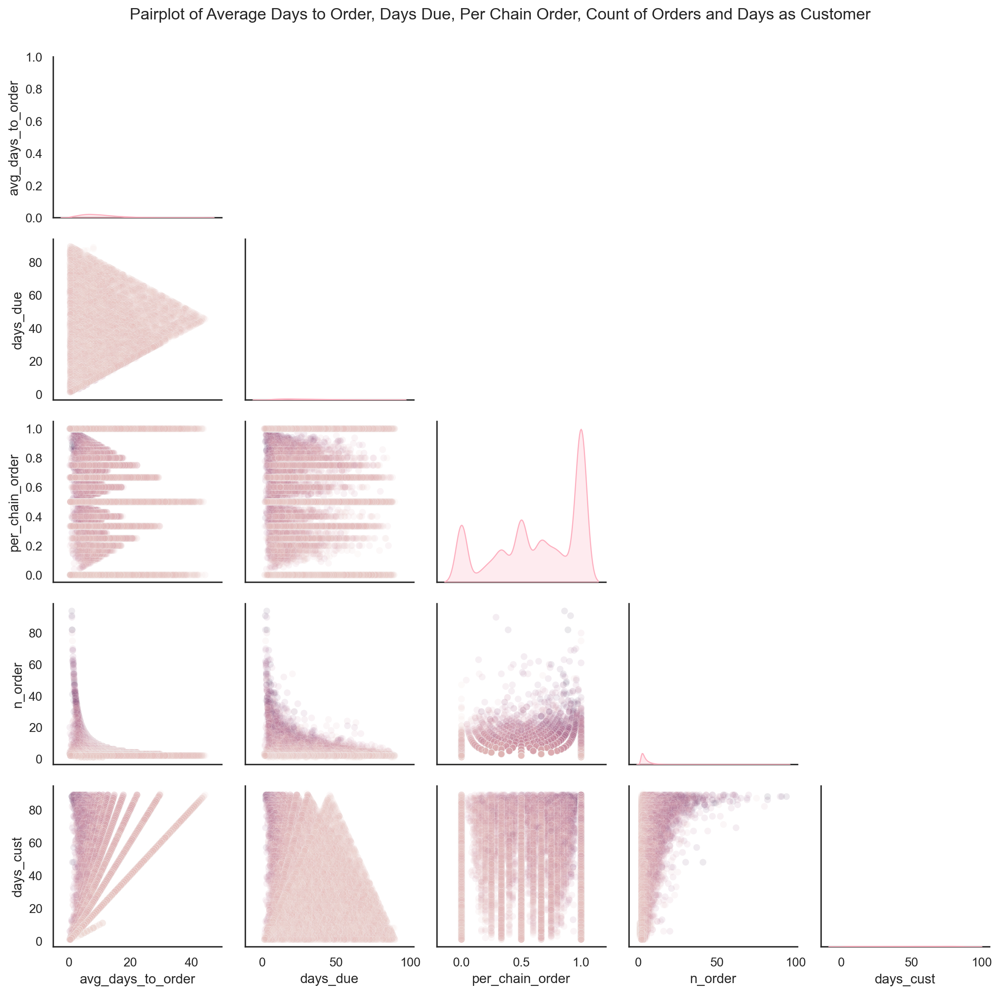

In [104]:
g = sns.PairGrid(subset_df[['avg_days_to_order', 'days_due', 'per_chain_order', 'n_order', 'days_cust']])
g.map_lower(sns.scatterplot, hue=subset_df['n_cuisines'], alpha=0.1)  # Plots on the lower triangle
g.map_diag(sns.kdeplot, fill=True, color='#fdb0c0')  # Plots on the diagonal

for i in range(len(g.axes)):
   for j in range(len(g.axes)):
       if j > i:  # This identifies the upper triangle
           g.axes[i, j].set_visible(False)  # Hide the axes

plt.suptitle('Pairplot of Average Days to Order, Days Due, Per Chain Order, Count of Orders and Days as Customer')
plt.tight_layout(rect=[0, 0, 1, 0.98])

plt.show()

## 5.4. Amounts and Cuisines

In [105]:
def top_n(row, col_list, n):
    # Sort the specified columns in descending order
    sorted_row = row[col_list].sort_values(ascending=False)

    # Get the unique sorted values
    unique_sorted_values = sorted_row.unique()

    # Ensure there are enough unique values to determine the n-th largest
    if len(unique_sorted_values) >= n:
        nth_value = unique_sorted_values[n - 1]  # Get the n-th largest unique value

        # If the n-th value is 0, return None
        if nth_value == 0:
            return None
        
        # If n > 1, check for uniqueness against the (n-1)-th largest
        if n > 1:
            prev_value = unique_sorted_values[n - 2]  # (n-1)-th largest unique value
            # If nth_value is equal to the (n-1)-th value, we don't want to return it
            if nth_value == prev_value:
                return None
        
        # Return the index of the n-th largest value
        return sorted_row[sorted_row == nth_value].index[0]

    # Return None if conditions are not met
    return None

In [106]:
subset_df['top_cuisine'] = subset_df.apply(top_n, col_list=cuisine_features, n=1, axis=1)

In [107]:
subset_df['top2_cuisine'] = subset_df.apply(top_n, col_list=cuisine_features, n=2, axis=1)

In [108]:
subset_df['original_index'] = subset_df.index

subset_df_melted = subset_df.melt(id_vars=['top_cuisine', 'original_index'], 
                                   value_vars=[f'log_{cuisine}' for cuisine in cuisine_features], 
                                   var_name='cuisine', 
                                   value_name='cuisine_total')

In [109]:
subset_df_melted = subset_df_melted[subset_df_melted['top_cuisine'] == subset_df_melted['cuisine'].str[4:]]

In [110]:
subset_df_melted2 = subset_df.melt(id_vars=['top2_cuisine', 'original_index'], 
                                   value_vars=[f'log_{cuisine}' for cuisine in cuisine_features], 
                                   var_name='cuisine2', 
                                   value_name='cuisine2_total')

In [111]:
subset_df_melted2 = subset_df_melted2[subset_df_melted2['top2_cuisine'] == subset_df_melted2['cuisine2'].str[4:]]

In [112]:
result = pd.merge(subset_df_melted, subset_df_melted2, on='original_index', how='left')

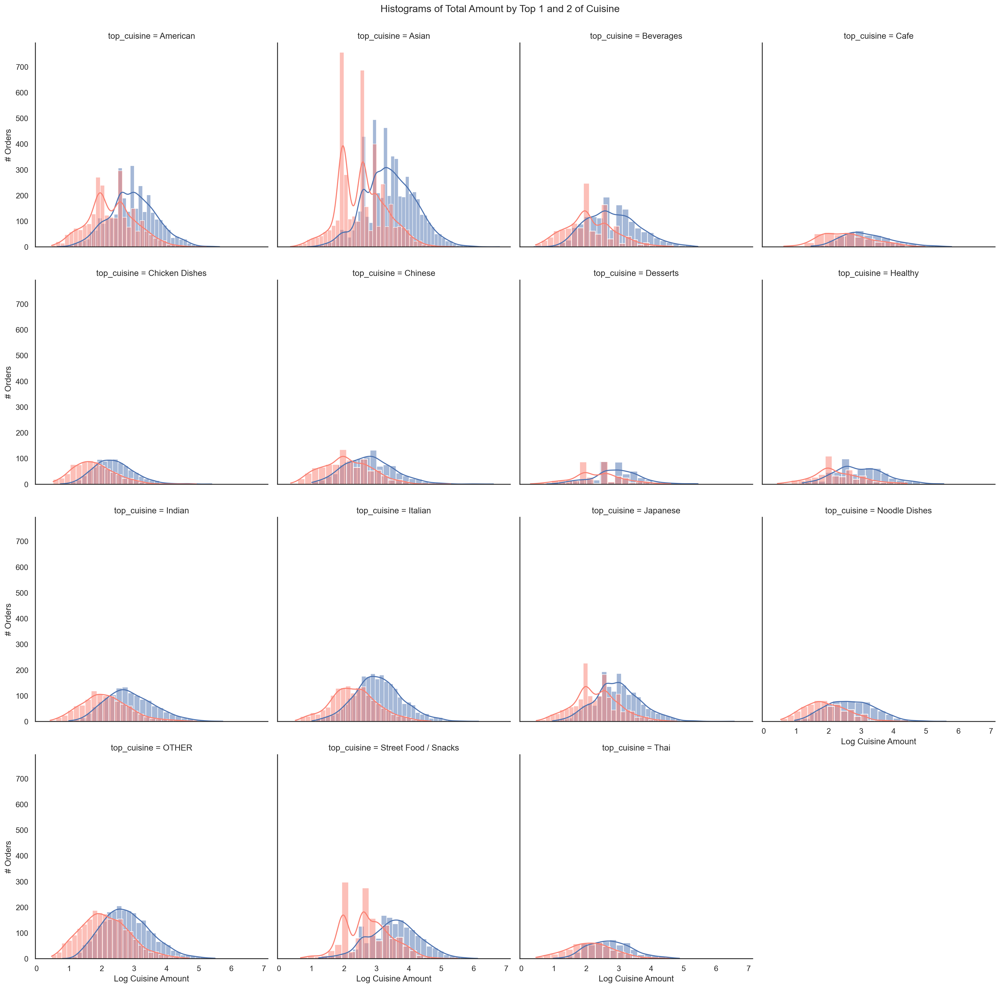

In [113]:
g = sns.FacetGrid(result, col='top_cuisine', col_wrap=4, height=5)

# Map the histograms for 'cuisine_total' and 'cuisine2_total'
g.map(sns.histplot, 'cuisine_total', kde=True)
g.map(sns.histplot, 'cuisine2_total', kde=True, color='salmon')

for ax in g.axes.flatten():  # Flatten the axes array
    ax.set_ylabel('# Orders')
    ax.set_xlabel('Log Cuisine Amount')

# Adjust and add a title
plt.subplots_adjust(top=0.9)
plt.suptitle('Histograms of Total Amount by Top 1 and 2 of Cuisine')
plt.tight_layout(rect=[0, 0, 1, 0.98])

plt.show()

## 5.5. Hour-Week Contingency Analysis

In [114]:
dow_sums = subset_df[[f'DOW_{i}' for i in range(7)]].sum()
hr_sums = subset_df[[f'HR_{i}' for i in range(24)]].sum()

### 5.5.1. Expected Order Count Matrix for Hour-Day Pairs

In [115]:
# Creating new features with the average order count for DOW/HR

subset_df['DOW_total'] = subset_df[[f'DOW_{i}' for i in range(7)]].sum(axis=1)
for i in range(7):
    subset_df[f'Order_DOW_{i}'] = subset_df[f'DOW_{i}'] / subset_df['DOW_total']

subset_df['HR_total'] = subset_df[[f'HR_{i}' for i in range(24)]].sum(axis=1)
for i in range(24):
    subset_df[f'Order_HR_{i}'] = subset_df[f'HR_{i}'] / subset_df['HR_total']

# Dropping auxiliary columns
subset_df.drop(columns=['DOW_total', 'HR_total'], inplace=True)

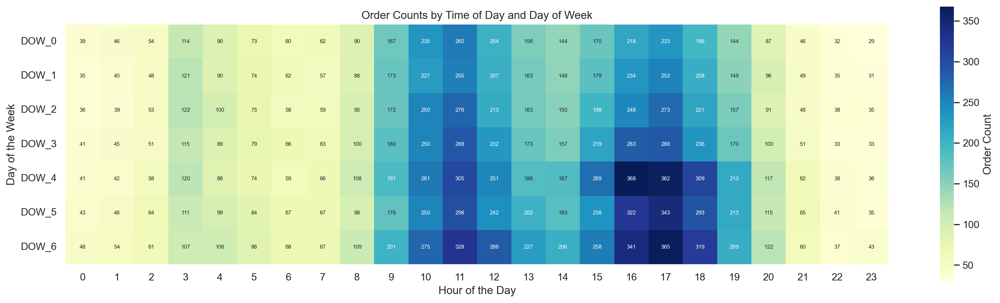

In [116]:
heatmap_data = []

for i in range(7):  # For each day of the week
    for j in range(24):  # For each hour of the day
        # Calculate Order Count as the sum of products of DOW and HR average order counts
        order_count = (subset_df[f'Order_DOW_{i}'] * subset_df[f'Order_HR_{j}']).sum()
        
        heatmap_data.append({
            'Day': f'DOW_{i}',
            'Hour': j,
            'Order_Count': order_count
        })

# Convert heatmap_data into a DataFrame
heatmap_df = pd.DataFrame(heatmap_data)

# Reshape for the heatmap
heatmap_pivot = heatmap_df.pivot(index='Day', columns='Hour', values='Order_Count').fillna(0)

# Plot heatmap
plt.figure(figsize=(20, 12))
sns.heatmap(heatmap_pivot, cmap="YlGnBu", annot=True, fmt=".0f", cbar_kws={'label': 'Order Count', 'orientation': 'vertical', 'shrink': 0.45}, annot_kws={'size': 6}, square=True)
plt.xlabel("Hour of the Day")
plt.ylabel("Day of the Week")
plt.title("Order Counts by Time of Day and Day of Week")

plt.show()

### 5.5.2. Cramer's V Heatmap

In [117]:
# Creating boolean features indicating the placement of orders for a given DOW/HR

for i in range(7):  # For each day of the week
    subset_df[f'Has_DOW_{i}'] = (subset_df[f'DOW_{i}'] > 0).astype(int)

for j in range(24):  # For each hour of the day
    subset_df[f'Has_HR_{j}'] = (subset_df[f'HR_{j}'] > 0).astype(int)

In [118]:
DOW_features = [f'Has_DOW_{i}' for i in range(7)]
HR_features = [f'Has_HR_{i}' for i in range(24)]

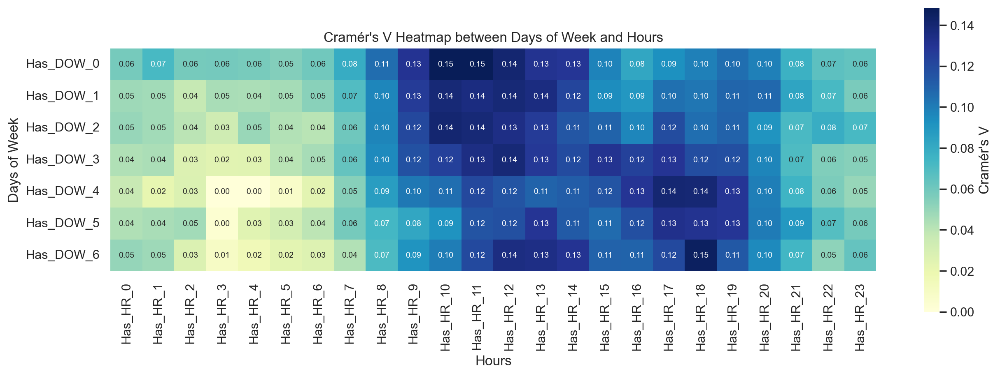

In [119]:
def cramers_v(confusion_matrix):
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    phi2corr = max(0, phi2 - ((k - 1) * (r - 1)) / (n - 1))
    rcorr = r - 1
    kcorr = k - 1
    return np.sqrt(phi2corr / min((kcorr, rcorr)))

# Initialize a DataFrame to store the Cramér's V values
cramer_v_results = pd.DataFrame(index=[f'Has_DOW_{i}' for i in range(7)], columns=[f'Has_HR_{j}' for j in range(24)])

# Calculate Cramér's V for each DOW and HR combination
for i in range(7):
    for j in range(24):
        # Create contingency table
        contingency_table = pd.crosstab(subset_df[f'Has_DOW_{i}'], subset_df[f'Has_HR_{j}'])
        # Calculate Cramér's V
        cramer_v_value = cramers_v(contingency_table)
        cramer_v_results.loc[f'Has_DOW_{i}', f'Has_HR_{j}'] = cramer_v_value

plt.figure(figsize=(15, 12))
sns.heatmap(cramer_v_results.astype(float), annot=True, cmap='YlGnBu', fmt=".2f", annot_kws={'size': 7}, cbar_kws={'label': "Cramér's V", 'orientation': 'vertical', 'shrink': 0.4}, square=True)
plt.title("Cramér's V Heatmap between Days of Week and Hours")
plt.xlabel("Hours")
plt.ylabel("Days of Week")
plt.show()

### 5.5.3. Expectation Weighted Cramer's V Heatmap

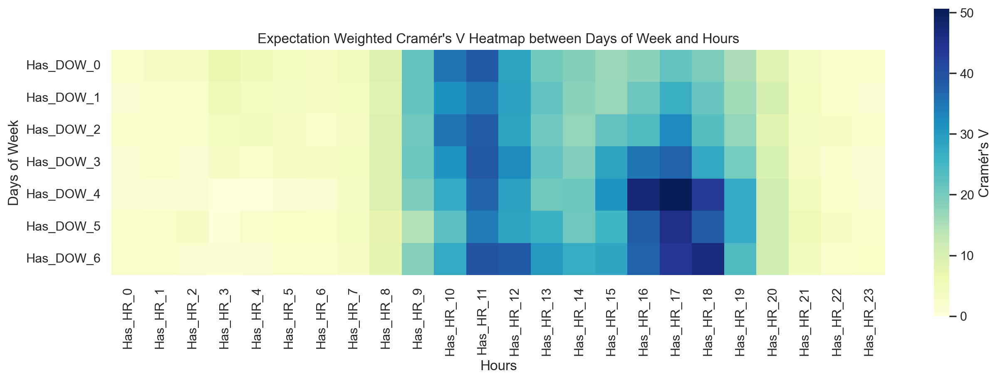

In [120]:
def cramers_v(confusion_matrix):
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    phi2corr = max(0, phi2 - ((k - 1) * (r - 1)) / (n - 1))
    rcorr = r - 1
    kcorr = k - 1
    return np.sqrt(phi2corr / min((kcorr, rcorr)))

# Initialize a DataFrame to store the Cramér's V values
cramer_v_results = pd.DataFrame(index=[f'Has_DOW_{i}' for i in range(7)], columns=[f'Has_HR_{j}' for j in range(24)])

# Calculate Cramér's V for each DOW and HR combination
for i in range(7):
    for j in range(24):
        # Create contingency table
        contingency_table = pd.crosstab(subset_df[f'Has_DOW_{i}'], subset_df[f'Has_HR_{j}'])
        # Calculate Cramér's V
        cramer_v_value = cramers_v(contingency_table)
        # Weight the Cramér's V values with the order count for the DOW/HR combination
        cramer_v_results.loc[f'Has_DOW_{i}', f'Has_HR_{j}'] = cramer_v_value * (subset_df[f'Order_DOW_{i}'] * subset_df[f'Order_HR_{j}']).sum()

plt.figure(figsize=(15, 12))
sns.heatmap(cramer_v_results.astype(float), cmap='YlGnBu', fmt=".2f", annot_kws={'size': 7}, cbar_kws={'label': "Cramér's V", 'orientation': 'vertical', 'shrink': 0.4}, square=True)
plt.title("Expectation Weighted Cramér's V Heatmap between Days of Week and Hours")
plt.xlabel("Hours")
plt.ylabel("Days of Week")
plt.show()

### 5.5.4. (Absolute) Pearson's Correlation Heatmap

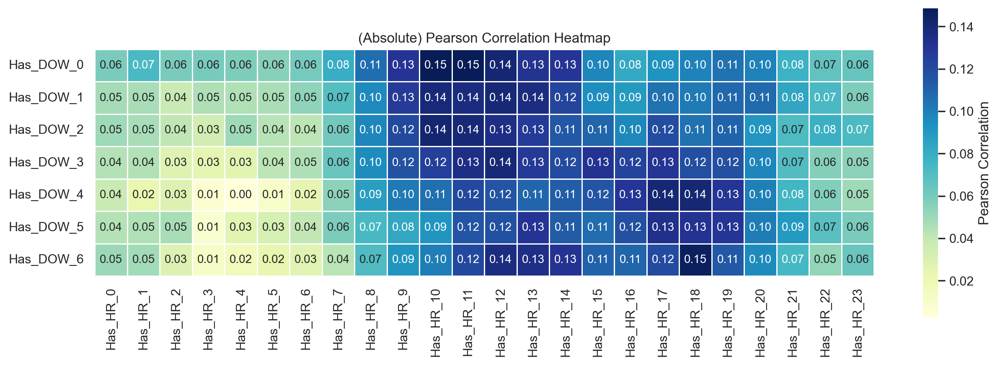

In [121]:
pearson_corr = subset_df[DOW_features + HR_features].corr(method='pearson')

corr_subset = np.abs(pearson_corr.loc[DOW_features, HR_features])

plt.figure(figsize=(15,12))

# Create the heatmap
sns.heatmap(data=corr_subset, annot=True, cmap='YlGnBu', 
            fmt=".2f", square=True, 
            linewidths=.5, annot_kws={"size": 10},
            cbar_kws={'label': "Pearson Correlation", 'orientation': 'vertical', 'shrink': 0.4})

# Show the plot
plt.title('(Absolute) Pearson Correlation Heatmap')
plt.show()

### 5.5.5. Expectation Weighted (Absolute of) Pearson's Correlation Heatmap

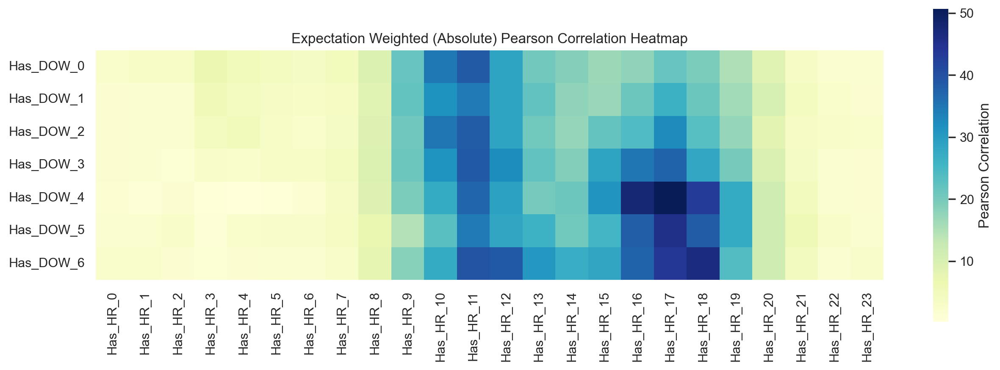

In [122]:
pearson_corr = subset_df[DOW_features + HR_features].corr(method='pearson')

corr_subset = np.abs(pearson_corr.loc[DOW_features, HR_features])

for i in range(7):
    for j in range(24):
        # Weight the correlation values with the order count for DOW/HR combination
        corr_subset.loc[f'Has_DOW_{i}', f'Has_HR_{j}'] = corr_subset.loc[f'Has_DOW_{i}', f'Has_HR_{j}'] * (subset_df[f'Order_DOW_{i}'] * subset_df[f'Order_HR_{j}']).sum()

plt.figure(figsize=(15,12))

# Create the heatmap
sns.heatmap(data=corr_subset, cmap='YlGnBu', 
            fmt="", square=True, cbar_kws={'label': "Pearson Correlation", 'orientation': 'vertical', 'shrink': 0.4}
            )

# Show the plot
plt.title('Expectation Weighted (Absolute) Pearson Correlation Heatmap')
plt.show()

## 5.6. Vendor Count and Customer Age

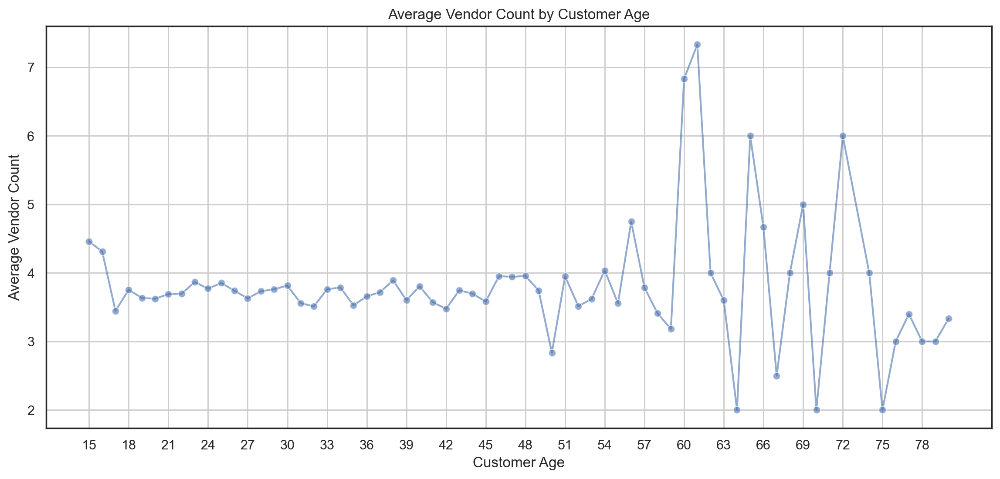

In [123]:
average_vendor_by_age = subset_df.groupby('cust_age')['n_vendor'].mean().reset_index()

# Plotting
plt.figure(figsize=(14, 6))
sns.lineplot(data=average_vendor_by_age, x='cust_age', y='n_vendor', marker='o', alpha=0.6)
plt.title('Average Vendor Count by Customer Age')
plt.xlabel('Customer Age')
plt.ylabel('Average Vendor Count')
plt.xticks(np.arange(average_vendor_by_age['cust_age'].min(), 
                       average_vendor_by_age['cust_age'].max() + 1, 3))
plt.grid(True)
plt.show()

## 5.7. Over Time Analysis

### 5.7.1. Sales Amount Over Time

In [124]:
data['avg_amt_per_day'] = data['total_amt'] / data['days_cust']

In [125]:
days = range(91)  # Days from 0 to 90
daily_avg_amt_sum = np.zeros(91)

In [126]:
# For each customer, add their avg_amt_per_day to the days they were a customer
for _, row in data.iterrows():
    start_day = int(row['first_order'])
    end_day = int(row['last_order'])
    daily_avg_amt_sum[start_day:end_day] += row['avg_amt_per_day']

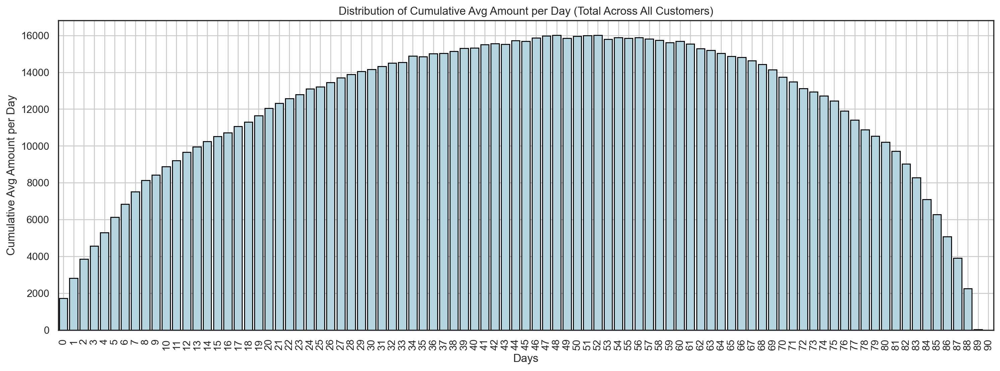

In [127]:
plt.figure(figsize=(18, 6))

# Plotting
sns.barplot(x=days, y=daily_avg_amt_sum, color='lightblue', edgecolor='black')

# Set titles and labels
plt.xlabel("Days")
plt.ylabel("Cumulative Avg Amount per Day")
plt.title("Distribution of Cumulative Avg Amount per Day (Total Across All Customers)")
plt.xticks(rotation=90)
plt.grid(True)

plt.show()

### 5.7.2. Sold Products Over Time

In [128]:
data['avg_product_per_day'] = data['n_product'] / data['days_cust']

In [129]:
days = range(91)  # Days from 0 to 90
daily_avg_product_sum = np.zeros(91)

In [130]:
# For each customer, add their avg_product_per_day to the days they were a customer
for _, row in data.iterrows():
    start_day = int(row['first_order'])
    end_day = int(row['last_order'])
    daily_avg_product_sum[start_day:end_day] += row['avg_product_per_day']

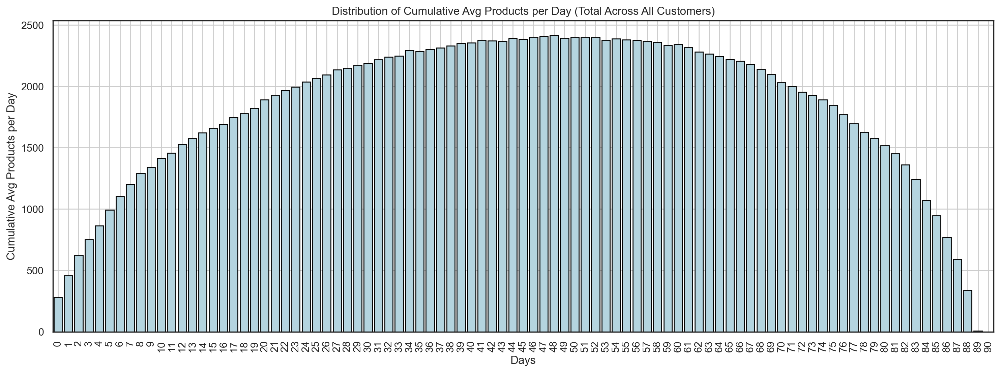

In [131]:
plt.figure(figsize=(18, 6))

# Plotting
sns.barplot(x=days, y=daily_avg_product_sum, color='lightblue', edgecolor='black')

# Set titles and labels
plt.xlabel("Days")
plt.ylabel("Cumulative Avg Products per Day")
plt.title("Distribution of Cumulative Avg Products per Day (Total Across All Customers)")
plt.xticks(rotation=90)
plt.grid(True)

plt.show()

### 5.7.3. Orders Over Time

In [132]:
data['avg_order_per_day'] = data['n_order'] / data['days_cust']

In [133]:
days = range(91)  # Days from 0 to 90
daily_avg_order_sum = np.zeros(91)

In [134]:
# For each customer, add their avg_product_per_day to the days they were a customer
for _, row in data.iterrows():
    start_day = int(row['first_order'])
    end_day = int(row['last_order'])
    daily_avg_order_sum[start_day:end_day] += row['avg_order_per_day']

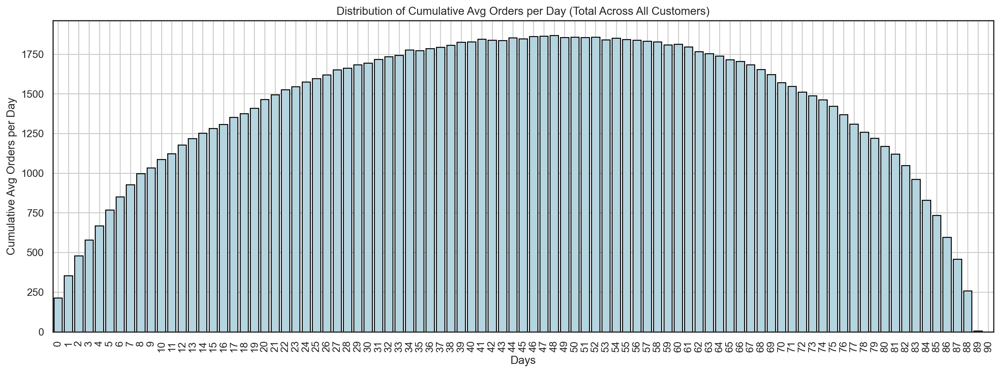

In [135]:
plt.figure(figsize=(18, 6))

# Plotting
sns.barplot(x=days, y=daily_avg_order_sum, color='lightblue', edgecolor='black')

# Set titles and labels
plt.xlabel("Days")
plt.ylabel("Cumulative Avg Orders per Day")
plt.title("Distribution of Cumulative Avg Orders per Day (Total Across All Customers)")
plt.xticks(rotation=90)
plt.grid(True)

plt.show()

### 5.7.4. Realised Customer Lifetime Value

In [136]:
days = range(91)  # Days from 0 to 90
rltv = np.zeros(91)

In [137]:
# For each customer, add their avg_product_per_day to the days they were a customer
for _, row in data.iterrows():
    rltv[int(row['first_order'])] += row['avg_amt_per_order'] * row['n_order'] * (row['days_cust'] / 365)

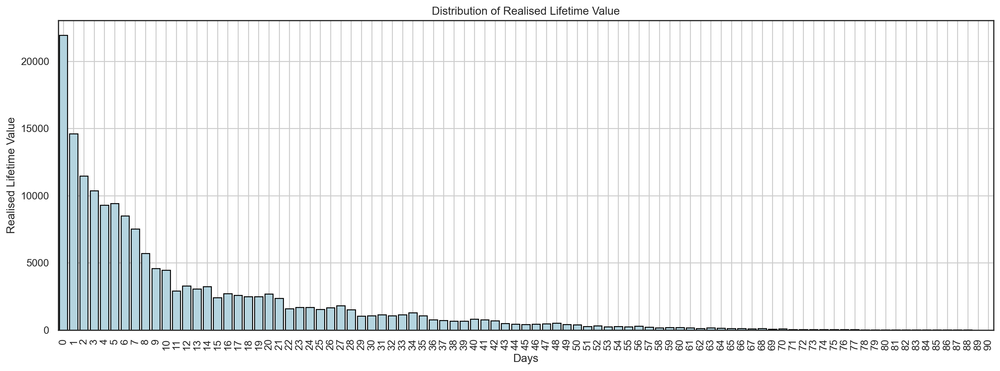

In [138]:
plt.figure(figsize=(18, 6))

# Plotting
sns.barplot(x=days, y=rltv, color='lightblue', edgecolor='black')

# Set titles and labels
plt.xlabel("Days")
plt.ylabel("Realised Lifetime Value")
plt.title("Distribution of Realised Lifetime Value")
plt.xticks(rotation=90)
plt.grid(True)

plt.show()

### 5.7.5. Expected Customer Lifetime Value

#### 5.7.5.1. All Customers

In [139]:
# This is the value the business would expect from a single customer over their relationship
expected_cltv = (
    (data['total_amt'].sum() / data['n_order'].sum()) *  # average purchase value
    (data['n_order'].sum() / data.shape[0]) *  # purchase frequency
    (data['days_cust'].mean() / 365)  # average customer lifespan
)

In [140]:
days = range(91)  # Days from 0 to 90
eltv = np.zeros(91)

In [141]:
# For each customer, calculate their Realised Customer Lifetime Value and subtract the Expected Customer Lifetime Value
for _, row in data.iterrows():
    eltv[int(row['first_order'])] += (row['avg_amt_per_order'] * row['n_order'] * (row['days_cust'] / 365)) - expected_cltv

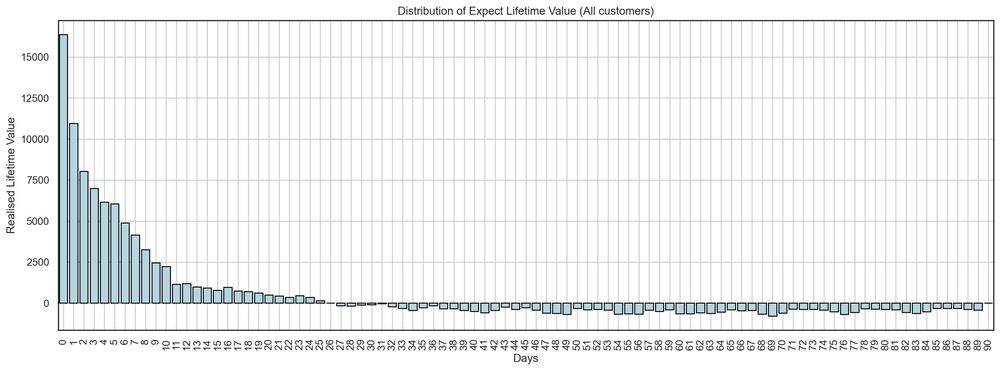

In [142]:
plt.figure(figsize=(18, 6))

# Plotting
sns.barplot(x=days, y=eltv, color='lightblue', edgecolor='black')

# Set titles and labels
plt.xlabel("Days")
plt.ylabel("Realised Lifetime Value")
plt.title("Distribution of Expect Lifetime Value (All customers)")
plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.grid(True)

plt.show()

#### 5.7.5.2. Regular Customers

In [143]:
# This is the value the business would expect from a single *regular* customer over their relationship
expected_cltv = (
    (subset_df['total_amt'].sum() / subset_df['n_order'].sum()) *  # average purchase value
    (subset_df['n_order'].sum() / subset_df.shape[0]) *  # purchase frequency
    (subset_df['days_cust'].mean() / 365)  # average customer lifespan
)

In [144]:
days = range(91)  # Days from 0 to 90
eltv = np.zeros(91)

In [145]:
# For each customer, calculate their Realised Customer Lifetime Value and subtract the Expected Customer Lifetime Value
for _, row in subset_df.iterrows():
    eltv[int(row['first_order'])] += (row['avg_amt_per_order'] * row['n_order'] * (row['days_cust'] / 365)) - expected_cltv

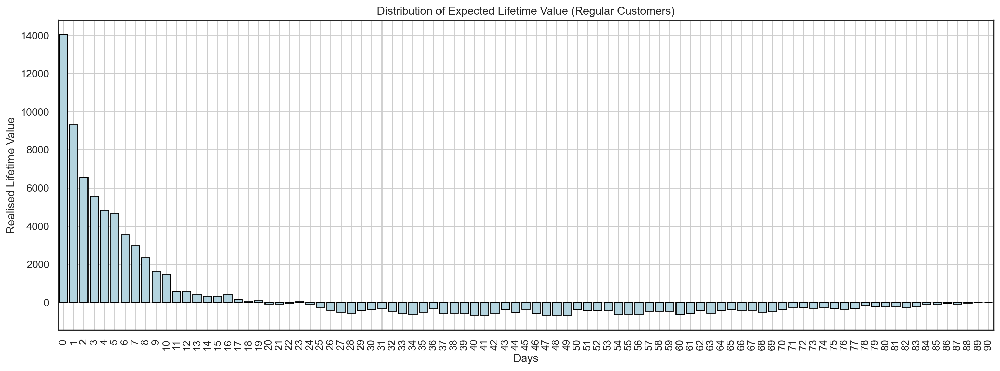

In [146]:
plt.figure(figsize=(18, 6))

# Plotting
sns.barplot(x=days, y=eltv, color='lightblue', edgecolor='black')

# Set titles and labels
plt.xlabel("Days")
plt.ylabel("Realised Lifetime Value")
plt.title("Distribution of Expected Lifetime Value (Regular Customers)")
plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.grid(True)

plt.show()

#### 5.7.5.3. Regular Customers and Foodies

In [147]:
regular_foodie_df = data[
    (data['regular'] == 1) & 
    (~data['loyal_flag']) & 
    (~data['gluttonous_flag']) & 
    (data['foodie_flag'])
].copy(deep=True)

In [148]:
days = range(91)  # Days from 0 to 90
eltv = np.zeros(91)

In [149]:
# For each customer, calculate their Realised Customer Lifetime Value and subtract the Expected Customer Lifetime Value
for _, row in regular_foodie_df.iterrows():
    eltv[int(row['first_order'])] += (row['avg_amt_per_order'] * row['n_order'] * (row['days_cust'] / 365)) - expected_cltv

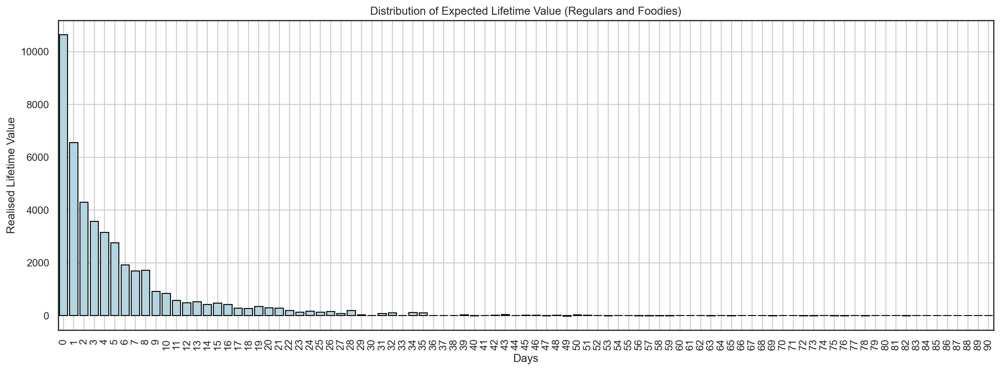

In [150]:
plt.figure(figsize=(18, 6))

# Plotting
sns.barplot(x=days, y=eltv, color='lightblue', edgecolor='black')

# Set titles and labels
plt.xlabel("Days")
plt.ylabel("Realised Lifetime Value")
plt.title("Distribution of Expected Lifetime Value (Regulars and Foodies)")
plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.grid(True)

plt.show()

#### 5.7.5.4. Regular Customers and Foodies, Gluttonous and Loyal Customers

In [151]:
regular_foodie_glut_loyal = data[
    (data['regular'] == 1) & 
    ((data['loyal_flag']) | 
    (data['gluttonous_flag']) | 
    (data['foodie_flag']))
].copy(deep=True)

In [152]:
days = range(91)  # Days from 0 to 90
eltv = np.zeros(91)

In [153]:
# For each customer, calculate their Realised Customer Lifetime Value and subtract the Expected Customer Lifetime Value
for _, row in regular_foodie_glut_loyal.iterrows():
    eltv[int(row['first_order'])] += (row['avg_amt_per_order'] * row['n_order'] * (row['days_cust'] / 365)) - expected_cltv

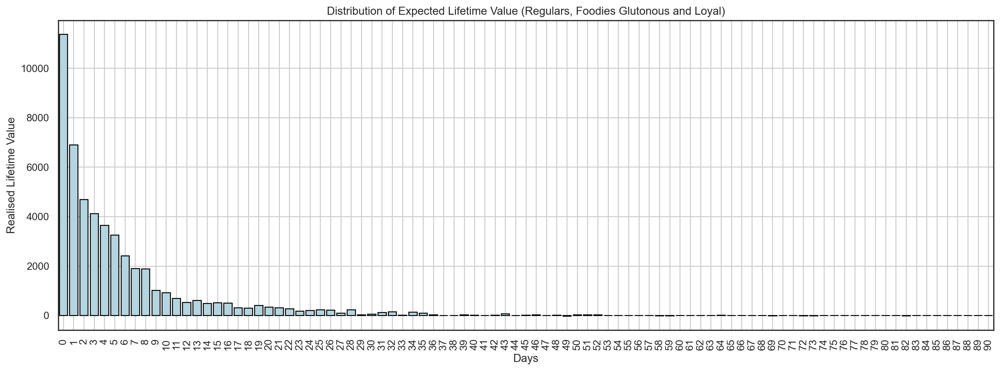

In [154]:
plt.figure(figsize=(18, 6))

# Plotting
sns.barplot(x=days, y=eltv, color='lightblue', edgecolor='black')

# Set titles and labels
plt.xlabel("Days")
plt.ylabel("Realised Lifetime Value")
plt.title("Distribution of Expected Lifetime Value (Regulars, Foodies Glutonous and Loyal)")
plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.grid(True)

plt.show()

#### 5.7.5.5. One-time Customers

In [155]:
one_time_df = data[
    (data['regular'] == 0)
].copy(deep=True)

In [156]:
days = range(91)  # Days from 0 to 90
eltv = np.zeros(91)

In [157]:
# For each customer, calculate their Realised Customer Lifetime Value and subtract the Expected Customer Lifetime Value
for _, row in one_time_df.iterrows():
    eltv[int(row['first_order'])] += (row['avg_amt_per_order'] * row['n_order'] * (row['days_cust'] / 365)) - expected_cltv

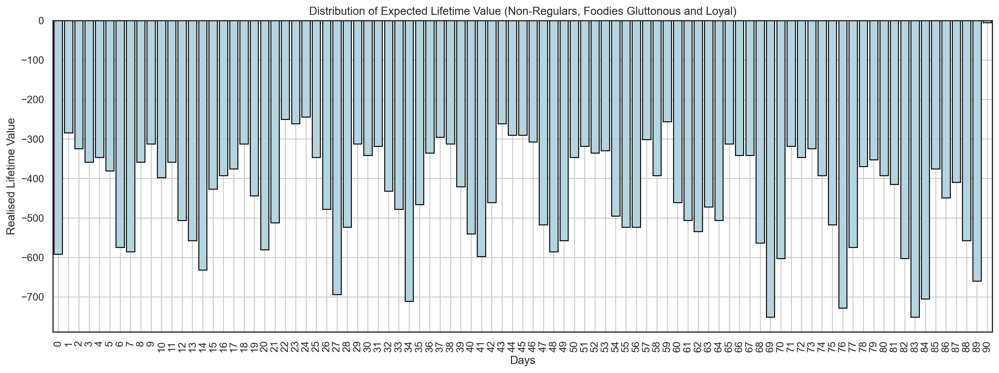

In [158]:
plt.figure(figsize=(18, 6))

# Plotting
sns.barplot(x=days, y=eltv, color='lightblue', edgecolor='black')

# Set titles and labels
plt.xlabel("Days")
plt.ylabel("Realised Lifetime Value")
plt.title("Distribution of Expected Lifetime Value (Non-Regulars, Foodies Gluttonous and Loyal)")
plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.grid(True)

plt.show()

## 5.8. Lorenz Curve of Accumulated Sales with Gradient of Sales Percentiles 

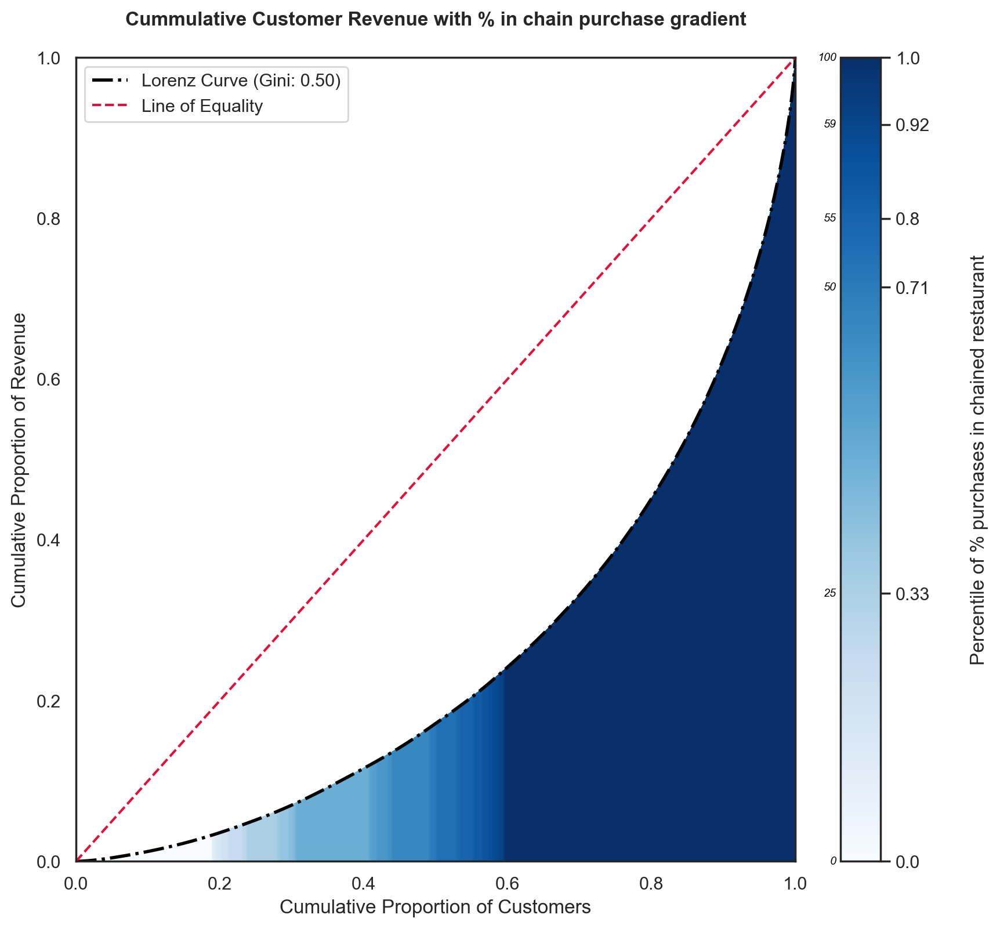

In [159]:
# Set Seaborn style to 'white'
sns.set(style="white")

# Sort the revenue data
revenues = data['total_amt'].sort_values()
pct_chain = data['per_chain_order'].loc[revenues.index]  # Get corresponding values
num_customers = len(revenues)

# Calculate cumulative revenue
cumulative_revenue = revenues.cumsum()

# Calculate total revenue and cumulative revenue proportion
total_revenue = cumulative_revenue.iloc[-1]
cumulative_revenue_proportion = cumulative_revenue / total_revenue

# Calculate cumulative customer proportions
cumulative_customers_proportion = np.arange(1, num_customers + 1) / num_customers

# Prepare the Lorenz curve data
cumulative_customers_proportion = np.insert(cumulative_customers_proportion, 0, 0)  # Add (0, 0) as the start point
cumulative_revenue_proportion = np.insert(cumulative_revenue_proportion, 0, 0)  # Same as above

# Calculate Gini Coefficient
A = np.trapz(cumulative_revenue_proportion, cumulative_customers_proportion)
Gini_coefficient = (0.5 - A) / 0.5  # Normalizing by the area under the line of equality

# Plot the Lorenz Curve with filled area based on 'pct_chain'
plt.figure(figsize=(10, 9))

# Create a colormap for the first Lorenz curve based on pct_chain
cmap = plt.get_cmap('Blues')
colors = cmap(pct_chain.sort_values()) # Get colors based on sorted pct_chain values

# Fill the area under the Lorenz curve using the colors obtained from pct_chain
for i in range(num_customers):
    plt.fill_between(
        cumulative_customers_proportion[i:i + 2]
        , cumulative_revenue_proportion[i:i + 2]
        , color=colors[i]
        , alpha=0.9
    )

# Plotting the Lorenz curve
plt.plot(
    cumulative_customers_proportion
    , cumulative_revenue_proportion
    , color='Black'
    , linestyle='-.'
    , linewidth=2
    , label=f"Lorenz Curve (Gini: {Gini_coefficient:.2f})"
)

# Ensure graph starts at 0 and ends at 1, for both x and y.
plt.xlim(0, 1)
plt.ylim(0, 1)

# Plotting the line of equality
plt.plot(
    [0, 1]
    , [0, 1]
    , color='crimson'
    , linestyle='--',
    label='Line of Equality'
)

# Setting title and labels for graph
plt.title('Cummulative Customer Revenue with % in chain purchase gradient', weight='bold',pad=20)
plt.xlabel('Cumulative Proportion of Customers')
plt.ylabel('Cumulative Proportion of Revenue')
plt.legend(loc='upper left')  # Set a specific location for the legend

# Create a color bar for the pct_chain gradient
norm = plt.Normalize(vmin=pct_chain.min(), vmax=pct_chain.max()) # Create a normalized scale based on pct_chain values
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm) # Map these values to a scalar map

# Create a color bar with extra padding
cbar = plt.colorbar(sm, ax=plt.gca(), orientation='vertical', pad=0.05) 
cbar.set_label('Percentile of % purchases in chained restaurant', labelpad=25)

# Set the ticks at specific data values (min, 25th percentile, etc.)
cbar.ax.set_yticks([
    pct_chain.min(),
    pct_chain.quantile(0.25),
    pct_chain.median(),
    pct_chain.quantile(0.55),
    pct_chain.quantile(0.59),
    pct_chain.max()
])

# Set the corresponding custom labels
cbar.ax.set_yticklabels([
    f"{round(pct_chain.min(), 2)}",
    f"{round(pct_chain.quantile(0.25), 2)}",
    f"{round(pct_chain.median(), 2)}",
    f"{round(pct_chain.quantile(0.55), 2)}",
    f"{round(pct_chain.quantile(0.59), 2)}",
    f"{round(pct_chain.max(), 2)}"
])


quantile_labels = ['0', '25', '50', '55', '59', '100'] # Add quantile labels on the left side of the colorbar
tick_positions = cbar.ax.get_yticks()  # Get the positions of the ticks

for i, label in enumerate(quantile_labels):
    cbar.ax.text(
        -0.1
        , tick_positions[i]
        , label
        , ha='right'
        , va='center'
        , fontstyle='italic'
        , fontsize=7
        , color='black',
        bbox=dict(facecolor='white', alpha=0, edgecolor='none', boxstyle='round,pad=0.5')
    ) # Set text labels on the left side of the gradient

plt.show()



If this Lorenz Curve instead represented income inequality, it would be 13th on the list according to Wikipedia a.k.a the Democratic Republic of the Congo. We point out that almost 80% of total revenue is coming the top 40th percentile of the customer base.

In a flicker of inspiration we decided to plot the gradient of % in chain purchases under the Lorents curve of per customer revenue, which incidentily by the laws of calculus tells us the exact ammount spent on chained restaurants, but more interestingly it shows a clear threshold, at the quantile we had mentioned previously. Note then that, what we are seeing is that the top 40th percentile of customers, which are responsible for those 80% of revenue, order all of their meals from chained restaurants. 

This is too big a finding not to consider studying populations resulting from this rule in isolation. We can deduce that in some way shape or form, the top 40th consumers are those whose routine revolves around a predictable demand for ABCDEats affiliates products, and the other group represent a much less homogenous.

## 5.9. Cumulative Sales

### 5.9.1. As a Function of Customer Age

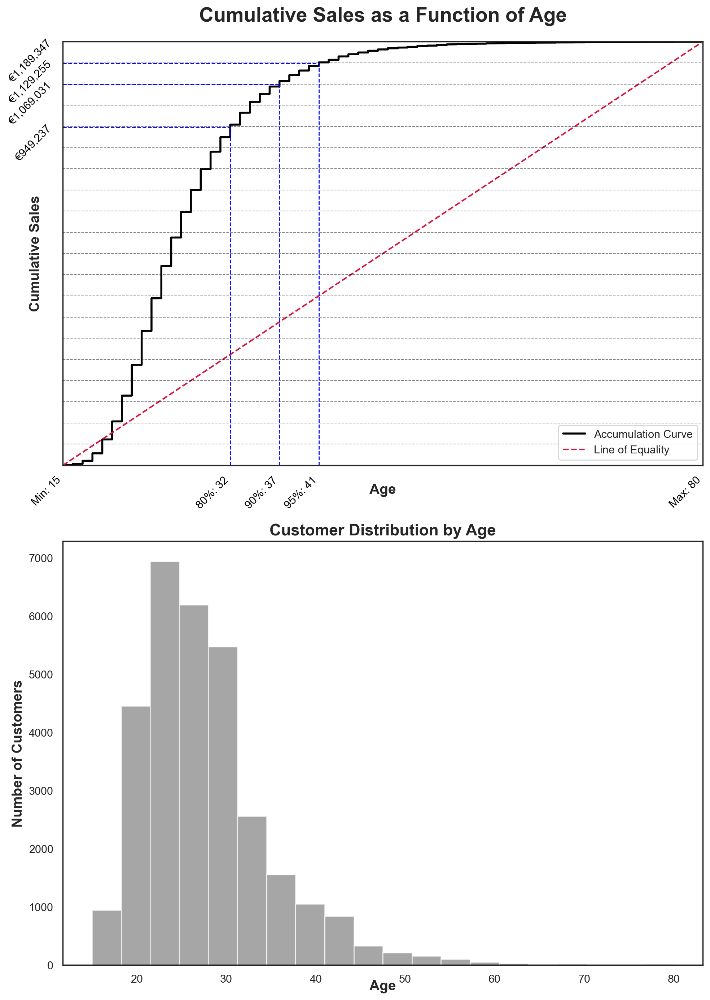

In [160]:
from matplotlib.ticker import FuncFormatter

# Set Seaborn style to 'white'
sns.set(style="white")

# Sort the data by age
sorted_data = data.sort_values('cust_age')
ages = sorted_data['cust_age'].values  # Use age as the primary variable
sales = sorted_data['total_amt'].values  # Corresponding sales based on sorted ages
num_customers = len(sales)

# Calculate cumulative sales
cumulative_sales = sales.cumsum()

# Create a figure with two subplots (one for the cumulative sales curve and one for the customer distribution)
plt.figure(figsize=(10, 14))

# First subplot: Plotting the accumulation curve
plt.subplot(2, 1, 1)  # Two rows, one column, first plot
plt.plot(
    ages,  # x-axis
    cumulative_sales,  # y-axis
    color='Black',
    linestyle='-',
    linewidth=2,
    label='Accumulation Curve'
)

# Plotting the line of equality
plt.plot(
    [ages.min(), ages.max()],  # X values for the line of equality
    [0, cumulative_sales[-1]],  # Y values from 0 to total cumulative sales
    color='crimson',
    linestyle='--',
    label='Line of Equality'
)

# Total sales amount
total_sales = cumulative_sales[-1]  

# Add horizontal lines at every 5% of the total sales
for i in range(1, 21):  # 1 to 20 for 5% increments
    plt.plot([ages.min(), ages.max()], [i * 0.05 * total_sales, i * 0.05 * total_sales], color='black', linestyle='--', linewidth=0.7, alpha=0.5)

# Add vertical lines at 80%, 90%, and 95%
percentiles = [0.80, 0.90, 0.95]
age_percentile_values = []  # List to store age values for percentiles
cumulative_sales_values = []  # List to store cumulative sales values for percentiles

for p in percentiles:
    age_at_percentile = np.percentile(ages, p * 100)  # Get the corresponding age for the percentile
    age_percentile_values.append(age_at_percentile)  # Store the value
    
    # Calculate the y-value for the intersection with the accumulation curve
    sales_at_percentile_index = int(num_customers * p)  # Get index for the current percentile
    y_value = cumulative_sales[sales_at_percentile_index - 1]  # Cumulative sales at this percentile
    
    # Plot vertical line that ends at the intersection point
    plt.plot([age_at_percentile, age_at_percentile], [0, y_value], color='blue', linestyle='--', linewidth=1)
    
    # Plot horizontal line that ends at the intersection point
    plt.plot([ages.min(), age_at_percentile], [y_value, y_value], color='blue', linestyle='--', linewidth=1)

    # Store cumulative sales for this percentile
    cumulative_sales_values.append(y_value)  # Store cumulative sales for this percentile

# Add the total sales (100th percentile) to the cumulative sales values
cumulative_sales_values.append(total_sales)

# Set tick labels for the respective age percentiles on the x-axis
xticks_labels = [
    f'Min: {int(ages.min())}',  # Add min age label
    f'80%: {int(age_percentile_values[0])}',
    f'90%: {int(age_percentile_values[1])}',
    f'95%: {int(age_percentile_values[2])}',
    f'Max: {int(ages.max())}'  # Add max age label
]

plt.xticks(
    [ages.min()] + list(age_percentile_values) + [ages.max()],  # Add min age to ticks
    xticks_labels,
    rotation=45, ha='right', fontsize=11, color='black'  # Rotate and set color for better visibility
)

# Format y-ticks for cumulative sales in Euros
def euro_formatter(x, pos):
    return f'€{int(x):,}'

plt.yticks(cumulative_sales_values, [f'80%: €{int(cumulative_sales_values[0])}', 
                                     f'90%: €{int(cumulative_sales_values[1])}', 
                                     f'95%: €{int(cumulative_sales_values[2])}', 
                                     f'100%: €{int(cumulative_sales_values[3])}'],
           fontsize=11, color='black')  # Set font size and color for y-ticks

plt.gca().yaxis.set_major_formatter(FuncFormatter(euro_formatter))

# Adjust the position and rotation of y-tick labels
for label in plt.gca().get_yticklabels():
    label.set_rotation(45)  # Rotate y-tick labels to 45 degrees
    label.set_y(label.get_position()[1] - 0.02)  # Pad down slightly

# Setting title and labels for the first plot
plt.title('Cumulative Sales as a Function of Age', weight='bold', pad=20, fontsize=20)
plt.xlabel('Age', fontsize=14, fontweight='bold', labelpad=-27)  # Bold x-label with padding
plt.ylabel('Cumulative Sales', fontsize=14, fontweight='bold', labelpad=-35)  # Bold y-label with padding
plt.ylim(0, total_sales)  # Ensure y-axis starts at 0 and ends slightly above max cumulative sales
plt.xlim(min(ages), max(ages))

plt.legend(loc='lower right')  # Set a specific location for the legend to bottom right

# Second subplot: Customer distribution by age
plt.subplot(2, 1, 2)  # Second plot (2 rows, 1 column, second plot)

# Plot histogram to show customer distribution by age
plt.hist(ages, bins=20, color='grey', alpha=0.7)

# Set title and labels for the second plot
plt.title('Customer Distribution by Age', weight='bold', fontsize=16)
plt.xlabel('Age', fontsize=14, fontweight='bold', labelpad=-5)  # Bold x-label with padding
plt.ylabel('Number of Customers', fontsize=14, fontweight='bold')

# Adjust layout to ensure the two plots fit nicely without overlap
plt.tight_layout()

# Show both plots
plt.show()


### 5.9.2. As a Function of Customer Region

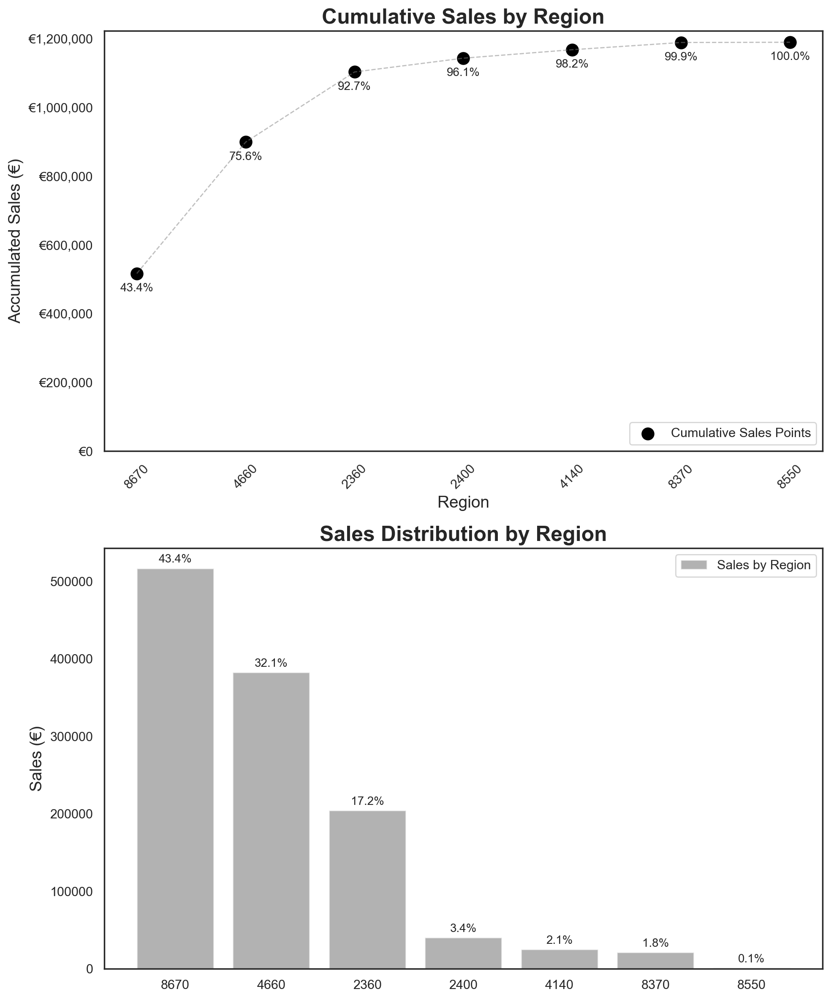

In [161]:
# Set Seaborn style to 'white'
sns.set(style="white")

# Ensure 'cust_region' is treated as an ordered categorical
data['cust_region'] = pd.Categorical(data['cust_region']).as_ordered()

# Group by customer region and sum up sales for each region
grouped_data = data.groupby('cust_region', observed=True)['total_amt'].sum().reset_index()

# Sort the grouped data by total sales (descending order for highest sales first)
sorted_data = grouped_data.sort_values('total_amt', ascending=False)

# Define the order of 'cust_region' based on total sales
sorted_data['cust_region'] = pd.Categorical(
    sorted_data['cust_region'],
    categories=sorted_data['cust_region'],
    ordered=True
)

# Convert 'cust_region' to string for plotting
mapped_region_labels = sorted_data['cust_region'].astype(str).values
region_sales = sorted_data['total_amt'].values

# Cumulative sales
cumulative_sales = region_sales.cumsum()
cumulative_sales = np.insert(cumulative_sales, 0, 0)

# Plotting
plt.figure(figsize=(10, 12))

# Scatter plot with cumulative sales
plt.subplot(2, 1, 1)
plt.scatter(mapped_region_labels, cumulative_sales[1:], color='Black', label='Cumulative Sales Points', s=100)
plt.plot(mapped_region_labels, cumulative_sales[1:], color='gray', linestyle='--', linewidth=1, alpha=0.5)

# Add cumulative percentage annotations
for i, cum_percent in enumerate((cumulative_sales[1:] / cumulative_sales[-1]) * 100):
    plt.annotate(f"{cum_percent:.1f}%", 
                 (mapped_region_labels[i], cumulative_sales[i + 1]), 
                 textcoords="offset points", 
                 xytext=(0, -15), 
                 ha='center', fontsize=10)

plt.title('Cumulative Sales by Region', weight='bold', fontsize=18)
plt.xlabel('Region', fontsize=14)
plt.ylabel('Accumulated Sales (€)', fontsize=14)
plt.xticks(rotation=45)
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'€{x:,.0f}'))
plt.ylim(bottom=0)
plt.legend(loc='lower right')

# Bar plot for region sales
ax2 = plt.subplot(2, 1, 2)
ax2.bar(mapped_region_labels, region_sales, color='grey', alpha=0.6, label='Sales by Region')
ax2.set_ylabel('Sales (€)', fontsize=14)

# Add proportional sales annotations
for i, sale in enumerate(region_sales):
    proportional_sales = (sale / cumulative_sales[-1]) * 100
    ax2.annotate(f"{proportional_sales:.1f}%", 
                 (mapped_region_labels[i], sale), 
                 textcoords="offset points", 
                 xytext=(0, 5),  
                 ha='center', fontsize=10)

ax2.legend(loc='upper right')
plt.title('Sales Distribution by Region', weight='bold', fontsize=18)

# Layout adjustments
plt.subplots_adjust(hspace=0.3)
plt.tight_layout()
plt.show()


### 5.9.3. As a Function of Customer City

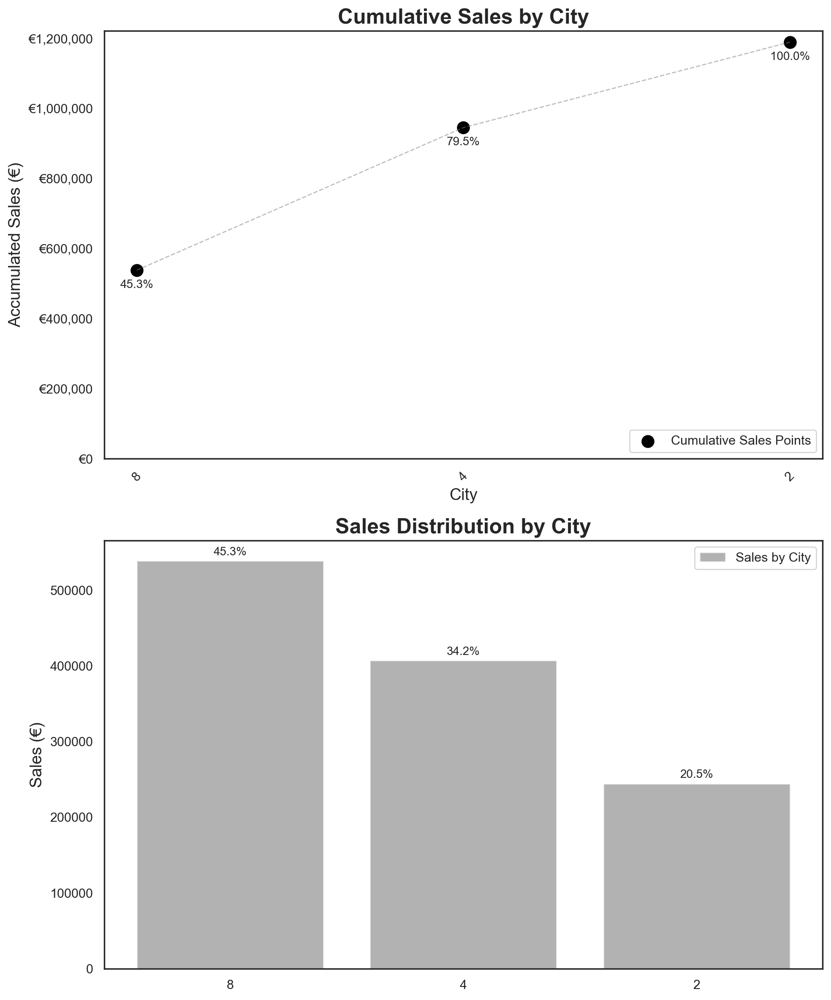

In [162]:
# Set Seaborn style to 'white'
sns.set(style="white")

# Ensure 'cust_city' is treated as an ordered categorical
data['cust_city'] = pd.Categorical(data['cust_city']).as_ordered()

# Group by customer region and sum up sales for each region
grouped_data = data.groupby('cust_city', observed=True)['total_amt'].sum().reset_index()

# Sort the grouped data by total sales (descending order for highest sales first)
sorted_data = grouped_data.sort_values('total_amt', ascending=False)

# Define the order of 'cust_city' based on total sales
sorted_data['cust_city'] = pd.Categorical(
    sorted_data['cust_city'],
    categories=sorted_data['cust_city'],
    ordered=True
)

# Convert 'cust_city' to string for plotting
mapped_city_labels = sorted_data['cust_city'].astype(str).values
city_sales = sorted_data['total_amt'].values

# Cumulative sales
cumulative_sales = city_sales.cumsum()
cumulative_sales = np.insert(cumulative_sales, 0, 0)

# Plotting
plt.figure(figsize=(10, 12))

# Scatter plot with cumulative sales
plt.subplot(2, 1, 1)
plt.scatter(mapped_city_labels, cumulative_sales[1:], color='Black', label='Cumulative Sales Points', s=100)
plt.plot(mapped_city_labels, cumulative_sales[1:], color='gray', linestyle='--', linewidth=1, alpha=0.5)

# Add cumulative percentage annotations
for i, cum_percent in enumerate((cumulative_sales[1:] / cumulative_sales[-1]) * 100):
    plt.annotate(f"{cum_percent:.1f}%", 
                 (mapped_city_labels[i], cumulative_sales[i + 1]), 
                 textcoords="offset points", 
                 xytext=(0, -15), 
                 ha='center', fontsize=10)

plt.title('Cumulative Sales by City', weight='bold', fontsize=18)
plt.xlabel('City', fontsize=14)
plt.ylabel('Accumulated Sales (€)', fontsize=14)
plt.xticks(rotation=45)
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'€{x:,.0f}'))
plt.ylim(bottom=0)
plt.legend(loc='lower right')

# Bar plot for city sales
ax2 = plt.subplot(2, 1, 2)
ax2.bar(mapped_city_labels, city_sales, color='grey', alpha=0.6, label='Sales by City')
ax2.set_ylabel('Sales (€)', fontsize=14)

# Add proportional sales annotations
for i, sale in enumerate(city_sales):
    proportional_sales = (sale / cumulative_sales[-1]) * 100
    ax2.annotate(f"{proportional_sales:.1f}%", 
                 (mapped_city_labels[i], sale), 
                 textcoords="offset points", 
                 xytext=(0, 5),  
                 ha='center', fontsize=10)

ax2.legend(loc='upper right')
plt.title('Sales Distribution by City', weight='bold', fontsize=18)

# Layout adjustments
plt.subplots_adjust(hspace=0.3)
plt.tight_layout()
plt.show()
